# Regularization

Welcome to the second assignment of this week. Deep Learning models have so much flexibility and capacity that **overfitting can be a serious problem**, if the training dataset is not big enough. Sure it does well on the training set, but the learned network **doesn't generalize to new examples** that it has never seen!

**You will learn to:** Use regularization in your deep learning models.

Let's first import the packages you are going to use.

In [2]:
# import packages
import numpy as np
import matplotlib.pyplot as plt
from reg_utils import sigmoid, relu, plot_decision_boundary, initialize_parameters, load_2D_dataset, predict_dec
from reg_utils import compute_cost, predict, forward_propagation, backward_propagation, update_parameters
import sklearn
import sklearn.datasets
import scipy.io
from testCases import *

%matplotlib inline
plt.rcParams['figure.figsize'] = (7.0, 4.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

**Problem Statement**: You have just been hired as an AI expert by the French Football Corporation. They would like you to recommend positions where France's goal keeper should kick the ball so that the French team's players can then hit it with their head. 

<img src="images/field_kiank.png" style="width:600px;height:350px;">
<caption><center> <u> **Figure 1** </u>: **Football field**<br> The goal keeper kicks the ball in the air, the players of each team are fighting to hit the ball with their head </center></caption>


They give you the following 2D dataset from France's past 10 games.

[[ -1.58986000e-01  -3.47926000e-01  -5.04608000e-01  -5.96774000e-01
   -5.18433000e-01  -2.92627000e-01  -1.58986000e-01  -5.76037000e-02
   -7.14286000e-02  -2.97235000e-01  -4.17051000e-01  -4.40092000e-01
   -3.24885000e-01  -2.46544000e-01  -2.18894000e-01  -3.43318000e-01
   -5.09217000e-01  -3.84793000e-01  -1.49770000e-01  -1.95853000e-01
   -3.91705000e-02  -1.08295000e-01  -1.86636000e-01  -2.18894000e-01
   -8.06452000e-02   6.68203000e-02   9.44700000e-02   1.86636000e-01
    6.22120000e-02   2.07373000e-02   2.99539000e-02  -9.90783000e-02
   -6.91244000e-03   1.31336000e-01   2.32719000e-01   8.52535000e-02
   -1.31336000e-01   2.30415000e-03   1.22120000e-01  -3.47926000e-01
   -2.28111000e-01  -7.60369000e-02   4.37788000e-02   1.15207000e-02
   -4.17051000e-01  -3.15668000e-01   1.26728000e-01   2.05069000e-01
    2.18894000e-01   7.14286000e-02  -1.31336000e-01  -2.09677000e-01
   -2.28111000e-01  -1.45161000e-01  -6.68203000e-02   1.35945000e-01
    2.69585000e-01  

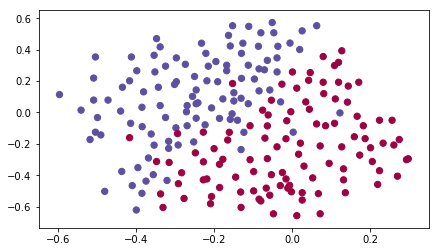

In [8]:
train_X, train_Y, test_X, test_Y = load_2D_dataset()

print(train_X)
print(train_Y)

Each dot corresponds to a position on the football field where a football player has hit the ball with his/her head after the French goal keeper has shot the ball from the left side of the football field.
- If the dot is blue, it means the French player managed to hit the ball with his/her head
- If the dot is red, it means the other team's player hit the ball with their head

**Your goal**: Use a deep learning model to find the positions on the field where the goalkeeper should kick the ball.

**Analysis of the dataset**: This dataset is a little noisy, but it looks like a diagonal line separating the upper left half (blue) from the lower right half (red) would work well. 

You will first try a non-regularized model. Then you'll learn how to regularize it and decide which model you will choose to solve the French Football Corporation's problem. 

## 1 - Non-regularized model

You will use the following neural network (already implemented for you below). This model can be used:
- in *regularization mode* -- by setting the `lambd` input to a non-zero value. We use "`lambd`" instead of "`lambda`" because "`lambda`" is a reserved keyword in Python. 
- in *dropout mode* -- by setting the `keep_prob` to a value less than one

You will first try the model without any regularization. Then, you will implement:
- *L2 regularization* -- functions: "`compute_cost_with_regularization()`" and "`backward_propagation_with_regularization()`"
- *Dropout* -- functions: "`forward_propagation_with_dropout()`" and "`backward_propagation_with_dropout()`"

In each part, you will run this model with the correct inputs so that it calls the functions you've implemented. Take a look at the code below to familiarize yourself with the model.

In [9]:
def model(X, Y, learning_rate = 0.3, num_iterations = 30000, print_cost = True, lambd = 0, keep_prob = 1):
    """
    Implements a three-layer neural network: LINEAR->RELU->LINEAR->RELU->LINEAR->SIGMOID.
    
    Arguments:
    X -- input data, of shape (input size, number of examples)
    Y -- true "label" vector (1 for blue dot / 0 for red dot), of shape (output size, number of examples)
    learning_rate -- learning rate of the optimization
    num_iterations -- number of iterations of the optimization loop
    print_cost -- If True, print the cost every 10000 iterations
    lambd -- regularization hyperparameter, scalar
    keep_prob - probability of keeping a neuron active during drop-out, scalar.
    
    Returns:
    parameters -- parameters learned by the model. They can then be used to predict.
    """
        
    grads = {}
    costs = []                            # to keep track of the cost
    m = X.shape[1]                        # number of examples
    layers_dims = [X.shape[0], 20, 3, 1]
    
    # Initialize parameters dictionary.
    parameters = initialize_parameters(layers_dims)

    # Loop (gradient descent)

    for i in range(0, num_iterations):

        # Forward propagation: LINEAR -> RELU -> LINEAR -> RELU -> LINEAR -> SIGMOID.
        if keep_prob == 1:
            a3, cache = forward_propagation(X, parameters)
        elif keep_prob < 1:
            a3, cache = forward_propagation_with_dropout(X, parameters, keep_prob)
        
        # Cost function
        if lambd == 0:
            cost = compute_cost(a3, Y)
        else:
            cost = compute_cost_with_regularization(a3, Y, parameters, lambd)
            
        # Backward propagation.
        assert(lambd==0 or keep_prob==1)    # it is possible to use both L2 regularization and dropout, 
                                            # but this assignment will only explore one at a time
        if lambd == 0 and keep_prob == 1:
            grads = backward_propagation(X, Y, cache)
        elif lambd != 0:
            grads = backward_propagation_with_regularization(X, Y, cache, lambd)
        elif keep_prob < 1:
            grads = backward_propagation_with_dropout(X, Y, cache, keep_prob)
        
        # Update parameters.
        parameters = update_parameters(parameters, grads, learning_rate)
        
        # Print the loss every 10000 iterations
        if print_cost and i % 10000 == 0:
            print("Cost after iteration {}: {}".format(i, cost))
        if print_cost and i % 1000 == 0:
            costs.append(cost)
    
    # plot the cost
    plt.plot(costs)
    plt.ylabel('cost')
    plt.xlabel('iterations (x1,000)')
    plt.title("Learning rate =" + str(learning_rate))
    plt.show()
    
    return parameters

Let's train the model without any regularization, and observe the accuracy on the train/test sets.

Cost after iteration 0: 0.6557412523481002
Cost after iteration 10000: 0.16329987525724216
Cost after iteration 20000: 0.13851642423255986


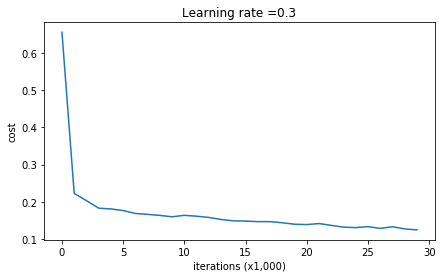

On the training set:
Accuracy: 0.947867298578
On the test set:
Accuracy: 0.915


In [10]:
parameters = model(train_X, train_Y)
print ("On the training set:")
predictions_train = predict(train_X, train_Y, parameters)
print ("On the test set:")
predictions_test = predict(test_X, test_Y, parameters)

The train accuracy is 94.8% while the test accuracy is 91.5%. This is the **baseline model** (you will observe the impact of regularization on this model). Run the following code to plot the decision boundary of your model.

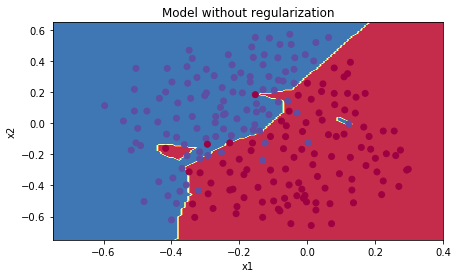

In [11]:
plt.title("Model without regularization")
axes = plt.gca()
axes.set_xlim([-0.75,0.40])
axes.set_ylim([-0.75,0.65])
plot_decision_boundary(lambda x: predict_dec(parameters, x.T), train_X, train_Y)

The non-regularized model is obviously overfitting the training set. It is fitting the noisy points! Lets now look at two techniques to reduce overfitting.

## 2 - L2 Regularization

The standard way to avoid overfitting is called **L2 regularization**. It consists of appropriately modifying your cost function, from:
$$J = -\frac{1}{m} \sum\limits_{i = 1}^{m} \large{(}\small  y^{(i)}\log\left(a^{[L](i)}\right) + (1-y^{(i)})\log\left(1- a^{[L](i)}\right) \large{)} \tag{1}$$
To:
$$J_{regularized} = \small \underbrace{-\frac{1}{m} \sum\limits_{i = 1}^{m} \large{(}\small y^{(i)}\log\left(a^{[L](i)}\right) + (1-y^{(i)})\log\left(1- a^{[L](i)}\right) \large{)} }_\text{cross-entropy cost} + \underbrace{\frac{1}{m} \frac{\lambda}{2} \sum\limits_l\sum\limits_k\sum\limits_j W_{k,j}^{[l]2} }_\text{L2 regularization cost} \tag{2}$$

Let's modify your cost and observe the consequences.

**Exercise**: Implement `compute_cost_with_regularization()` which computes the cost given by formula (2). To calculate $\sum\limits_k\sum\limits_j W_{k,j}^{[l]2}$  , use :
```python
np.sum(np.square(Wl))
```
Note that you have to do this for $W^{[1]}$, $W^{[2]}$ and $W^{[3]}$, then sum the three terms and multiply by $ \frac{1}{m} \frac{\lambda}{2} $.

In [18]:
# GRADED FUNCTION: compute_cost_with_regularization

def compute_cost_with_regularization(A3, Y, parameters, lambd):
    """
    Implement the cost function with L2 regularization. See formula (2) above.
    
    Arguments:
    A3 -- post-activation, output of forward propagation, of shape (output size, number of examples)
    Y -- "true" labels vector, of shape (output size, number of examples)
    parameters -- python dictionary containing parameters of the model
    
    Returns:
    cost - value of the regularized loss function (formula (2))
    """
    m = Y.shape[1]
    W1 = parameters["W1"]
    W2 = parameters["W2"]
    W3 = parameters["W3"]
    
    cross_entropy_cost = compute_cost(A3, Y) # This gives you the cross-entropy part of the cost
    
    ### START CODE HERE ### (approx. 1 line)
    L2_regularization_cost = (1/m)*(lambd/2)*(np.sum(np.square(W1))+np.sum(np.square(W2))+np.sum(np.square(W3)))
    ### END CODER HERE ###
    
    cost = cross_entropy_cost + L2_regularization_cost
    
    return cost

In [19]:
A3, Y_assess, parameters = compute_cost_with_regularization_test_case()

print("cost = " + str(compute_cost_with_regularization(A3, Y_assess, parameters, lambd = 0.1)))

cost = 1.78648594516


**Expected Output**: 

<table> 
    <tr>
    <td>
    **cost**
    </td>
        <td>
    1.78648594516
    </td>
    
    </tr>

</table> 

Of course, because you changed the cost, you have to change backward propagation as well! All the gradients have to be computed with respect to this new cost. 

**Exercise**: Implement the changes needed in backward propagation to take into account regularization. The changes only concern dW1, dW2 and dW3. For each, you have to add the regularization term's gradient ($\frac{d}{dW} ( \frac{1}{2}\frac{\lambda}{m}  W^2) = \frac{\lambda}{m} W$).

In [31]:
# GRADED FUNCTION: backward_propagation_with_regularization

def backward_propagation_with_regularization(X, Y, cache, lambd):
    """
    Implements the backward propagation of our baseline model to which we added an L2 regularization.
    
    Arguments:
    X -- input dataset, of shape (input size, number of examples)
    Y -- "true" labels vector, of shape (output size, number of examples)
    cache -- cache output from forward_propagation()
    lambd -- regularization hyperparameter, scalar
    
    Returns:
    gradients -- A dictionary with the gradients with respect to each parameter, activation and pre-activation variables
    """
    
    m = X.shape[1]
    (Z1, A1, W1, b1, Z2, A2, W2, b2, Z3, A3, W3, b3) = cache
    
    dZ3 = A3 - Y
    
    ### START CODE HERE ### (approx. 1 line)
    dW3 = 1. / m * np.dot(dZ3, A2.T) + (lambd * W3) / m
    ### END CODE HERE ###
    db3 = 1./m * np.sum(dZ3, axis=1, keepdims = True)
    
    dA2 = np.dot(W3.T, dZ3)
    dZ2 = np.multiply(dA2, np.int64(A2 > 0))
    ### START CODE HERE ### (approx. 1 line)
    np.shape(1./m * np.dot(dZ2, A1.T) )
    dW2 = 1./m * np.dot(dZ2, A1.T) + (lambd * W3) / m
    ### END CODE HERE ###
    db2 = 1./m * np.sum(dZ2, axis=1, keepdims = True)
    
    dA1 = np.dot(W2.T, dZ2)
    dZ1 = np.multiply(dA1, np.int64(A1 > 0))
    ### START CODE HERE ### (approx. 1 line)
    dW1 = 1./m * np.dot(dZ1, X.T) + (lambd * W3) / m
    ### END CODE HERE ###
    db1 = 1./m * np.sum(dZ1, axis=1, keepdims = True)
    
    gradients = {"dZ3": dZ3, "dW3": dW3, "db3": db3,"dA2": dA2,
                 "dZ2": dZ2, "dW2": dW2, "db2": db2, "dA1": dA1, 
                 "dZ1": dZ1, "dW1": dW1, "db1": db1}
    
    return gradients

In [32]:
X_assess, Y_assess, cache = backward_propagation_with_regularization_test_case()

grads = backward_propagation_with_regularization(X_assess, Y_assess, cache, lambd = 0.7)
print ("dW1 = "+ str(grads["dW1"]))
print ("dW2 = "+ str(grads["dW2"]))
print ("dW3 = "+ str(grads["dW3"]))

ValueError: operands could not be broadcast together with shapes (3,2) (1,3) 

**Expected Output**:

<table> 
    <tr>
    <td>
    **dW1**
    </td>
        <td>
    [[-0.25604646  0.12298827 -0.28297129]
 [-0.17706303  0.34536094 -0.4410571 ]]
    </td>
    </tr>
    <tr>
    <td>
    **dW2**
    </td>
        <td>
    [[ 0.79276486  0.85133918]
 [-0.0957219  -0.01720463]
 [-0.13100772 -0.03750433]]
    </td>
    </tr>
    <tr>
    <td>
    **dW3**
    </td>
        <td>
    [[-1.77691347 -0.11832879 -0.09397446]]
    </td>
    </tr>
</table> 

Let's now run the model with L2 regularization $(\lambda = 0.7)$. The `model()` function will call: 
- `compute_cost_with_regularization` instead of `compute_cost`
- `backward_propagation_with_regularization` instead of `backward_propagation`

In [ ]:
parameters = model(train_X, train_Y, lambd = 0.7)
print ("On the train set:")
predictions_train = predict(train_X, train_Y, parameters)
print ("On the test set:")
predictions_test = predict(test_X, test_Y, parameters)

Congrats, the test set accuracy increased to 93%. You have saved the French football team!

You are not overfitting the training data anymore. Let's plot the decision boundary.

In [ ]:
plt.title("Model with L2-regularization")
axes = plt.gca()
axes.set_xlim([-0.75,0.40])
axes.set_ylim([-0.75,0.65])
plot_decision_boundary(lambda x: predict_dec(parameters, x.T), train_X, train_Y)

**Observations**:
- The value of $\lambda$ is a hyperparameter that you can tune using a dev set.
- L2 regularization makes your decision boundary smoother. If $\lambda$ is too large, it is also possible to "oversmooth", resulting in a model with high bias.

**What is L2-regularization actually doing?**:

L2-regularization relies on the assumption that a model with small weights is simpler than a model with large weights. Thus, by penalizing the square values of the weights in the cost function you drive all the weights to smaller values. It becomes too costly for the cost to have large weights! This leads to a smoother model in which the output changes more slowly as the input changes. 

<font color='blue'>
**What you should remember** -- the implications of L2-regularization on:
- The cost computation:
    - A regularization term is added to the cost
- The backpropagation function:
    - There are extra terms in the gradients with respect to weight matrices
- Weights end up smaller ("weight decay"): 
    - Weights are pushed to smaller values.

## 3 - Dropout

Finally, **dropout** is a widely used regularization technique that is specific to deep learning. 
**It randomly shuts down some neurons in each iteration.** Watch these two videos to see what this means!

<!--
To understand drop-out, consider this conversation with a friend:
- Friend: "Why do you need all these neurons to train your network and classify images?". 
- You: "Because each neuron contains a weight and can learn specific features/details/shape of an image. The more neurons I have, the more featurse my model learns!"
- Friend: "I see, but are you sure that your neurons are learning different features and not all the same features?"
- You: "Good point... Neurons in the same layer actually don't talk to each other. It should be definitly possible that they learn the same image features/shapes/forms/details... which would be redundant. There should be a solution."
!--> 


<center>
<video width="620" height="440" src="images/dropout1_kiank.mp4" type="video/mp4" controls>
</video>
</center>
<br>
<caption><center> <u> Figure 2 </u>: Drop-out on the second hidden layer. <br> At each iteration, you shut down (= set to zero) each neuron of a layer with probability $1 - keep\_prob$ or keep it with probability $keep\_prob$ (50% here). The dropped neurons don't contribute to the training in both the forward and backward propagations of the iteration. </center></caption>

<center>
<video width="620" height="440" src="images/dropout2_kiank.mp4" type="video/mp4" controls>
</video>
</center>

<caption><center> <u> Figure 3 </u>: Drop-out on the first and third hidden layers. <br> $1^{st}$ layer: we shut down on average 40% of the neurons.  $3^{rd}$ layer: we shut down on average 20% of the neurons. </center></caption>


When you shut some neurons down, you actually modify your model. The idea behind drop-out is that at each iteration, you train a different model that uses only a subset of your neurons. With dropout, your neurons thus become less sensitive to the activation of one other specific neuron, because that other neuron might be shut down at any time. 

### 3.1 - Forward propagation with dropout

**Exercise**: Implement the forward propagation with dropout. You are using a 3 layer neural network, and will add dropout to the first and second hidden layers. We will not apply dropout to the input layer or output layer. 

**Instructions**:
You would like to shut down some neurons in the first and second layers. To do that, you are going to carry out 4 Steps:
1. In lecture, we dicussed creating a variable $d^{[1]}$ with the same shape as $a^{[1]}$ using `np.random.rand()` to randomly get numbers between 0 and 1. Here, you will use a vectorized implementation, so create a random matrix $D^{[1]} = [d^{[1](1)} d^{[1](2)} ... d^{[1](m)}] $ of the same dimension as $A^{[1]}$.
2. Set each entry of $D^{[1]}$ to be 0 with probability (`1-keep_prob`) or 1 with probability (`keep_prob`), by thresholding values in $D^{[1]}$ appropriately. Hint: to set all the entries of a matrix X to 0 (if entry is less than 0.5) or 1 (if entry is more than 0.5) you would do: `X = (X < 0.5)`. Note that 0 and 1 are respectively equivalent to False and True.
3. Set $A^{[1]}$ to $A^{[1]} * D^{[1]}$. (You are shutting down some neurons). You can think of $D^{[1]}$ as a mask, so that when it is multiplied with another matrix, it shuts down some of the values.
4. Divide $A^{[1]}$ by `keep_prob`. By doing this you are assuring that the result of the cost will still have the same expected value as without drop-out. (This technique is also called inverted dropout.)

In [37]:
# GRADED FUNCTION: forward_propagation_with_dropout

def forward_propagation_with_dropout(X, parameters, keep_prob = 0.5):
    """
    Implements the forward propagation: LINEAR -> RELU + DROPOUT -> LINEAR -> RELU + DROPOUT -> LINEAR -> SIGMOID.
    
    Arguments:
    X -- input dataset, of shape (2, number of examples)
    parameters -- python dictionary containing your parameters "W1", "b1", "W2", "b2", "W3", "b3":
                    W1 -- weight matrix of shape (20, 2)
                    b1 -- bias vector of shape (20, 1)
                    W2 -- weight matrix of shape (3, 20)
                    b2 -- bias vector of shape (3, 1)
                    W3 -- weight matrix of shape (1, 3)
                    b3 -- bias vector of shape (1, 1)
    keep_prob - probability of keeping a neuron active during drop-out, scalar
    
    Returns:
    A3 -- last activation value, output of the forward propagation, of shape (1,1)
    cache -- tuple, information stored for computing the backward propagation
    """
    
    np.random.seed(1)
    
    # retrieve parameters
    W1 = parameters["W1"]
    b1 = parameters["b1"]
    W2 = parameters["W2"]
    b2 = parameters["b2"]
    W3 = parameters["W3"]
    b3 = parameters["b3"]
    
    # LINEAR -> RELU -> LINEAR -> RELU -> LINEAR -> SIGMOID
    Z1 = np.dot(W1, X) + b1
    A1 = relu(Z1)
    ### START CODE HERE ### (approx. 4 lines)         # Steps 1-4 below correspond to the Steps 1-4 described above. 
    D1 = np.random.rand(A1.shape[0], A1.shape[1])                                         # Step 1: initialize matrix D1 = np.random.rand(..., ...)
    print(D1)
    
    D1 = D1 < keep_prob                                        # Step 2: convert entries of D1 to 0 or 1 (using keep_prob as the threshold)
    print(D1)
    
    A1 = A1 * D1                                         # Step 3: shut down some neurons of A1
    print(A1)
    print(np.multiply(A1,D1))
    
    A1 = A1/keep_prob                                         # Step 4: scale the value of neurons that haven't been shut down
    print(A1)
    ### END CODE HERE ###
    Z2 = np.dot(W2, A1) + b2
    A2 = relu(Z2)
    ### START CODE HERE ### (approx. 4 lines)
    D2 = np.random.rand(A2.shape[0], A2.shape[1])                                         # Step 1: initialize matrix D2 = np.random.rand(..., ...)
    D2 = D2 < keep_prob                                         # Step 2: convert entries of D2 to 0 or 1 (using keep_prob as the threshold)
    A2 = A2*D2                                         # Step 3: shut down some neurons of A2
    A2 = A2/keep_prob                                         # Step 4: scale the value of neurons that haven't been shut down
    ### END CODE HERE ###
    Z3 = np.dot(W3, A2) + b3
    A3 = sigmoid(Z3)
    
    cache = (Z1, D1, A1, W1, b1, Z2, D2, A2, W2, b2, Z3, A3, W3, b3)
    
    return A3, cache

In [38]:
X_assess, parameters = forward_propagation_with_dropout_test_case()

A3, cache = forward_propagation_with_dropout(X_assess, parameters, keep_prob = 0.7)
print ("A3 = " + str(A3))

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04   3.02332573e-01
    1.46755891e-01]
 [  9.23385948e-02   1.86260211e-01   3.45560727e-01   3.96767474e-01
    5.38816734e-01]]
[[ True False  True  True  True]
 [ True  True  True  True  True]]
[[ 0.          0.          2.13994541  2.60700654  0.        ]
 [ 0.          4.1600994   0.79051021  1.46493512  0.        ]]
[[ 0.          0.          2.13994541  2.60700654  0.        ]
 [ 0.          4.1600994   0.79051021  1.46493512  0.        ]]
[[ 0.          0.          3.05706487  3.72429505  0.        ]
 [ 0.          5.94299915  1.1293003   2.09276446  0.        ]]
A3 = [[ 0.36974721  0.00305176  0.04565099  0.49683389  0.36974721]]


**Expected Output**: 

<table> 
    <tr>
    <td>
    **A3**
    </td>
        <td>
    [[ 0.36974721  0.00305176  0.04565099  0.49683389  0.36974721]]
    </td>
    
    </tr>

</table> 

### 3.2 - Backward propagation with dropout

**Exercise**: Implement the backward propagation with dropout. As before, you are training a 3 layer network. Add dropout to the first and second hidden layers, using the masks $D^{[1]}$ and $D^{[2]}$ stored in the cache. 

**Instruction**:
Backpropagation with dropout is actually quite easy. You will have to carry out 2 Steps:
1. You had previously shut down some neurons during forward propagation, by applying a mask $D^{[1]}$ to `A1`. In backpropagation, you will have to shut down the same neurons, by reapplying the same mask $D^{[1]}$ to `dA1`. 
2. During forward propagation, you had divided `A1` by `keep_prob`. In backpropagation, you'll therefore have to divide `dA1` by `keep_prob` again (the calculus interpretation is that if $A^{[1]}$ is scaled by `keep_prob`, then its derivative $dA^{[1]}$ is also scaled by the same `keep_prob`).


In [39]:
# GRADED FUNCTION: backward_propagation_with_dropout

def backward_propagation_with_dropout(X, Y, cache, keep_prob):
    """
    Implements the backward propagation of our baseline model to which we added dropout.
    
    Arguments:
    X -- input dataset, of shape (2, number of examples)
    Y -- "true" labels vector, of shape (output size, number of examples)
    cache -- cache output from forward_propagation_with_dropout()
    keep_prob - probability of keeping a neuron active during drop-out, scalar
    
    Returns:
    gradients -- A dictionary with the gradients with respect to each parameter, activation and pre-activation variables
    """
    
    m = X.shape[1]
    (Z1, D1, A1, W1, b1, Z2, D2, A2, W2, b2, Z3, A3, W3, b3) = cache
    
    dZ3 = A3 - Y
    dW3 = 1./m * np.dot(dZ3, A2.T)
    db3 = 1./m * np.sum(dZ3, axis=1, keepdims = True)
    dA2 = np.dot(W3.T, dZ3)
    ### START CODE HERE ### (≈ 2 lines of code)
    dA2 = dA2*D2              # Step 1: Apply mask D2 to shut down the same neurons as during the forward propagation
    dA2 = dA2/keep_prob              # Step 2: Scale the value of neurons that haven't been shut down
    ### END CODE HERE ###
    dZ2 = np.multiply(dA2, np.int64(A2 > 0))
    dW2 = 1./m * np.dot(dZ2, A1.T)
    db2 = 1./m * np.sum(dZ2, axis=1, keepdims = True)
    
    dA1 = np.dot(W2.T, dZ2)
    ### START CODE HERE ### (≈ 2 lines of code)
    dA1 = dA1*D1              # Step 1: Apply mask D1 to shut down the same neurons as during the forward propagation
    dA1 = dA1/keep_prob              # Step 2: Scale the value of neurons that haven't been shut down
    ### END CODE HERE ###
    dZ1 = np.multiply(dA1, np.int64(A1 > 0))
    dW1 = 1./m * np.dot(dZ1, X.T)
    db1 = 1./m * np.sum(dZ1, axis=1, keepdims = True)
    
    gradients = {"dZ3": dZ3, "dW3": dW3, "db3": db3,"dA2": dA2,
                 "dZ2": dZ2, "dW2": dW2, "db2": db2, "dA1": dA1, 
                 "dZ1": dZ1, "dW1": dW1, "db1": db1}
    
    return gradients

In [40]:
X_assess, Y_assess, cache = backward_propagation_with_dropout_test_case()

gradients = backward_propagation_with_dropout(X_assess, Y_assess, cache, keep_prob = 0.8)

print ("dA1 = " + str(gradients["dA1"]))
print ("dA2 = " + str(gradients["dA2"]))

dA1 = [[ 0.36544439  0.         -0.00188233  0.         -0.17408748]
 [ 0.65515713  0.         -0.00337459  0.         -0.        ]]
dA2 = [[ 0.58180856  0.         -0.00299679  0.         -0.27715731]
 [ 0.          0.53159854 -0.          0.53159854 -0.34089673]
 [ 0.          0.         -0.00292733  0.         -0.        ]]


**Expected Output**: 

<table> 
    <tr>
    <td>
    **dA1**
    </td>
        <td>
    [[ 0.36544439  0.         -0.00188233  0.         -0.17408748]
 [ 0.65515713  0.         -0.00337459  0.         -0.        ]]
    </td>
    
    </tr>
    <tr>
    <td>
    **dA2**
    </td>
        <td>
    [[ 0.58180856  0.         -0.00299679  0.         -0.27715731]
 [ 0.          0.53159854 -0.          0.53159854 -0.34089673]
 [ 0.          0.         -0.00292733  0.         -0.        ]]
    </td>
    
    </tr>
</table> 

Let's now run the model with dropout (`keep_prob = 0.86`). It means at every iteration you shut down each neurons of layer 1 and 2 with 14% probability. The function `model()` will now call:
- `forward_propagation_with_dropout` instead of `forward_propagation`.
- `backward_propagation_with_dropout` instead of `backward_propagation`.

In [ ]:
parameters = model(train_X, train_Y, keep_prob = 0.86, learning_rate = 0.3)

print ("On the train set:")
predictions_train = predict(train_X, train_Y, parameters)
print ("On the test set:")
predictions_test = predict(test_X, test_Y, parameters)

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.00334039  0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.45691063  0.31047984  0.        ]
 [ 0.          0.          0.         ...,  0.11632849  0.08405011  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.63045579  0.42757003  0.        ]
 [ 0.          0.          0.03336942 ...,  0.3546747   0.26169769  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.0386984 ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,

[[ 0.12935842  0.          0.         ...,  0.          0.          0.06792886]
 [ 0.          0.          0.         ...,  0.49690483  0.3491693   0.        ]
 [ 0.          0.          0.         ...,  0.11189686  0.07962913  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.6141521   0.41125629  0.        ]
 [ 0.          0.          0.03616893 ...,  0.34217522  0.25077738  0.        ]
 [ 0.0269404   0.          0.         ...,  0.07678741  0.          0.11001923]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.12793147  0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.09910326  0.          0.         ...,  0.  

[[ 0.07909577  0.          0.         ...,  0.          0.          0.04443728]
 [ 0.          0.          0.         ...,  0.40070387  0.27505357  0.        ]
 [ 0.          0.          0.         ...,  0.1036372   0.0755677   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.60496201  0.43140448  0.        ]
 [ 0.          0.          0.01577887 ...,  0.25978478  0.18355447  0.        ]
 [ 0.          0.          0.         ...,  0.12538089  0.          0.08978638]]
[[ 0.09197183  0.          0.         ...,  0.          0.          0.05167126]
 [ 0.          0.          0.         ...,  0.46593474  0.31982973  0.        ]
 [ 0.          0.          0.         ...,  0.12050838  0.08786942  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.70344419  0.50163312  0.        ]
 [ 0.          0.          0.01834752 ...,  0.30207532  0.21343543  0.        ]
 [ 0.          0.          0.         ...,  0.14579174  0.          0.10440277]]
[[  4.17022005e-01   7.2

[[ 0.06031478  0.          0.         ...,  0.          0.          0.02868655]
 [ 0.          0.          0.         ...,  0.39032263  0.26548154  0.        ]
 [ 0.          0.          0.         ...,  0.10273344  0.07465842  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.62052602  0.44740956  0.        ]
 [ 0.          0.          0.00073319 ...,  0.24094591  0.16542563  0.        ]
 [ 0.          0.          0.         ...,  0.14355841  0.          0.09620241]]
[[ 0.06031478  0.          0.         ...,  0.          0.          0.02868655]
 [ 0.          0.          0.         ...,  0.39032263  0.26548154  0.        ]
 [ 0.          0.          0.         ...,  0.10273344  0.07465842  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.62052602  0.44740956  0.        ]
 [ 0.          0.          0.00073319 ...,  0.24094591  0.16542563  0.        ]
 [ 0.          0.          0.         ...,  0.14355841  0.          0.09620241]]
[[ 0.07013346  0.       

 [ 0.          0.          0.         ...,  0.14571031  0.          0.08988306]]
[[ 0.04409444  0.          0.         ...,  0.          0.          0.01452615]
 [ 0.          0.          0.         ...,  0.37925765  0.25501384  0.        ]
 [ 0.          0.          0.         ...,  0.10160174  0.07357119  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.6276816   0.45495492  0.        ]
 [ 0.          0.          0.         ...,  0.22345291  0.14860848  0.        ]
 [ 0.          0.          0.         ...,  0.14571031  0.          0.08988306]]
[[ 0.0512726   0.          0.         ...,  0.          0.          0.01689087]
 [ 0.          0.          0.         ...,  0.44099727  0.29652772  0.        ]
 [ 0.          0.          0.         ...,  0.11814156  0.08554789  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.72986232  0.52901735  0.        ]
 [ 0.          0.          0.         ...,  0.25982896  0.17280055  0.        ]
 [ 0.          0.       

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.03777163  0.          0.         ...,  0.  

[[ 0.03301841  0.          0.         ...,  0.          0.          0.00723438]
 [ 0.          0.          0.         ...,  0.33689666  0.21313052  0.        ]
 [ 0.          0.          0.         ...,  0.10352285  0.07556804  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.62346432  0.45135351  0.        ]
 [ 0.          0.          0.         ...,  0.19308489  0.11938978  0.        ]
 [ 0.          0.          0.         ...,  0.15657717  0.          0.0870785 ]]
[[ 0.03301841  0.          0.         ...,  0.          0.          0.00723438]
 [ 0.          0.          0.         ...,  0.33689666  0.21313052  0.        ]
 [ 0.          0.          0.         ...,  0.10352285  0.07556804  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.62346432  0.45135351  0.        ]
 [ 0.          0.          0.         ...,  0.19308489  0.11938978  0.        ]
 [ 0.          0.          0.         ...,  0.15657717  0.          0.0870785 ]]
[[ 0.0383935   0.       

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.02821475  0.          0.         ...,  0.  

[[ 0.02588233  0.          0.         ...,  0.          0.          0.00163946]
 [ 0.          0.          0.         ...,  0.32066876  0.19658561  0.        ]
 [ 0.          0.          0.         ...,  0.10361368  0.0758028   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.62206638  0.45036901  0.        ]
 [ 0.          0.          0.         ...,  0.16156169  0.0888142   0.        ]
 [ 0.          0.          0.         ...,  0.14414137  0.          0.06389696]]
[[ 0.02588233  0.          0.         ...,  0.          0.          0.00163946]
 [ 0.          0.          0.         ...,  0.32066876  0.19658561  0.        ]
 [ 0.          0.          0.         ...,  0.10361368  0.0758028   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.62206638  0.45036901  0.        ]
 [ 0.          0.          0.         ...,  0.16156169  0.0888142   0.        ]
 [ 0.          0.          0.         ...,  0.14414137  0.          0.06389696]]
[[ 0.03009573  0.       

[[ 0.02973124  0.          0.         ...,  0.          0.          0.00145323]
 [ 0.          0.          0.         ...,  0.37093895  0.2262373   0.        ]
 [ 0.          0.          0.         ...,  0.12017645  0.08794981  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.72287168  0.52337047  0.        ]
 [ 0.          0.          0.         ...,  0.1721144   0.0879348   0.        ]
 [ 0.          0.          0.         ...,  0.16220668  0.          0.06235789]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,

 [ 0.          0.          0.         ...,  0.14957346  0.          0.04404015]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  Tru

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.32173685  0.19654027  0.        ]
 [ 0.          0.          0.         ...,  0.10179734  0.07432824  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.62960975  0.45799978  0.        ]
 [ 0.          0.          0.         ...,  0.12712149  0.05513321  0.        ]
 [ 0.          0.          0.         ...,  0.12149242  0.          0.0260564 ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.32173685  0.19654027  0.        ]
 [ 0.          0.          0.         ...,  0.10179734  0.07432824  0.        ]


[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.32303754  0.19743397  0.        ]
 [ 0.          0.          0.         ...,  0.10097972  0.07365554  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.63967846  0.46782404  0.        ]
 [ 0.          0.          0.         ...,  0.11550136  0.04368648  0.        ]
 [ 0.          0.          0.         ...,  0.12103836  0.          0.02288386]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.32303754  0.19743397  0.        ]
 [ 0.          0.          0.         ...,  0.10097972  0.07365554  0.        ]


[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.32391216  0.19791607  0.        ]
 [ 0.          0.          0.         ...,  0.10144481  0.0742224   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.65156041  0.47957928  0.        ]
 [ 0.          0.          0.         ...,  0.09148706  0.02009239  0.        ]
 [ 0.          0.          0.         ...,  0.12597173  0.          0.02536407]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.37664204  0.23013497  0.        ]
 [ 0.          0.          0.         ...,  0.11795908  0.08630511  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.75762839  0.55765033  0.        ]
 [ 0.          0.          0.         ...,  0.1063803   0.02336325  0.        ]
 [ 0.          0.          0.         ...,  0.14647875  0.          0.02949311]]
[[  4.17022005e-01   7.2

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   3.78858203e-01
    2.31666337e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.16915324e-01
    8.54264757e-02   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   7.74782958e-01
    5.74721579e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   8.34791726e-02
    7.54590287e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.43179208e-01
    0.00000000e+00   2.48566429e-02]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.33008059  0.20266308  0.        ]
 [ 0.          0.          0.         ...,  0.09966842  0.07274503  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.67787497  0.5055928   0.        ]
 [ 0.          0.          0.         ...,  0.06619933  0.          0.        ]
 [ 0.          0.          0.         ...,  0.12325233  0.          0.02043321]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.33008059  0.20266308  0.        ]
 [ 0.          0.          0.         ...,

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.33413984  0.20580962  0.        ]
 [ 0.          0.          0.         ...,  0.09964245  0.07285578  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.68074097  0.50813623  0.        ]
 [ 0.          0.          0.         ...,  0.06039714  0.          0.        ]
 [ 0.          0.          0.         ...,  0.12219684  0.          0.01857759]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.33413984  0.20580962  0.        ]
 [ 0.          0.          0.         ...,  0.09964245  0.07285578  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.68074097  0.50813623  0.        ]
 [ 0.          0.          0.         ...,  0.06039714  0.          0.        ]
 [ 0.          0.          0.         ...,  0.12219684  0.          0.01857759]]
[[ 0.          0.       

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.34343717  0.21287946  0.        ]
 [ 0.          0.          0.00171601 ...,  0.10035174  0.07381109  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.68057817  0.50693339  0.        ]
 [ 0.          0.          0.         ...,  0.05460265  0.          0.        ]
 [ 0.          0.          0.         ...,  0.1202299   0.          0.01556794]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.39934555  0.24753426  0.        ]
 [ 0.          0.          0.00199536 ...,  0.11668807  0.08582685  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.79136997  0.58945743  0.        ]
 [ 0.          0.          0.         ...,  0.06349146  0.          0.        ]
 [ 0.          0.          0.         ...,  0.13980221  0.          0.01810225]]
[[  4.17022005e-01   7.2

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.35246128  0.22094477  0.        ]
 [ 0.          0.          0.00261812 ...,  0.10021365  0.07382191  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.68144736  0.50688188  0.        ]
 [ 0.          0.          0.         ...,  0.05410008  0.          0.        ]
 [ 0.          0.          0.         ...,  0.11005478  0.          0.00567148]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.35246128  0.22094477  0.        ]
 [ 0.          0.          0.00261812 ...,  0.10021365  0.07382191  0.        ]


 [ 0.          0.          0.         ...,  0.10984961  0.          0.00498692]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.36029563  0.22783268  0.        ]
 [ 0.          0.          0.00292466 ...,  0.09948884  0.07326219  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.68229588  0.5067652   0.        ]
 [ 0.          0.          0.         ...,  0.05482955  0.          0.        ]
 [ 0.          0.          0.         ...,  0.10984961  0.          0.00498692]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.41894841  0.26492172  0.        ]
 [ 0.          0.          0.00340077 ...,  0.1156847   0.0851886   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.79336731  0.58926186  0.        ]
 [ 0.          0.          0.         ...,  0.06375529  0.          0.        ]
 [ 0.          0.       

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.42535343  0.26937842  0.        ]
 [ 0.          0.          0.0084284  ...,  0.11875263  0.08852986  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.79868433  0.59242264  0.        ]
 [ 0.          0.          0.         ...,  0.06431364  0.          0.        ]
 [ 0.          0.          0.         ...,  0.13375707  0.          0.00850986]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.4309834   0.2741641   0.        ]
 [ 0.          0.          0.01183113 ...,  0.1211502   0.09105362  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.79098665  0.58348115  0.        ]
 [ 0.          0.          0.         ...,  0.0647518   0.          0.        ]
 [ 0.          0.          0.         ...,  0.13002795  0.          0.00537524]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.43125068  0.27380236  0.        ]
 [ 0.          0.          0.01722696 ...,  0.12558667  0.09557861  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.77307171  0.56432031  0.        ]
 [ 0.          0.          0.         ...,  0.06211352  0.          0.        ]
 [ 0.          0.          0.         ...,  0.12372294  0.          0.00132444]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.43594728  0.27730008  0.        ]
 [ 0.          0.          0.03244523 ...,  0.13867595  0.10884165  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.74953288  0.5383365   0.        ]
 [ 0.          0.          0.         ...,  0.05966195  0.          0.        ]
 [ 0.          0.          0.         ...,  0.12210091  0.          0.00196733]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,

 [ 0.          0.          0.         ...,  0.12122049  0.          0.00195841]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  Tru

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.45390212  0.29251275  0.        ]
 [ 0.01966873  0.05568177  0.12417908 ...,  0.22142415  0.19232217  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.7356664   0.51808951  0.        ]
 [ 0.          0.          0.         ...,  0.05931905  0.          0.        ]
 [ 0.          0.          0.         ...,  0.07898357  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,

 [ 0.          0.          0.         ...,  0.06383484  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.39293404  0.25366104  0.        ]
 [ 0.03300052  0.06466763  0.12388021 ...,  0.20588258  0.18094527  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.62717954  0.43892596  0.        ]
 [ 0.          0.          0.         ...,  0.05233167  0.          0.        ]
 [ 0.          0.          0.         ...,  0.06383484  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.45690005  0.2949547   0.        ]
 [ 0.0383727   0.07519492  0.14404675 ...,  0.23939835  0.21040148  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.72927854  0.51037903  0.        ]
 [ 0.          0.          0.         ...,  0.06085077  0.          0.        ]
 [ 0.          0.       

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.39818899  0.25841843  0.        ]
 [ 0.0502595   0.08274757  0.14238333 ...,  0.2226832   0.19781185  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.62735797  0.43786426  0.        ]
 [ 0.          0.          0.         ...,  0.05231207  0.          0.        ]
 [ 0.          0.          0.         ...,  0.06094403  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.39818899  0.25841843  0.        ]
 [ 0.0502595   0.08274757  0.14238333 ...,  0.2226832   0.19781185  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.62735797  0.43786426  0.        ]
 [ 0.          0.          0.         ...,  0.05231207  0.          0.        ]
 [ 0.          0.          0.         ...,  0.06094403  0.          0.        ]]
[[ 0.          0.       

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.40001993  0.25976304  0.        ]
 [ 0.06825126  0.10169672  0.16189202 ...,  0.24043388  0.21559713  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.62983579  0.43917025  0.        ]
 [ 0.          0.          0.         ...,  0.051673    0.          0.        ]
 [ 0.          0.          0.         ...,  0.05942632  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.40001993  0.25976304  0.        ]
 [ 0.06825126  0.10169672  0.16189202 ...,  0.24043388  0.21559713  0.        ]


[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.40370801  0.26305404  0.        ]
 [ 0.08363512  0.11797122  0.17871122 ...,  0.25570096  0.2308809   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.63271938  0.44102598  0.        ]
 [ 0.          0.          0.         ...,  0.05021392  0.          0.        ]
 [ 0.          0.          0.         ...,  0.06242714  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.46942792  0.30587679  0.        ]
 [ 0.09725014  0.13717583  0.20780375 ...,  0.2973267   0.26846616  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.73572021  0.5128209   0.        ]
 [ 0.          0.          0.         ...,  0.05838828  0.          0.        ]
 [ 0.          0.          0.         ...,  0.0725897   0.          0.        ]]
[[  4.17022005e-01   7.2

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.40992761  0.2684088   0.        ]
 [ 0.12499377  0.16174923  0.22391898 ...,  0.29652047  0.27177773  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.63457206  0.44037144  0.        ]
 [ 0.          0.          0.         ...,  0.04973124  0.          0.        ]
 [ 0.          0.          0.         ...,  0.05696737  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.40992761  0.2684088   0.        ]
 [ 0.12499377  0.16174923  0.22391898 ...,  0.29652047  0.27177773  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.63457206  0.44037144  0.        ]
 [ 0.          0.          0.         ...,  0.04973124  0.          0.        ]
 [ 0.          0.          0.         ...,  0.05696737  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.41199877  0.27008514  0.        ]
 [ 0.1480938   0.1862494   0.24917833 ...,  0.31900522  0.29435097  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.63381018  0.43832383  0.        ]
 [ 0.          0.          0.         ...,  0.05128024  0.          0.        ]
 [ 0.          0.          0.         ...,  0.05438585  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.47906834  0.31405248  0.        ]
 [ 0.17220209  0.21656907  0.28974225 ...,  0.3709363   0.34226857  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.73698858  0.50967887  0.        ]
 [ 0.          0.          0.         ...,  0.05962819  0.          0.        ]
 [ 0.          0.          0.         ...,  0.06323936  0.          0.        ]]
[[  4.17022005e-01   7.2

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.41568301  0.27300034  0.        ]
 [ 0.19995082  0.241353    0.30602899 ...,  0.36937655  0.344936    0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.63024563  0.43223306  0.        ]
 [ 0.          0.          0.         ...,  0.05398319  0.          0.        ]
 [ 0.          0.          0.         ...,  0.05475606  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.48335233  0.31744226  0.        ]
 [ 0.23250095  0.28064302  0.35584766 ...,  0.42950761  0.40108837  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.73284376  0.50259658  0.        ]
 [ 0.          0.          0.         ...,  0.06277116  0.          0.        ]
 [ 0.          0.          0.         ...,  0.06366984  0.          0.        ]]
[[  4.17022005e-01   7.2

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.4202554   0.27717957  0.        ]
 [ 0.22958144  0.27283041  0.33846745 ...,  0.39801655  0.37371854  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.62986069  0.4305925   0.        ]
 [ 0.          0.          0.         ...,  0.05635682  0.          0.        ]
 [ 0.          0.          0.         ...,  0.04885687  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.48866907  0.32230183  0.        ]
 [ 0.26695516  0.31724466  0.3935668  ...,  0.46280994  0.43455644  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.73239615  0.50068895  0.        ]
 [ 0.          0.          0.         ...,  0.06553119  0.          0.        ]
 [ 0.          0.          0.         ...,  0.05681031  0.          0.        ]]
[[  4.17022005e-01   7.2

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ 0.          0.          0.         ...,  0.05955495  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.42388092  0.28013586  0.        ]
 [ 0.29022014  0.33749182  0.40490217 ...,  0.4550753   0.43129286  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.62813752  0.42629747  0.        ]
 [ 0.          0.          0.         ...,  0.05768172  0.          0.        ]
 [ 0.          0.          0.         ...,  0.05955495  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.49288479  0.32573937  0.        ]
 [ 0.33746527  0.39243235  0.47081647 ...,  0.52915732  0.50150333  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.73039247  0.49569473  0.        ]
 [ 0.          0.          0.         ...,  0.06707177  0.          0.        ]
 [ 0.          0.       

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.49355443  0.32605821  0.        ]
 [ 0.3716777   0.42907608  0.50847469 ...,  0.56095154  0.53364586  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.72753627  0.49138846  0.        ]
 [ 0.          0.          0.         ...,  0.0689737   0.          0.        ]
 [ 0.          0.          0.         ...,  0.07088069  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.49736206  0.32950145  0.        ]
 [ 0.4047599   0.46458126  0.54482757 ...,  0.59089824  0.56404432  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.72709113  0.48941745  0.        ]
 [ 0.          0.          0.         ...,  0.07028179  0.          0.        ]
 [ 0.          0.          0.         ...,  0.0697642   0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.50147884  0.33292416  0.        ]
 [ 0.47131538  0.53628214  0.61803694 ...,  0.6494991   0.62379145  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.72357927  0.48280622  0.        ]
 [ 0.          0.          0.         ...,  0.07467007  0.          0.        ]
 [ 0.          0.          0.         ...,  0.05854301  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.44130583  0.29562188  0.        ]
 [ 0.42516512  0.4829584   0.55331125 ...,  0.57312284  0.55177541  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.62839783  0.41996221  0.        ]
 [ 0.          0.          0.         ...,  0.06527947  0.          0.        ]
 [ 0.          0.          0.         ...,  0.05396677  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.44130583  0.29562188  0.        ]
 [ 0.42516512  0.4829584   0.55331125 ...,  0.57312284  0.55177541  0.        ]


[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.43429812  0.28841899  0.        ]
 [ 0.44594636  0.50578688  0.57639931 ...,  0.58922575  0.56855265  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.62794744  0.41833529  0.        ]
 [ 0.          0.          0.         ...,  0.06629546  0.          0.        ]
 [ 0.          0.          0.         ...,  0.05550322  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.43429812  0.28841899  0.        ]
 [ 0.44594636  0.50578688  0.57639931 ...,  0.58922575  0.56855265  0.        ]


 [ 0.          0.          0.         ...,  0.03647606  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.52607318  0.35582753  0.        ]
 [ 0.5435063   0.61537694  0.69746669 ...,  0.70351217  0.68042481  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.72627226  0.48122546  0.        ]
 [ 0.          0.          0.         ...,  0.08303077  0.          0.        ]
 [ 0.          0.          0.         ...,  0.04241403  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.9384457

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.48138495  0.3349675   0.        ]
 [ 0.49673434  0.56252146  0.63235846 ...,  0.6196293   0.60189487  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.61942166  0.40675521  0.        ]
 [ 0.          0.          0.         ...,  0.07075768  0.          0.        ]
 [ 0.          0.          0.         ...,  0.04890592  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.55974994  0.3894971   0.        ]
 [ 0.57759807  0.65409472  0.73530053 ...,  0.72049919  0.69987775  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.72025775  0.47297118  0.        ]
 [ 0.          0.          0.         ...,  0.08227637  0.          0.        ]
 [ 0.          0.          0.         ...,  0.05686735  0.          0.        ]]
[[  4.17022005e-01   7.2

 [ 0.          0.          0.         ...,  0.05265497  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  Tru

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ 0.          0.          0.         ...,  0.04513674  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.62534581  0.45590645  0.        ]
 [ 0.63106818  0.7138059   0.79200078 ...,  0.74281339  0.72668396  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.72724254  0.47636903  0.        ]
 [ 0.          0.          0.         ...,  0.08642229  0.          0.        ]
 [ 0.          0.          0.         ...,  0.05248458  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.9384457

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.56647411  0.42091489  0.        ]
 [ 0.56045078  0.63334231  0.6994985  ...,  0.64675425  0.63429556  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.62499997  0.40818702  0.        ]
 [ 0.          0.          0.         ...,  0.0812961   0.          0.        ]
 [ 0.          0.          0.         ...,  0.03202049  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.65869082  0.48943591  0.        ]
 [ 0.65168695  0.73644455  0.81337035 ...,  0.75203983  0.73755297  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.72674415  0.47463606  0.        ]
 [ 0.          0.          0.         ...,  0.09453035  0.          0.        ]
 [ 0.          0.          0.         ...,  0.03723312  0.          0.        ]]
[[  4.17022005e-01   7.2

    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   7.00985924e-01
    5.32272348e-01   0.00000000e+00]
 [  6.67379415e-01   7.53867504e-01   8.29262927e-01 ...,   7.56003277e-01
    7.43207596e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   7.28493474e-01
    4.75207681e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.62163300e-02
    5.25595110e-05   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   3.53695935e-02
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ..., 

 [ 0.          0.          0.         ...,  0.0354309   0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.62982343  0.48525261
   0.00090438]
 [ 0.5869733   0.66284785  0.72605072 ...,  0.65165763  0.64231618  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.63124943  0.4123423   0.        ]
 [ 0.          0.          0.         ...,  0.08070175  0.          0.        ]
 [ 0.          0.          0.         ...,  0.0354309   0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.73235283  0.56424722
   0.00105161]
 [ 0.68252709  0.77075331  0.84424502 ...,  0.75774143  0.74687928  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.73401096  0.4794678   0.        ]
 [ 0.          0.          0.         ...,  0.09383925  0.          0.        ]
 [ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.63239062  0.48777661
   0.00351195]
 [ 0.60090738  0.67830522  0.74012187 ...,  0.65509345  0.64726572  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.63767247  0.41768566  0.        ]
 [ 0.          0.          0.         ...,  0.07853862  0.          0.        ]
 [ 0.          0.          0.         ...,  0.04401503  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.73533793  0.5671821
   0.00408366]
 [ 0.69872951  0.788727    0.86060683 ...,  0.76173657  0.75263455  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.74147962  0.485681    0.        ]
 [ 0.          0.          0.         ...,  0.09132398  0.          0.        ]
 [ 0.          0.          0.         ...,  0.05118027  0.          0.        ]]
[[  4.17022005e-01   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.64069818  0.49599568
   0.01185908]
 [ 0.62938119  0.70984759  0.7688197  ...,  0.66218768  0.65744263  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.64646963  0.42430522  0.        ]
 [ 0.          0.          0.         ...,  0.08080949  0.          0.        ]
 [ 0.          0.          0.         ...,  0.04360066  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.64069818  0.49599568
   0.01185908]
 [ 0.62938119  0.70984759  0.7688197  ...,  0.66218768  0.65744263  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.64646963  0.42430522  0.        ]
 [ 0.          0.          0.         ...,  0.08080949  0.          0.        ]
 [ 0.          0.          0.         ...,  0.04360066  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.65745484  0.51281318
   0.02932386]
 [ 0.65569372  0.73889637  0.79463583 ...,  0.66634298  0.66479282  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.65398801  0.42978523  0.        ]
 [ 0.          0.          0.         ...,  0.07895231  0.          0.        ]
 [ 0.          0.          0.         ...,  0.04477167  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.65745484  0.51281318
   0.02932386]
 [ 0.65569372  0.73889637  0.79463583 ...,  0.66634298  0.66479282  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.65398801  0.42978523  0.        ]
 [ 0.          0.          0.         ...,  0.07895231  0.          0.        ]
 [ 0.          0.          0.         ...,  0.04477167  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.77696402  0.60870397
   0.04647374]
 [ 0.78467857  0.8831758   0.94636049 ...,  0.78484034  0.78479996  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.76184366  0.49992064  0.        ]
 [ 0.          0.          0.         ...,  0.10081264  0.          0.        ]
 [ 0.          0.          0.         ...,  0.02463607  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.78286196  0.61481891
   0.05368424]
 [ 0.79135881  0.89113473  0.95178347 ...,  0.77661068  0.77872028  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.76622274  0.50316238  0.        ]
 [ 0.          0.          0.         ...,  0.09594148  0.          0.        ]
 [ 0.          0.          0.         ...,  0.05069946  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.79320529  0.62526626
   0.06480692]
 [ 0.80736857  0.90873917  0.96710998 ...,  0.77795682  0.78218082  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.76649845  0.50225713  0.        ]
 [ 0.          0.          0.         ...,  0.09478113  0.          0.        ]
 [ 0.          0.          0.         ...,  0.04984233  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.68981053  0.54543118
   0.06386721]
 [ 0.71529552  0.80398445  0.85265859 ...,  0.67892492  0.68415467  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.65832487  0.43011268  0.        ]
 [ 0.          0.          0.         ...,  0.09051482  0.00119583  0.        ]
 [ 0.          0.          0.         ...,  0.01834109  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.68981053  0.54543118
   0.06386721]
 [ 0.71529552  0.80398445  0.85265859 ...,  0.67892492  0.68415467  0.      

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.69316885  0.54892911
   0.06812596]
 [ 0.71823784  0.80781667  0.85426653 ...,  0.66944955  0.67646995  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.66330362  0.43421833  0.        ]
 [ 0.          0.          0.         ...,  0.0838766   0.          0.        ]
 [ 0.          0.          0.         ...,  0.04040702  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.69316885  0.54892911
   0.06812596]
 [ 0.71823784  0.80781667  0.85426653 ...,  0.66944955  0.67646995  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.66330362  0.43421833  0.        ]
 [ 0.          0.          0.         ...,  0.0838766   0.          0.        ]
 [ 0.          0.          0.         ...,  0.04040702  0.          0.        ]]
[[ 0.          0.   

 [ 0.          0.          0.         ...,  0.04041068  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.69952417  0.55532925
   0.07496758]
 [ 0.73240033  0.82341158  0.86777294 ...,  0.67025232  0.67919911  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.66202422  0.43200732  0.        ]
 [ 0.          0.          0.         ...,  0.0840961   0.          0.        ]
 [ 0.          0.          0.         ...,  0.04041068  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.81340019  0.64573169
   0.0871716 ]
 [ 0.85162829  0.95745533  1.0090383  ...,  0.77936316  0.78976641  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.7697956   0.5023341   0.        ]
 [ 0.          0.          0.         ...,  0.09778616  0.          0.        ]
 [ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.82811672  0.66070228
   0.10340364]
 [ 0.86915548  0.97681394  1.02604463 ...,  0.78122203  0.79388453  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.77478609  0.50612886  0.        ]
 [ 0.          0.          0.         ...,  0.09976401  0.          0.        ]
 [ 0.          0.          0.         ...,  0.04480615  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.84761982  0.68082783
   0.12615795]
 [ 0.88466682  0.99415735  1.04105691 ...,  0.78115718  0.79606566  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.77391581  0.50413587  0.        ]
 [ 0.          0.          0.         ...,  0.10472822  0.          0.        ]
 [ 0.          0.          0.         ...,  0.03664936  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.74005234  0.59711148
   0.12231836]
 [ 0.78138515  0.87730123  0.91556135 ...,  0.6781571   0.69302732  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.66643729  0.433371    0.        ]
 [ 0.          0.          0.         ...,  0.09362259  0.00097189  0.        ]
 [ 0.          0.          0.         ...,  0.01505741  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.74005234  0.59711148
   0.12231836]
 [ 0.78138515  0.87730123  0.91556135 ...,  0.6781571   0.69302732  0.      

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   7.45232664e-01
    6.02799417e-01   1.30304262e-01]
 [  7.97841999e-01   8.95375564e-01   9.31448077e-01 ...,   6.80286720e-01
    6.97222830e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   6.63436499e-01
    4.29479484e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.36913084e-02
    3.07340798e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   2.31145558e-02
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   7.45232664e-01
    6.02799417e-01   1.30304262e-01]
 [  7.97841999e-01   8.95375564e-01   9.31448077e-01 ...,   6.80286720e-01
    6.97222830e-01   

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.75715884  0.61557331
   0.14657839]
 [ 0.80801358  0.90698486  0.94031212 ...,  0.67416547  0.69345097  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.67083072  0.43581016  0.        ]
 [ 0.          0.          0.         ...,  0.08979485  0.          0.        ]
 [ 0.          0.          0.         ...,  0.03206733  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.75715884  0.61557331
   0.14657839]
 [ 0.80801358  0.90698486  0.94031212 

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.76703191  0.62624279
   0.16056073]
 [ 0.82280445  0.92327572  0.95425064 ...,  0.67423185  0.69564055  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.67417673  0.43816281  0.        ]
 [ 0.          0.          0.         ...,  0.0918025   0.          0.        ]
 [ 0.          0.          0.         ...,  0.02531116  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.76703191  0.62624279
   0.16056073]
 [ 0.82280445  0.92327572  0.95425064 

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.77584652  0.63580217
   0.17327004]
 [ 0.83641064  0.93826642  0.96672737 ...,  0.67272436  0.69631241  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.67914348  0.44213559  0.        ]
 [ 0.          0.          0.         ...,  0.09364886  0.          0.        ]
 [ 0.          0.          0.         ...,  0.02586653  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.90214711  0.73930485
   0.20147679]
 [ 0.97257051  1.09100747  1.12410159 ...,  0.78223763  0.80966559  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.78970173  0.51411115  0.        ]
 [ 0.          0.          0.         ...,  0.10889402  0.          0.        ]
 [ 0.          0.          0.         ...,  0.03007736  0.          0.        ]]
[[  4.17022005e-01  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.92062948  0.75988811
   0.2312942 ]
 [ 1.06953843  1.19392745  1.21716491 ...,  0.8184567   0.8546444   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.79566319  0.51596574  0.        ]
 [ 0.          0.          0.         ...,  0.11624641  0.00264458  0.        ]
 [ 0.          0.          0.         ...,  0.01382907  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.53897118e-01
    7.94863036e-01   2.73201313e-01]
 [  1.10066131e+00   1.22774701e+00   1.24283832e+00 ...,   8.05703839e-01
    8.48218526e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   7.97573881e-01
    5.15146650e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.15356210e-01
    4.85000099e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   3.02410940e-02
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.97097878  0.81288753
   0.29491088]
 [ 1.10220607  1.23003181  1.24112249 ...,  0.78736529  0.83274728  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.79819527  0.51467028  0.        ]
 [ 0.          0.          0.         ...,  0.11932088  0.00384448  0.        ]
 [ 0.          0.          0.         ...,  0.01447966  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.87209807  0.73825368
   0.30093478]
 [ 0.94953901  1.06091637  1.06314977 ...,  0.64219848  0.68650169  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.69409129  0.4482276   0.        ]
 [ 0.          0.          0.         ...,  0.09566056  0.          0.        ]
 [ 0.          0.          0.         ...,  0.02539911  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  1.01406752  0.85843451
   0.34992417]
 [ 1.10411513  1.23362369  1.23622067 ...,  0.74674242  0.79825777  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.8070829   0.52119488  0.        ]
 [ 0.          0.          0.         ...,  0.1112332   0.          0.        ]
 [ 0.          0.          0.         ...,  0.02953385  0.          0.        ]]
[[  4.17022005e-01  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  1.04239261  0.88807997
   0.38458246]
 [ 1.09838919  1.22865644  1.22733917 ...,  0.72146396  0.77579891  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.81836091  0.53128574  0.        ]
 [ 0.          0.          0.         ...,  0.10834872  0.          0.        ]
 [ 0.          0.          0.         ...,  0.05028695  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.01660883 ...,  1.06794175  0.91515803
   0.41747888]
 [ 1.10832606  1.23980129  1.23531597 ...,  0.71388385  0.77074476  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.82074959  0.53254996  0.        ]
 [ 0.          0.          0.         ...,  0.10928071  0.          0.        ]
 [ 0.          0.          0.         ...,  0.04192326  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.06156969 ...,  0.95544952  0.82668165
   0.40874258]
 [ 0.9705808   1.08586988  1.07656244 ...,  0.60082046  0.65412473  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.70533087  0.45567536  0.        ]
 [ 0.          0.          0.         ...,  0.10493065  0.00285197  0.        ]
 [ 0.          0.          0.         ...,  0.01463968  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.06156969 ...,  0.95544952  0.82668165
   0.40874258]
 [ 0.9705808   1.08586988  1.07656244 

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.07557532 ...,  0.96505432  0.83749437
   0.42424703]
 [ 0.97595301  1.09204702  1.07986266 ...,  0.59111738  0.64659556  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.70686994  0.45638133  0.        ]
 [ 0.          0.          0.         ...,  0.10183092  0.          0.        ]
 [ 0.          0.          0.         ...,  0.01340942  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.07557532 ...,  0.96505432  0.83749437
   0.42424703]
 [ 0.97595301  1.09204702  1.07986266 

    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   8.40761383e-02 ...,   9.72116066e-01
    8.45196568e-01   4.34609905e-01]
 [  9.87957677e-01   1.10522936e+00   1.09072364e+00 ...,   5.89453340e-01
    6.46902526e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   7.10669750e-01
    4.59172230e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.03676278e-01
    8.88517282e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.08897078e-02
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   9.77629515e-02 ...,   1.13036752e+00
    9.82786707e-01   5.05360355e-01]
 [  1.14878800e+00   1.28515042e+00   1.26828331e+00 ..., 

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   8.68810710e-02 ...,   9.74978919e-01
    8.48471061e-01   4.39784764e-01]
 [  9.99994621e-01   1.11824594e+00   1.10116897e+00 ...,   5.87275448e-01
    6.46774428e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   7.09775701e-01
    4.57327922e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.03374837e-01
    3.00289048e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   2.06133345e-02
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   8.68810710e-02 ...,   9.74978919e-01
    8.48471061e-01   4.39784764e-01]
 [  9.99994621e-01   1.11824594e+00   1.10116897e+00 ...,   5.87275448e-01
    6.46774428e-01   

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   1.12873434e-01 ...,   1.14533498e+00
    9.98686873e-01   5.25513322e-01]
 [  1.17450548e+00   1.31305488e+00   1.29003875e+00 ...,   6.77577967e-01
    7.49217367e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   8.28093134e-01
    5.33376405e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.21123496e-01
    9.29537925e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   2.66886105e-02
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.12292027 ...,  1.15469214  1.00855103
   0.53757079]
 [ 1.17919851  1.31869993  1.29259101 ...,  0.66581755  0.73982958  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.82644921  0.53074008  0.        ]
 [ 0.          0.          0.         ...,  0.12250025  0.00195672  0.        ]
 [ 0.          0.          0.         ...,  0.02964602  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   1.12595877e-02   1.21944307e-01 ...,   1.00815894e+00
    8.83343594e-01   4.82060291e-01]
 [  1.02790908e+00   1.14966825e+00   1.12180484e+00 ...,   5.57272341e-01
    6.25123177e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   7.14592478e-01
    4.58460346e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.04570558e-01
    2.92050355e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   2.52786244e-02
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   1.30925438e-02   1.41795706e-01 ...,   1.17227783e+00
    1.02714371e+00   5.60535222e-01]
 [  1.19524312e+00   1.33682355e+00   1.30442423e+00 ...,   6.47991094e-01
    7.26887415e-01   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.01439374  0.14136522 ...,  1.17143858  1.0268215
   0.56250672]
 [ 1.18878222  1.33091728  1.29487468 ...,  0.62376294  0.70522143  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.83525359  0.53648914  0.        ]
 [ 0.          0.          0.         ...,  0.11644943  0.          0.        ]
 [ 0.          0.          0.         ...,  0.04645835  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.02849253  0.13669512 ...,  1.02173069  0.89771973
   0.4998998 ]
 [ 1.03495469  1.15830615  1.12550538 ...,  0.53784508  0.60951337  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.71619635  0.45844909  0.        ]
 [ 0.          0.          0.         ...,  0.10454147  0.          0.        ]
 [ 0.          0.          0.         ...,  0.03054846  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.03313085  0.15894781 ...,  1.18805894  1.04386015
   0.58127884]
 [ 1.20343569  1.34686762  1.30872718 ...,  0.62540125  0.70873647  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.83278646  0.53308034  0.        ]
 [ 0.          0.          0.         ...,  0.12155985  0.          0.        ]
 [ 0.          0.          0.         ...,  0.03552147  0.          0.        ]]
[[  4.17022005e-01  

 [ 0.          0.          0.         ...,  0.03719467  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.04798133  0.17213789 ...,  1.19867019  1.05520049
   0.59546601]
 [ 1.20064361  1.34494507  1.30389821 ...,  0.60721875  0.69277332  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.83714189  0.53651785  0.        ]
 [ 0.          0.          0.         ...,  0.12202178  0.          0.        ]
 [ 0.          0.          0.         ...,  0.04324961  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.03979308  0.14524932 ...,  1.02783788  0.90483883
   0.51118921]
 [ 1.03259595  1.1575589   1.1197818  ...,  0.5087856   0.5843042   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.7295378   0.47008546  0.        ]
 [ 0.          0.          0.         ...,  0.0978399   0.          0.        ]
 [ 0.          0.          0.         ...,  0.04590749  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.03979308  0.14524932 ...,  1.02783788  0.90483883
   0.51118921]
 [ 1.03259595  1.1575589   1.1197818  ...,  0.5087856   0.5843042   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.7295378   0.47008546  0.        ]
 [ 0.          0.          0.         ...,  0.0978399   0.          0.        ]
 [ 0.          0.          0.         ...,  0.04590749  0.          0.        ]]
[[ 0.          0.   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.06603317  0.16911841 ...,  1.04755722  0.92564913
   0.53620308]
 [ 1.04062281  1.16796868  1.12684034 ...,  0.4951348   0.5737792   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.72920708  0.46825259  0.        ]
 [ 0.          0.          0.         ...,  0.10278186  0.          0.        ]
 [ 0.          0.          0.         ...,  0.0377653   0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.06603317  0.16911841 ...,  1.04755722  0.92564913
   0.53620308]
 [ 1.04062281  1.16796868  1.12684034 ...,  0.4951348   0.5737792   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.72920708  0.46825259  0.        ]
 [ 0.          0.          0.         ...,  0.10278186  0.          0.        ]
 [ 0.          0.          0.         ...,  0.0377653   0.          0.        ]]
[[ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.07334446  0.17518811 ...,  1.05253974  0.93108709
   0.54352073]
 [ 1.05657473  1.18549178  1.14296826 ...,  0.50041218  0.58059571  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.73470542  0.47298045  0.        ]
 [ 0.          0.          0.         ...,  0.10159691  0.          0.        ]
 [ 0.          0.          0.         ...,  0.04163878  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.08528426  0.20370711 ...,  1.22388342  1.0826594
   0.63200085]
 [ 1.22857527  1.37847881  1.32903286 ...,  0.58187463  0.67511129  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.85430863  0.54997727  0.        ]
 [ 0.          0.          0.         ...,  0.11813595  0.          0.        ]
 [ 0.          0.          0.         ...,  0.04841719  0.          0.        ]]
[[  4.17022005e-01   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.08424285  0.1855487  ...,  1.06353718  0.9421636
   0.55508343]
 [ 1.07537578  1.20595118  1.16278239 ...,  0.5116223   0.59290025  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.7368389   0.47435302  0.        ]
 [ 0.          0.          0.         ...,  0.10598041  0.          0.        ]
 [ 0.          0.          0.         ...,  0.0162401   0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.08424285  0.1855487  ...,  1.06353718  0.9421636
   0.55508343]
 [ 1.07537578  1.20595118  1.16278239 ...,  0.5116223   0.59290025  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.7368389   0.47435302  0.        ]
 [ 0.          0.          0.         ...,  0.10598041  0.          0.        ]
 [ 0.          0.          0.         ...,  0.0162401   0.          0.        ]]
[[ 0.          0.     

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ 0.          0.          0.         ...,  0.04534935  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.08612925  0.18505515 ...,  1.06084491  0.94035658
   0.5569135 ]
 [ 1.06327357  1.1958407   1.14880872 ...,  0.47668208  0.56125322  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.73954322  0.47587741  0.        ]
 [ 0.          0.          0.         ...,  0.09724356  0.          0.        ]
 [ 0.          0.          0.         ...,  0.04534935  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.10015029  0.2151804  ...,  1.2335406   1.09343788
   0.64757384]
 [ 1.23636462  1.39051244  1.33582409 ...,  0.55428148  0.65262002  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.85993398  0.55334582  0.        ]
 [ 0.          0.          0.         ...,  0.1130739   0.          0.        ]
 [ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.10644074  0.22064119 ...,  1.23837975  1.09857018
   0.65393116]
 [ 1.23267726  1.38787984  1.33139109 ...,  0.53959021  0.63951547  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.85966236  0.55236026  0.        ]
 [ 0.          0.          0.         ...,  0.11457607  0.          0.        ]
 [ 0.          0.          0.         ...,  0.05254542  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

 [ 0.          0.          0.         ...,  0.0440767   0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.09933155  0.196725   ...,  1.07055573  0.95069537
   0.56975508]
 [ 1.07555613  1.21069149  1.16119515 ...,  0.47069946  0.55790423  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.74007837  0.47517255  0.        ]
 [ 0.          0.          0.         ...,  0.09874257  0.          0.        ]
 [ 0.          0.          0.         ...,  0.0440767   0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.1155018   0.22875    ...,  1.24483224  1.10545973
   0.66250591]
 [ 1.25064667  1.40778081  1.35022691 ...,  0.54732495  0.64872585  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.86055624  0.55252622  0.        ]
 [ 0.          0.          0.         ...,  0.11481694  0.          0.        ]
 [ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.10068831  0.19735832 ...,  1.07112468  0.95146897
   0.57145542]
 [ 1.06607505  1.20197277  1.15088675 ...,  0.45198366  0.54052007  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.7397319   0.47424043  0.        ]
 [ 0.          0.          0.         ...,  0.10060461  0.          0.        ]
 [ 0.          0.          0.         ...,  0.04476444  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.11707943  0.22948641 ...,  1.24549382  1.10635927
   0.66448305]
 [ 1.23962215  1.39764276  1.33824041 ...,  0.52556239  0.6285117   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.86015337  0.55144236  0.        ]
 [ 0.          0.          0.         ...,  0.1169821   0.          0.        ]
 [ 0.          0.          0.         ...,  0.05205167  0.          0.        ]]
[[  4.17022005e-01  

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.11431478  0.21050607 ...,  1.08354942  0.96410172
   0.58490289]
 [ 1.09580679  1.23382392  1.18269042 ...,  0.47546721  0.56490432  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.73701666  0.4709201   0.        ]
 [ 0.          0.          0.         ...,  0.10652663  0.          0.        ]
 [ 0.          0.          0.         ...,  0.02669741  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.11431478  0.21050607 ...,  1.08354942  0.96410172
   0.58490289]
 [ 1.09580679  1.23382392  1.18269042 

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.11622524  0.21184505 ...,  1.08481206  0.96552875
   0.58706954]
 [ 1.099141    1.23836988  1.18616948 ...,  0.47060938  0.56122768  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.73371434  0.46711472  0.        ]
 [ 0.          0.          0.         ...,  0.10926283  0.00135426  0.        ]
 [ 0.          0.          0.         ...,  0.02362404  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.11622524  0.21184505 ...,  1.08481206  0.96552875
   0.58706954]
 [ 1.099141    1.23836988  1.18616948 ...,  0.47060938  0.56122768  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.73371434  0.46711472  0.        ]
 [ 0.          0.          0.         ...,  0.10926283  0.00135426  0.        ]
 [ 0.          0.          0.         ...,  0.02362404  0.          0.        ]]
[[ 0.          0.   

    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.     

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.11693098  0.21111226 ...,  1.08422679  0.96532102
   0.588623  ]
 [ 1.0977068   1.23913392  1.18399065 ...,  0.44983787  0.54324448  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.74243008  0.47458817  0.        ]
 [ 0.          0.          0.         ...,  0.10585521  0.          0.        ]
 [ 0.          0.          0.         ...,  0.0387706   0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.11693098  0.21111226 ...,  1.08422679  0.96532102
   0.588623  ]
 [ 1.0977068   1.23913392  1.18399065 

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.12447983  0.21841683 ...,  1.0912569   0.97244719
   0.59613693]
 [ 1.1125093   1.25533334  1.19982349 ...,  0.45903246  0.55324756  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.74105815  0.47269687  0.        ]
 [ 0.          0.          0.         ...,  0.11098756  0.0024418   0.        ]
 [ 0.          0.          0.         ...,  0.02256115  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.14474399  0.25397306 ...,  1.26890338  1.13075255
   0.69318248]
 [ 1.29361546  1.45968993  1.39514359 ...,  0.53375868  0.64331112  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.86169552  0.54964752  0.        ]
 [ 0.          0.          0.         ...,  0.1290553   0.0028393   0.        ]
 [ 0.          0.          0.         ...,  0.0262339   0.          0.        ]]
[[  4.17022005e-01  

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.12967322  0.22294476 ...,  1.09496617  0.97642574
   0.60119282]
 [ 1.10143795  1.2449361   1.1875044  ...,  0.4375019   0.53322524  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.74624396  0.47725194  0.        ]
 [ 0.          0.          0.         ...,  0.10756018  0.          0.        ]
 [ 0.          0.          0.         ...,  0.03624989  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.12967322  0.22294476 ...,  1.09496617  0.97642574
   0.60119282]
 [ 1.10143795  1.2449361   1.1875044  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.13212193  0.22488425 ...,  1.09699867  0.97858753
   0.60396597]
 [ 1.10490959  1.24954923  1.19115524 ...,  0.43344637  0.53025502  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.74618705  0.47673878  0.        ]
 [ 0.          0.          0.         ...,  0.10603702  0.          0.        ]
 [ 0.          0.          0.         ...,  0.03669767  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.13212193  0.22488425 ...,  1.09699867  0.97858753
   0.60396597]
 [ 1.10490959  1.24954923  1.19115524 ...,  0.43344637  0.53025502  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.74618705  0.47673878  0.        ]
 [ 0.          0.          0.         ...,  0.10603702  0.          0.        ]
 [ 0.          0.          0.         ...,  0.03669767  0.          0.        ]]
[[ 0.          0.   

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.12743569  0.2197751  ...,  1.092301    0.97396157
   0.59974878]
 [ 1.10927043  1.25500303  1.19581024 ...,  0.43114475  0.52891403  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.74453718  0.47449704  0.        ]
 [ 0.          0.          0.         ...,  0.10680999  0.          0.        ]
 [ 0.          0.          0.         ...,  0.03722403  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.12743569  0.2197751  ...,  1.092301    0.97396157
   0.59974878]
 [ 1.10927043  1.25500303  1.19581024 ...,  0.43114475  0.52891403  0.      

 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.13710902  0.22902174 ...,  1.10131521  0.98311724
   0.60950862]
 [ 1.11225409  1.25903396  1.1987589  ...,  0.42633656  0.52522934  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.74712185  0.47657768  0.        ]
 [ 0.          0.          0.         ...,  0.10411504  0.          0.        ]
 [ 0.          0.          0.         ...,  0.0408511   0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.13710902  0.22902174 ...,  1.10131521  0.98311724
   0.60950862]
 [ 1.11225409  1.25903396  1.1987589  ...,  0.42633656  0.52522934  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.74712185  0.47657768  0.        ]
 [ 0.          0.          0.         ...,  0.10411504  0.          0.        ]
 [ 0.          0.          0.         ...,  0.0408511   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.16547996  0.27200779 ...,  1.2861486   1.14882049
   0.71487335]
 [ 1.30003946  1.47205102  1.4012549  ...,  0.49550212  0.61149705  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.86663732  0.55146698  0.        ]
 [ 0.          0.          0.         ...,  0.12665501  0.          0.        ]
 [ 0.          0.          0.         ...,  0.04175468  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.16912454  0.27539479 ...,  1.2905811   1.15321187
   0.71927832]
 [ 1.30394508  1.47688742  1.40439092 ...,  0.48920145  0.6066681   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.8731652   0.55728398  0.        ]
 [ 0.          0.          0.         ...,  0.12640287  0.          0.        ]
 [ 0.          0.          0.         ...,  0.03618379  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

 [ 0.          0.          0.         ...,  0.04022249  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.16776438  0.27355638 ...,  1.28927162  1.1519767
   0.71848659]
 [ 1.29872353  1.472219    1.39674572 ...,  0.46917813  0.58877929  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.86883972  0.55250247  0.        ]
 [ 0.          0.          0.         ...,  0.11971001  0.          0.        ]
 [ 0.          0.          0.         ...,  0.04677034  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.938445

 [ 0.          0.          0.         ...,  0.03803608  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.15153254  0.24232267 ...,  1.11541457  0.9974383
   0.62500174]
 [ 1.12076431  1.27073309  1.20406802 ...,  0.39737155  0.50166819  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.75011438  0.47760105  0.        ]
 [ 0.          0.          0.         ...,  0.10543321  0.          0.        ]
 [ 0.          0.          0.         ...,  0.03803608  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.17620062  0.28177055 ...,  1.29699368  1.15981198
   0.72674621]
 [ 1.30321431  1.47759662  1.40007909 ...,  0.46205994  0.58333511  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.87222602  0.55535006  0.        ]
 [ 0.          0.          0.         ...,  0.12259675  0.          0.        ]
 [ 0.          0.    

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.15864263  0.24937958 ...,  1.12305685  1.00503267
   0.6324895 ]
 [ 1.1394828   1.29067443  1.22367098 ...,  0.4111033   0.51611889  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.75481215  0.48175681  0.        ]
 [ 0.          0.          0.         ...,  0.11026825  0.          0.        ]
 [ 0.          0.          0.         ...,  0.02264319  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.15864263  0.24937958 ...,  1.12305685  1.00503267
   0.6324895 ]
 [ 1.1394828   1.29067443  1.22367098 ...,  0.4111033   0.51611889  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.75481215  0.48175681  0.        ]
 [ 0.          0.          0.         ...,  0.11026825  0.          0.        ]
 [ 0.          0.          0.         ...,  0.02264319  0.          0.        ]]
[[ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.18759635  0.29277601 ...,  1.30843306  1.17131176
   0.73860715]
 [ 1.3315557   1.50831172  1.42953095 ...,  0.478027    0.6010863   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.87735444  0.55941458  0.        ]
 [ 0.          0.          0.         ...,  0.12924876  0.          0.        ]
 [ 0.          0.          0.         ...,  0.02929184  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

 [ 0.          0.          0.         ...,  0.02332691  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.19322005  0.2981407  ...,  1.31367177  1.17663472
   0.7442924 ]
 [ 1.33271117  1.51031601  1.43045916 ...,  0.47198339  0.59608074  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.8780987   0.55973868  0.        ]
 [ 0.          0.          0.         ...,  0.12783064  0.          0.        ]
 [ 0.          0.          0.         ...,  0.02712431  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.16208737  0.25185877 ...,  1.12530953  1.00757349
   0.63630883]
 [ 1.13934925  1.29263785  1.22233475 ...,  0.39033575  0.49832666  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.7576523   0.48352836  0.        ]
 [ 0.          0.          0.         ...,  0.10502554  0.          0.        ]
 [ 0.          0.          0.         ...,  0.03996237  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.16208737  0.25185877 ...,  1.12530953  1.00757349
   0.63630883]
 [ 1.13934925  1.29263785  1.22233475 ...,  0.39033575  0.49832666  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.7576523   0.48352836  0.        ]
 [ 0.          0.          0.         ...,  0.10502554  0.          0.        ]
 [ 0.          0.          0.         ...,  0.03996237  0.          0.        ]]
[[ 0.          0.   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.17161008  0.2613833  ...,  1.13505946  1.01729887
   0.64596519]
 [ 1.15659679  1.31187911  1.24081471 ...,  0.39852157  0.50781896  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.76004084  0.48502478  0.        ]
 [ 0.          0.          0.         ...,  0.11322955  0.          0.        ]
 [ 0.          0.          0.         ...,  0.0181533   0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.17161008  0.2613833  ...,  1.13505946  1.01729887
   0.64596519]
 [ 1.15659679  1.31187911  1.24081471 

 [ 0.          0.          0.         ...,  0.02583657  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.1731389   0.26248088 ...,  1.13602311  1.01839471
   0.64764175]
 [ 1.16170846  1.31779293  1.24638392 ...,  0.39981709  0.50966468  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.76025985  0.48484502  0.        ]
 [ 0.          0.          0.         ...,  0.11308948  0.          0.        ]
 [ 0.          0.          0.         ...,  0.02583657  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.20132431  0.30521033 ...,  1.32095711  1.1841799
   0.75307181]
 [ 1.35082379  1.53231736  1.44928363 ...,  0.4649036   0.59263335  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.88402308  0.56377327  0.        ]
 [ 0.          0.          0.         ...,  0.1314994   0.          0.        ]
 [ 0.          0.    

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.17079243  0.25987712 ...,  1.13381827  1.01621764
   0.64566938]
 [ 1.15277098  1.30940059  1.23668069 ...,  0.38350237  0.49441375  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.76484213  0.48900899  0.        ]
 [ 0.          0.          0.         ...,  0.11387377  0.          0.        ]
 [ 0.          0.          0.         ...,  0.03526892  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.17079243  0.25987712 ...,  1.13381827  1.01621764
   0.64566938]
 [ 1.15277098  1.30940059  1.23668069 

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   2.00479131e-01   3.04062403e-01 ...,   1.32047185e+00
    1.18370670e+00   7.52782244e-01]
 [  1.36339621e+00   1.54687321e+00   1.46269663e+00 ...,   4.66748357e-01
    5.96024830e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   8.85827333e-01
    5.64694484e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.33404553e-01
    2.86080527e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   2.17603802e-02
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.17020405  0.25883521 ...,  1.13289639  1.01540695
   0.64539217]
 [ 1.16120987  1.31943986  1.24565336 ...,  0.38264345  0.49489543  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.76913705  0.49249241  0.        ]
 [ 0.          0.          0.         ...,  0.10976992  0.          0.        ]
 [ 0.          0.          0.         ...,  0.03979239  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.17020405  0.25883521 ...,  1.13289639  1.01540695
   0.64539217]
 [ 1.16120987  1.31943986  1.24565336 

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.17263988  0.26112501 ...,  1.1354009   1.01792847
   0.64803333]
 [ 1.16724757  1.32637246  1.25230744 ...,  0.38489454  0.49769244  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.7660826   0.48913194  0.        ]
 [ 0.          0.          0.         ...,  0.10950528  0.          0.        ]
 [ 0.          0.          0.         ...,  0.03836663  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.17263988  0.26112501 ...,  1.1354009   1.01792847
   0.64803333]
 [ 1.16724757  1.32637246  1.25230744 ...,  0.38489454  0.49769244  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.7660826   0.48913194  0.        ]
 [ 0.          0.          0.         ...,  0.10950528  0.          0.        ]
 [ 0.          0.          0.         ...,  0.03836663  0.          0.        ]]
[[ 0.          0.   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ 0.          0.          0.         ...,  0.02245997  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.18596855  0.27431572 ...,  1.14837131  1.0309601
   0.66130329]
 [ 1.18546055  1.34632056  1.27180212 ...,  0.39615041  0.50995131  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.77535621  0.49752213  0.        ]
 [ 0.          0.          0.         ...,  0.11491721  0.          0.        ]
 [ 0.          0.          0.         ...,  0.02245997  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.21624249  0.31897176 ...,  1.33531548  1.19879081
   0.76895731]
 [ 1.3784425   1.56548902  1.47883968 ...,  0.46064001  0.59296664  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.90157699  0.5785141   0.        ]
 [ 0.          0.          0.         ...,  0.13362466  0.          0.        ]
 [ 0.          0.    

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.21039662  0.312511   ...,  1.32830728  1.19200913
   0.7631092 ]
 [ 1.36259497  1.54956077  1.46117183 ...,  0.43729317  0.57070131  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.90141067  0.57801787  0.        ]
 [ 0.          0.          0.         ...,  0.13091415  0.          0.        ]
 [ 0.          0.          0.         ...,  0.03494702  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.1846407   0.27216669 ...,  1.14530506  1.02821622
   0.65986131]
 [ 1.18292711  1.34443483  1.2683783  ...,  0.38493801  0.49999041  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.78418089  0.50556218  0.        ]
 [ 0.          0.          0.         ...,  0.11508152  0.          0.        ]
 [ 0.          0.          0.         ...,  0.02361756  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.21469849  0.3164729  ...,  1.33175007  1.19560025
   0.76728059]
 [ 1.37549664  1.56329631  1.47485848 ...,  0.44760233  0.5813842   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.91183825  0.587863    0.        ]
 [ 0.          0.          0.         ...,  0.13381572  0.          0.        ]
 [ 0.          0.          0.         ...,  0.02746228  0.          0.        ]]
[[  4.17022005e-01  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.186453    0.27289782 ...,  1.14496788  1.0282886
   0.66160653]
 [ 1.17684655  1.33958961  1.26153901 ...,  0.36647865  0.48331602  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.77854983  0.49930178  0.        ]
 [ 0.          0.          0.         ...,  0.1101318   0.          0.        ]
 [ 0.          0.          0.         ...,  0.03724329  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.186453    0.27289782 ...,  1.14496788  1.0282886
   0.66160653]
 [ 1.17684655  1.33958961  1.26153901 ...,  0.36647865  0.48331602  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.77854983  0.49930178  0.        ]
 [ 0.          0.          0.         ...,  0.1101318   0.          0.        ]
 [ 0.          0.          0.         ...,  0.03724329  0.          0.        ]]
[[ 0.          0.     

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   1.97435427e-01   2.83545425e-01 ...,   1.15494756e+00
    1.03843108e+00   6.72366868e-01]
 [  1.19445289e+00   1.35859964e+00   1.28058821e+00 ...,   3.80260586e-01
    4.97649248e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   7.83862247e-01
    5.03997294e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.20225191e-01
    9.64906602e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.36634558e-02
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000

 [ 0.          0.          0.         ...,  0.00632977  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.19965524  0.28565699 ...,  1.15749668  1.04096311
   0.67490515]
 [ 1.19480033  1.35936735  1.28103387 ...,  0.37797993  0.49574753  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.78693206  0.50684169  0.        ]
 [ 0.          0.          0.         ...,  0.12198964  0.00213473  0.        ]
 [ 0.          0.          0.         ...,  0.00632977  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.23215726  0.3321593  ...,  1.34592638  1.21042222
   0.78477343]
 [ 1.38930271  1.58065971  1.48957427 ...,  0.43951155  0.57645061  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.91503728  0.58935081  0.        ]
 [ 0.          0.          0.         ...,  0.14184842  0.00248225  0.        ]
 [ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.24003633  0.33960454 ...,  1.35201066  1.21677032
   0.79206882]
 [ 1.38763954  1.57953557  1.48788839 ...,  0.43381707  0.5713374   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.91306342  0.58723048  0.        ]
 [ 0.          0.          0.         ...,  0.14212783  0.00224634  0.        ]
 [ 0.          0.          0.         ...,  0.01687037  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.20458459  0.29010403 ...,  1.16141304  1.04506795
   0.67977226]
 [ 1.19572278  1.36113558  1.28149848 ...,  0.37070099  0.48965118  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.78814419  0.50770515  0.        ]
 [ 0.          0.          0.         ...,  0.12374425  0.00280905  0.        ]
 [ 0.          0.          0.         ...,  0.01123797  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.23788906  0.33733027 ...,  1.35048028  1.21519529
   0.79043286]
 [ 1.39037532  1.5827158   1.49011451 ...,  0.43104766  0.56936184  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.91644673  0.59035483  0.        ]
 [ 0.          0.          0.         ...,  0.14388867  0.00326634  0.        ]
 [ 0.          0.          0.         ...,  0.01306741  0.          0.        ]]
[[  4.17022005e-01  

 [ 0.          0.          0.         ...,  0.01121067  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.24332465  0.34260263 ...,  1.35634962  1.22104555
   0.79631116]
 [ 1.39853324  1.59131432  1.49780886 ...,  0.43393313  0.57300759  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.91462881  0.58832399  0.        ]
 [ 0.          0.          0.         ...,  0.1442443   0.00305859  0.        ]
 [ 0.          0.          0.         ...,  0.01303566  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.24613989  0.34537158 ...,  1.35913413  1.22384107
   0.79916015]
 [ 1.40041503  1.59360705  1.49891207 ...,  0.42935921  0.5693646   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.9143753   0.58781945  0.        ]
 [ 0.          0.          0.         ...,  0.14927005  0.00737812  0.        ]
 [ 0.          0.          0.         ...,  0.01375647  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000

 [ 0.          0.          0.         ...,  0.01354563  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.21849721  0.30343191 ...,  1.17509488  1.05887188
   0.69420504]
 [ 1.20458067  1.37102491  1.28752275 ...,  0.35944798  0.48129825  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.79223418  0.51100787  0.        ]
 [ 0.          0.          0.         ...,  0.12449815  0.00175415  0.        ]
 [ 0.          0.          0.         ...,  0.01354563  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.25406652  0.3528278  ...,  1.36638939  1.23124637
   0.80721516]
 [ 1.4006752   1.59421501  1.49711947 ...,  0.41796277  0.55964913  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.92120253  0.5941952   0.        ]
 [ 0.          0.          0.         ...,  0.14476529  0.00203971  0.        ]
 [ 0.          0.   

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.21144498  0.29604254 ...,  1.16777074  1.05163295
   0.6873698 ]
 [ 1.20326218  1.36979289  1.28512407 ...,  0.35269956  0.47533288  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.79418622  0.51273089  0.        ]
 [ 0.          0.          0.         ...,  0.11892684  0.          0.        ]
 [ 0.          0.          0.         ...,  0.02204078  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.21144498  0.29604254 ...,  1.16777074  1.05163295
   0.6873698 ]
 [ 1.20326218  1.36979289  1.28512407 

 [ 0.          0.          0.         ...,  0.01535284  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.24716336  0.34573668 ...,  1.36061286  1.22538096
   0.80119633]
 [ 1.40699426  1.6010707   1.501805   ...,  0.41311092  0.55640818  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.92063918  0.5932189   0.        ]
 [ 0.          0.          0.         ...,  0.14556136  0.00166029  0.        ]
 [ 0.          0.          0.         ...,  0.01785214  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.     

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.24901229  0.34738167 ...,  1.36323513  1.22795471
   0.80373658]
 [ 1.41453284  1.60917454  1.5083467  ...,  0.41209865  0.55662895  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.92440884  0.59648274  0.        ]
 [ 0.          0.          0.         ...,  0.14920553  0.00424784  0.        ]
 [ 0.          0.          0.         ...,  0.01207028  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.20990305  0.29418593 ...,  1.16791362  1.05164853
   0.68718813]
 [ 1.2098879   1.37736285  1.28939467 ...,  0.34197617  0.46711129  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.79432863  0.51220395  0.        ]
 [ 0.          0.          0.         ...,  0.12280979  0.          0.        ]
 [ 0.          0.          0.         ...,  0.02936758  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.20990305  0.29418593 ...,  1.16791362  1.05164853
   0.68718813]
 [ 1.2098879   1.37736285  1.28939467 

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   2.52181257e-01   3.50355161e-01 ...,   1.36710580e+00
    1.23178310e+00   8.07544564e-01]
 [  1.41851120e+00   1.61382311e+00   1.51102068e+00 ...,   4.05394549e-01
    5.51465283e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.28268521e-01
    6.00063568e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.46496491e-01
    6.46083728e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   2.59239700e-02
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.21822701  0.30253432 ...,  1.17728832  1.06090705
   0.69611212]
 [ 1.2162458   1.38436714  1.29505971 ...,  0.34054236  0.46680103  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.79367695  0.51135464  0.        ]
 [ 0.          0.          0.         ...,  0.12281073  0.          0.        ]
 [ 0.          0.          0.         ...,  0.03853682  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.25375234  0.35178409 ...,  1.36893991  1.23361285
   0.80943269]
 [ 1.4142393   1.60972924  1.50588338 ...,  0.39597949  0.5427919   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.92288018  0.59459841  0.        ]
 [ 0.          0.          0.         ...,  0.14280318  0.          0.        ]
 [ 0.          0.          0.         ...,  0.04481026  0.          0.        ]]
[[  4.17022005e-01  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.22005009  0.30437311 ...,  1.1794729   1.06305044
   0.6981334 ]
 [ 1.22180169  1.3902643   1.30026209 ...,  0.34203921  0.46888319  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.79730204  0.51468779  0.        ]
 [ 0.          0.          0.         ...,  0.12411438  0.          0.        ]
 [ 0.          0.          0.         ...,  0.02611871  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.22005009  0.30437311 ...,  1.1794729   1.06305044
   0.6981334 ]
 [ 1.22180169  1.3902643   1.30026209 ...,  0.34203921  0.46888319  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.79730204  0.51468779  0.        ]
 [ 0.          0.          0.         ...,  0.12411438  0.          0.        ]
 [ 0.          0.          0.         ...,  0.02611871  0.          0.        ]]
[[ 0.          0.   

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   2.23063282e-01   3.07463047e-01 ...,   1.18321046e+00
    1.06669791e+00   7.01492821e-01]
 [  1.22754553e+00   1.39635356e+00   1.30607976e+00 ...,   3.45592372e-01
    4.72752219e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   8.02015802e-01
    5.19174191e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.26868614e-01
    1.57523603e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.73547023e-02
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   2.23063282e-01   3.07463047e-01 ...,   1.18321046e+00
    1.06669791e+00   7.01492821e-01]
 [  1.22754553e+00   1.39635356e+00   1.30607976e+00 ...,   3.45592372e-01
    4.72752219e-01   

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   2.54784978e-01   3.52945975e-01 ...,   1.37169100e+00
    1.23615904e+00   8.11346155e-01]
 [  1.43447614e+00   1.63126130e+00   1.52571335e+00 ...,   4.04964263e-01
    5.53399146e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.28052708e-01
    5.99096446e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.49503940e-01
    1.59915958e-03   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   2.09293421e-02
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.2249956   0.30936927 ...,  1.18620105  1.06957994
   0.70408651]
 [ 1.23799457  1.40758435  1.31637101 ...,  0.34964009  0.47772296  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.79735837  0.51434557  0.        ]
 [ 0.          0.          0.         ...,  0.12593874  0.          0.        ]
 [ 0.          0.          0.         ...,  0.02252465  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.2249956   0.30936927 ...,  1.18620105  1.06957994
   0.70408651]
 [ 1.23799457  1.40758435  1.31637101 ...,  0.34964009  0.47772296  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.79735837  0.51434557  0.        ]
 [ 0.          0.          0.         ...,  0.12593874  0.          0.        ]
 [ 0.          0.          0.         ...,  0.02252465  0.          0.        ]]
[[ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.22495188  0.309393   ...,  1.18699959  1.07027737
   0.70446989]
 [ 1.24015098  1.40999773  1.31807864 ...,  0.34792883  0.47656942  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.80061204  0.51746678  0.        ]
 [ 0.          0.          0.         ...,  0.13036712  0.00240886  0.        ]
 [ 0.          0.          0.         ...,  0.01666759  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.22495188  0.309393   ...,  1.18699959  1.07027737
   0.70446989]
 [ 1.24015098  1.40999773  1.31807864 ...,  0.34792883  0.47656942  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.80061204  0.51746678  0.        ]
 [ 0.          0.          0.         ...,  0.13036712  0.00240886  0.        ]
 [ 0.          0.          0.         ...,  0.01666759  0.          0.        ]]
[[ 0.          0.   

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.2279894   0.31231749 ...,  1.18977105  1.07309605
   0.7074757 ]
 [ 1.24120976  1.4113334   1.31889994 ...,  0.34591345  0.47499732  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.80003243  0.51671124  0.        ]
 [ 0.          0.          0.         ...,  0.12685288  0.          0.        ]
 [ 0.          0.          0.         ...,  0.02071892  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.2279894   0.31231749 ...,  1.18977105  1.07309605
   0.7074757 ]
 [ 1.24120976  1.4113334   1.31889994 

 [ 0.          0.          0.         ...,  0.01450076  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.22879362  0.31311125 ...,  1.19101578  1.07429553
   0.70855476]
 [ 1.24126125  1.4115458   1.31848683 ...,  0.34272742  0.47227816  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.80227408  0.51880192  0.        ]
 [ 0.          0.          0.         ...,  0.13122594  0.00257101  0.        ]
 [ 0.          0.          0.         ...,  0.01450076  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.26603909  0.36408285 ...,  1.38490207  1.24918085
   0.82390088]
 [ 1.44332704  1.64133232  1.53312422 ...,  0.39852025  0.54916065  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.93287684  0.60325804  0.        ]
 [ 0.          0.          0.         ...,  0.1525883   0.00298954  0.        ]
 [ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.27030774  0.36828137 ...,  1.38932945  1.25360298
   0.82834324]
 [ 1.44461643  1.64294055  1.53426011 ...,  0.3968028   0.54787676  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.93332855  0.6035637   0.        ]
 [ 0.          0.          0.         ...,  0.14855253  0.          0.        ]
 [ 0.          0.          0.         ...,  0.02165604  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   2.69204907e-01   3.67018148e-01 ...,   1.38893830e+00
    1.25316263e+00   8.27845904e-01]
 [  1.44590735e+00   1.64479622e+00   1.53495901e+00 ...,   3.91345332e-01
    5.43392405e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.36075624e-01
    6.05982185e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.51744224e-01
    1.13238319e-03   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   3.31378177e-02
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.27369492  0.37150773 ...,  1.3939528   1.25812125
   0.83264963]
 [ 1.45781903  1.65729476  1.54736617 ...,  0.40117933  0.55352593  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.93508489  0.6049997   0.        ]
 [ 0.          0.          0.         ...,  0.14876623  0.          0.        ]
 [ 0.          0.          0.         ...,  0.02490508  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.23194622  0.31605795 ...,  1.19578379  1.07892551
   0.71290378]
 [ 1.25026745  1.42199012  1.32670078 ...,  0.33772725  0.46929764  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.802938    0.51899882  0.        ]
 [ 0.          0.          0.         ...,  0.12967453  0.          0.        ]
 [ 0.          0.          0.         ...,  0.02385118  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.23194622  0.31605795 ...,  1.19578379  1.07892551
   0.71290378]
 [ 1.25026745  1.42199012  1.32670078 ...,  0.33772725  0.46929764  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.802938    0.51899882  0.        ]
 [ 0.          0.          0.         ...,  0.12967453  0.          0.        ]
 [ 0.          0.          0.         ...,  0.02385118  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.23674716  0.3209827  ...,  1.20172193  1.08472167
   0.71824453]
 [ 1.2529593   1.4250309   1.32937316 ...,  0.33778835  0.46973806  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.80860257  0.52451965  0.        ]
 [ 0.          0.          0.         ...,  0.13307866  0.0025522   0.        ]
 [ 0.          0.          0.         ...,  0.02287041  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.27528739  0.3732357  ...,  1.39735108  1.26130427
   0.83516806]
 [ 1.45692941  1.65701267  1.54578274 ...,  0.39277715  0.54620705  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.94023555  0.60990657  0.        ]
 [ 0.          0.          0.         ...,  0.15474262  0.00296768  0.        ]
 [ 0.          0.          0.         ...,  0.0265935   0.          0.        ]]
[[  4.17022005e-01  

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   2.36066217e-01   3.20209536e-01 ...,   1.20098660e+00
    1.08400752e+00   7.17634886e-01]
 [  1.25603884e+00   1.42830113e+00   1.33244232e+00 ...,   3.39431327e-01
    4.71588183e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   8.08212520e-01
    5.23982247e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.32177028e-01
    1.42250158e-03   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.61438366e-02
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   2.36066217e-01   3.20209536e-01 ...,   1.20098660e+00
    1.08400752e+00   7.17634886e-01]
 [  1.25603884e+00   1.42830113e+00   1.33244232e+00 ...,   3.39431327e-01
    4.71588183e-01   

    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   2.37157951e-01   3.21176856e-01 ...,   1.20188793e+00
    1.08494990e+00   7.18752907e-01]
 [  1.26026137e+00   1.43288044e+00   1.33673266e+00 ...,   3.41353640e-01
    4.73842155e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   8.09585155e-01
    5.25318695e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.31525612e-01
    6.58632536e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.76594575e-02
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   2.75765059e-01   3.73461461e-01 ...,   1.39754410e+00
    1.26156965e+00   8.35759194e-01]
 [  1.46542019e+00   1.66614004e+00   1.55434030e+00 ..., 

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.23254131  0.31646517 ...,  1.19764486  1.08068281
   0.71446631]
 [ 1.25880021  1.43149989  1.33466098 ...,  0.33659204  0.4695565   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.80989322  0.52551789  0.        ]
 [ 0.          0.          0.         ...,  0.12998602  0.          0.        ]
 [ 0.          0.          0.         ...,  0.01798768  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.27039687  0.36798275 ...,  1.3926103   1.25660792
   0.83077478]
 [ 1.46372117  1.66453476  1.55193137 ...,  0.39138609  0.54599594  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.9417363   0.61106732  0.        ]
 [ 0.          0.          0.         ...,  0.15114654  0.          0.        ]
 [ 0.          0.          0.         ...,  0.02091591  0.          0.        ]]
[[  4.17022005e-01  

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.23869891  0.322608   ...,  1.20402297  1.08703986
   0.72077222]
 [ 1.26087761  1.43386198  1.33679363 ...,  0.33683913  0.4700675   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.80890437  0.52448724  0.        ]
 [ 0.          0.          0.         ...,  0.13371466  0.00220506  0.        ]
 [ 0.          0.          0.         ...,  0.01581083  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.23869891  0.322608   ...,  1.20402297  1.08703986
   0.72077222]
 [ 1.26087761  1.43386198  1.33679363 

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.23139014  0.31519037 ...,  1.1975235   1.08047219
   0.71406926]
 [ 1.25814317  1.43125195  1.33353642 ...,  0.33087478  0.46456892  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.81019411  0.52572309  0.        ]
 [ 0.          0.          0.         ...,  0.13082558  0.          0.        ]
 [ 0.          0.          0.         ...,  0.02073457  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.2690583   0.36650043 ...,  1.39246918  1.25636301
   0.83031309]
 [ 1.46295717  1.66424646  1.55062375 ...,  0.38473811  0.54019642  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.94208617  0.61130592  0.        ]
 [ 0.          0.          0.         ...,  0.15212277  0.          0.        ]
 [ 0.          0.          0.         ...,  0.02410997  0.          0.        ]]
[[  4.17022005e-01  

/home/jovyan/work/week5/Regularization/reg_utils.py:236: RuntimeWarning: divide by zero encountered in log
  logprobs = np.multiply(-np.log(a3),Y) + np.multiply(-np.log(1 - a3), 1 - Y)
/home/jovyan/work/week5/Regularization/reg_utils.py:236: RuntimeWarning: invalid value encountered in multiply
  logprobs = np.multiply(-np.log(a3),Y) + np.multiply(-np.log(1 - a3), 1 - Y)


[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ 0.          0.          0.         ...,  0.01684631  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.27619944  0.37376398 ...,  1.40134793  1.26503596
   0.8383542 ]
 [ 1.4786029   1.68093103  1.56629603 ...,  0.39292694  0.54946045  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.94562987  0.61468348  0.        ]
 [ 0.          0.          0.         ...,  0.15345578  0.          0.        ]
 [ 0.          0.          0.         ...,  0.01958873  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ 0.          0.          0.         ...,  0.01416272  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.23808458  0.32178334 ...,  1.20582671  1.08862067
   0.72183864]
 [ 1.27201318  1.44612196  1.34637853 ...,  0.33288606  0.46829022  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.81470027  0.52996991  0.        ]
 [ 0.          0.          0.         ...,  0.13279636  0.          0.        ]
 [ 0.          0.          0.         ...,  0.01416272  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.27684253  0.37416668 ...,  1.40212409  1.26583798
   0.83934725]
 [ 1.47908509  1.68153717  1.56555643 ...,  0.38707682  0.54452351  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.94732589  0.61624408  0.        ]
 [ 0.          0.          0.         ...,  0.15441437  0.          0.        ]
 [ 0.          0.   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.24176628  0.32552409 ...,  1.21124318  1.0938422
   0.7264899 ]
 [ 1.27020904  1.44434301  1.34285451 ...,  0.3232567   0.45978935  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.81782138  0.53301264  0.        ]
 [ 0.          0.          0.         ...,  0.1367475   0.0031022   0.        ]
 [ 0.          0.          0.         ...,  0.01092285  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.24176628  0.32552409 ...,  1.21124318  1.0938422
   0.7264899 ]
 [ 1.27020904  1.44434301  1.34285451 ...,  0.3232567   0.45978935  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.81782138  0.53301264  0.        ]
 [ 0.          0.          0.         ...,  0.1367475   0.0031022   0.        ]
 [ 0.          0.          0.         ...,  0.01092285  0.          0.        ]]
[[ 0.          0.     

    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   2.37159340e-01   3.20746775e-01 ...,   1.20701517e+00
    1.08960216e+00   7.22300974e-01]
 [  1.26402561e+00   1.43779102e+00   1.33437244e+00 ...,   3.09547609e-01
    4.47165619e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   8.17521882e-01
    5.32719090e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.34138790e-01
    4.29824730e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   2.56641854e-02
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   2.75766674e-01   3.72961367e-01 ...,   1.40350601e+00
    1.26697925e+00   8.39884854e-01]
 [  1.46979722e+00   1.67185002e+00   1.55159586e+00 ..., 

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ 0.          0.          0.         ...,  0.01340728  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.23791262  0.32148548 ...,  1.2090813   1.09153065
   0.7238547 ]
 [ 1.26849184  1.44180849  1.33543483 ...,  0.30216241  0.44148963  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.81721016  0.53243924  0.        ]
 [ 0.          0.          0.         ...,  0.13332559  0.          0.        ]
 [ 0.          0.          0.         ...,  0.01340728  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.27664259  0.37382033 ...,  1.40590849  1.26922168
   0.84169151]
 [ 1.47499051  1.6765215   1.55283119 ...,  0.35135164  0.51336003  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.95024438  0.6191154   0.        ]
 [ 0.          0.          0.         ...,  0.15502976  0.          0.        ]
 [ 0.          0.   

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   2.69948621e-01   3.66953715e-01 ...,   1.39916029e+00
    1.26250804e+00   8.35159425e-01]
 [  1.47258221e+00   1.67374317e+00   1.54833901e+00 ...,   3.42382567e-01
    5.05337173e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.51959399e-01
    6.20806472e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.56520521e-01
    8.66090081e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.71945888e-02
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   

 [ 0.          0.          0.         ...,  0.01031527  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.24051822  0.32403019 ...,  1.21226518  1.09466297
   0.72687415]
 [ 1.26886888  1.44184884  1.33268871 ...,  0.29111794  0.43209235  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.82330827  0.53846526  0.        ]
 [ 0.          0.          0.         ...,  0.13012083  0.          0.        ]
 [ 0.          0.          0.         ...,  0.01031527  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.27967235  0.37677929 ...,  1.40961068  1.27286392
   0.8452025 ]
 [ 1.47542893  1.67656842  1.54963803 ...,  0.33850923  0.50243296  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.9573352   0.6261224   0.        ]
 [ 0.          0.          0.         ...,  0.15130329  0.          0.        ]
 [ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.24519002  0.32865819 ...,  1.2173525   1.09971326
   0.73184339]
 [ 1.26940289  1.44208244  1.33138312 ...,  0.28566896  0.42750624  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.82407854  0.5392193   0.        ]
 [ 0.          0.          0.         ...,  0.13314386  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00849168  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.24519002  0.32865819 ...,  1.2173525   1.09971326
   0.73184339]
 [ 1.26940289  1.44208244  1.33138312 ...,  0.28566896  0.42750624  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.82407854  0.5392193   0.        ]
 [ 0.          0.          0.         ...,  0.13314386  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00849168  0.          0.        ]]
[[ 0.          0.   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.24706118  0.33058624 ...,  1.22052317  1.10273579
   0.7344266 ]
 [ 1.27166333  1.44427055  1.33108887 ...,  0.27710609  0.42050425  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.8287318   0.54381679  0.        ]
 [ 0.          0.          0.         ...,  0.13275918  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00868098  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.24706118  0.33058624 ...,  1.22052317  1.10273579
   0.7344266 ]
 [ 1.27166333  1.44427055  1.33108887 ...,  0.27710609  0.42050425  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.8287318   0.54381679  0.        ]
 [ 0.          0.          0.         ...,  0.13275918  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00868098  0.          0.        ]]
[[ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.28542018  0.38256688 ...,  1.41856751  1.28147174
   0.85282201]
 [ 1.47990106  1.68041556  1.54731419 ...,  0.31734341  0.48496457  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.96508227  0.63376248  0.        ]
 [ 0.          0.          0.         ...,  0.14962494  0.          0.        ]
 [ 0.          0.          0.         ...,  0.0101225   0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.27115678  0.36799637 ...,  1.404218    1.26718262
   0.83885278]
 [ 1.4641577   1.66407446  1.52899622 ...,  0.29451926  0.46316167  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.96426549  0.63287839  0.        ]
 [ 0.          0.          0.         ...,  0.15001498  0.          0.        ]
 [ 0.          0.          0.         ...,  0.03377301  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.24694334  0.33048185 ...,  1.22262902  1.10460214
   0.73562161]
 [ 1.27250683  1.44463786  1.32778982 ...,  0.26301599  0.40856785  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.83286237  0.54771845  0.        ]
 [ 0.          0.          0.         ...,  0.13240395  0.          0.        ]
 [ 0.          0.          0.         ...,  0.01070695  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.28714342  0.38428122 ...,  1.42166165  1.28442109
   0.85537397]
 [ 1.4796591   1.67981146  1.54394165 ...,  0.30583255  0.47507889  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.96844462  0.63688192  0.        ]
 [ 0.          0.          0.         ...,  0.15395808  0.          0.        ]
 [ 0.          0.          0.         ...,  0.01244995  0.          0.        ]]
[[  4.17022005e-01  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.24493645  0.32827904 ...,  1.22086688  1.10284655
   0.73398137]
 [ 1.2771435   1.44924391  1.33030209 ...,  0.25843705  0.40531792  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.83850229  0.55325595  0.        ]
 [ 0.          0.          0.         ...,  0.1298031   0.          0.        ]
 [ 0.          0.          0.         ...,  0.01238582  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.28480983  0.38171981 ...,  1.41961265  1.28237971
   0.8534667 ]
 [ 1.48505058  1.68516733  1.5468629  ...,  0.3005082   0.47129991  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.97500266  0.64332088  0.        ]
 [ 0.          0.          0.         ...,  0.15093384  0.          0.        ]
 [ 0.          0.          0.         ...,  0.01440212  0.          0.        ]]
[[  4.17022005e-01  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.28588358  0.38289707 ...,  1.42171972  1.28435928
   0.85504109]
 [ 1.4827321   1.68276598  1.54318575 ...,  0.29275731  0.46433246  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.9736657   0.64193617  0.        ]
 [ 0.          0.          0.         ...,  0.15458069  0.          0.        ]
 [ 0.          0.          0.         ...,  0.01438382  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.28158529  0.37832279 ...,  1.4174129   1.28009937
   0.85104826]
 [ 1.4694868   1.66902714  1.5277186  ...,  0.2732388   0.44571872  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.97335935  0.64168072  0.        ]
 [ 0.          0.          0.         ...,  0.15135248  0.          0.        ]
 [ 0.          0.          0.         ...,  0.03040065  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.2826406   0.37931899 ...,  1.41907969  1.28171077
   0.85253525]
 [ 1.4716255   1.67108103  1.52844635 ...,  0.26972693  0.44302174  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.97590677  0.64420369  0.        ]
 [ 0.          0.          0.         ...,  0.15322166  0.          0.        ]
 [ 0.          0.          0.         ...,  0.02071924  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.25115529  0.3343038  ...,  1.22888512  1.11070515
   0.74149319]
 [ 1.27836825  1.45014952  1.32604199 ...,  0.23761908  0.38767885  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.84161781  0.55631085  0.        ]
 [ 0.          0.          0.         ...,  0.12669721  0.          0.        ]
 [ 0.          0.          0.         ...,  0.0120819   0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.25115529  0.3343038  ...,  1.22888512  1.11070515
   0.74149319]
 [ 1.27836825  1.45014952  1.32604199 ...,  0.23761908  0.38767885  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.84161781  0.55631085  0.        ]
 [ 0.          0.          0.         ...,  0.12669721  0.          0.        ]
 [ 0.          0.          0.         ...,  0.0120819   0.          0.        ]]
[[ 0.          0.   

 [ 0.          0.          0.         ...,  0.04088111  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  Tru

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.25035403  0.33337062 ...,  1.22971294  1.11138114
   0.74181325]
 [ 1.28358707  1.45530758  1.32866897 ...,  0.23176517  0.38342179  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.84201645  0.55653272  0.        ]
 [ 0.          0.          0.         ...,  0.12831481  0.          0.        ]
 [ 0.          0.          0.         ...,  0.0159535   0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.25035403  0.33337062 ...,  1.22971294  1.11138114
   0.74181325]
 [ 1.28358707  1.45530758  1.32866897 

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.25514992  0.33841941 ...,  1.23655038  1.11795861
   0.74754379]
 [ 1.28489763  1.45669797  1.32865295 ...,  0.22659945  0.37919002  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.85110011  0.56532474  0.        ]
 [ 0.          0.          0.         ...,  0.13109292  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00474341  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.25514992  0.33841941 ...,  1.23655038  1.11795861
   0.74754379]
 [ 1.28489763  1.45669797  1.32865295 ...,  0.22659945  0.37919002  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.85110011  0.56532474  0.        ]
 [ 0.          0.          0.         ...,  0.13109292  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00474341  0.          0.        ]]
[[ 0.          0.   

 [ 0.          0.          0.         ...,  0.01356824  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.25495491  0.33815654 ...,  1.23625823  1.11768812
   0.74736712]
 [ 1.2842636   1.45604257  1.3274709  ...,  0.22368636  0.3766056   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.85193022  0.56610137  0.        ]
 [ 0.          0.          0.         ...,  0.12772153  0.          0.        ]
 [ 0.          0.          0.         ...,  0.01356824  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.2964592   0.39320528 ...,  1.43750956  1.29963735
   0.86903154]
 [ 1.49332977  1.69307276  1.54357081 ...,  0.26010041  0.43791348  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.99061654  0.65825741  0.        ]
 [ 0.          0.          0.         ...,  0.14851341  0.          0.        ]
 [ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.29432302  0.3910875  ...,  1.43617753  1.29821645
   0.8673549 ]
 [ 1.49985058  1.69961366  1.54963459 ...,  0.26444409  0.44257113  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.99205651  0.65966755  0.        ]
 [ 0.          0.          0.         ...,  0.15136706  0.          0.        ]
 [ 0.          0.          0.         ...,  0.0077778   0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.25475375  0.33789865 ...,  1.23767175  1.11893882
   0.74819408]
 [ 1.28438623  1.45585256  1.32513325 ...,  0.2151574   0.36932436  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.85417646  0.56818168  0.        ]
 [ 0.          0.          0.         ...,  0.13060814  0.          0.        ]
 [ 0.          0.          0.         ...,  0.02361691  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.25475375  0.33789865 ...,  1.23767175  1.11893882
   0.74819408]
 [ 1.28438623  1.45585256  1.32513325 ...,  0.2151574   0.36932436  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.85417646  0.56818168  0.        ]
 [ 0.          0.          0.         ...,  0.13060814  0.          0.        ]
 [ 0.          0.          0.         ...,  0.02361691  0.          0.        ]]
[[ 0.          0.   

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.02316672e-01   3.99250623e-01 ...,   1.44679084e+00
    1.30852201e+00   8.76722311e-01]
 [  1.50855391e+00   1.70822523e+00   1.55615736e+00 ...,   2.64128102e-01
    4.43555858e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.97600521e-01
    6.64889094e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.55189753e-01
    5.25616961e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   7.54117399e-03
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.25446877  0.33774122 ...,  1.23893224  1.12001316
   0.74868854]
 [ 1.30031931  1.47204946  1.34090562 ...,  0.22845274  0.38300006  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.85690248  0.57079135  0.        ]
 [ 0.          0.          0.         ...,  0.12754432  0.          0.        ]
 [ 0.          0.          0.         ...,  0.0097425   0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.29589392  0.39272235 ...,  1.44061888  1.30234088
   0.87056806]
 [ 1.5119992   1.71168542  1.55919258 ...,  0.26564272  0.4453489   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.99639823  0.66371087  0.        ]
 [ 0.          0.          0.         ...,  0.14830735  0.          0.        ]
 [ 0.          0.          0.         ...,  0.01132849  0.          0.        ]]
[[  4.17022005e-01  

 [ 0.          0.          0.         ...,  0.01440895  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.30023061  0.39682386 ...,  1.44465882  1.30645168
   0.87499218]
 [ 1.51172115  1.7112549   1.55789503 ...,  0.26194669  0.44214581  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.00148349  0.66873572  0.        ]
 [ 0.          0.          0.         ...,  0.14847548  0.          0.        ]
 [ 0.          0.          0.         ...,  0.01675459  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.25585592  0.33903397 ...,  1.2406031   1.12166948
   0.75035135]
 [ 1.30474258  1.4763229   1.3441673  ...,  0.22880744  0.38394152  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.86217283  0.5759031   0.        ]
 [ 0.          0.          0.         ...,  0.13291722  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00854061  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.29750689  0.39422555 ...,  1.44256174  1.30426684
   0.87250157]
 [ 1.51714253  1.71665453  1.56298523 ...,  0.26605516  0.44644363  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.00252655  0.66965477  0.        ]
 [ 0.          0.          0.         ...,  0.1545549   0.          0.        ]
 [ 0.          0.          0.         ...,  0.00993094  0.          0.        ]]
[[  4.17022005e-01  

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.26294617  0.34617712 ...,  1.24807407  1.12909101
   0.75760943]
 [ 1.3070031   1.47872278  1.34624182 ...,  0.22922539  0.38462517  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.86052975  0.57432336  0.        ]
 [ 0.          0.          0.         ...,  0.12898484  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00855629  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.26294617  0.34617712 ...,  1.24807407  1.12909101
   0.75760943]
 [ 1.3070031   1.47872278  1.34624182 

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   2.64193439e-01   3.47559623e-01 ...,   1.25044252e+00
    1.13131729e+00   7.59374100e-01]
 [  1.30922993e+00   1.48099402e+00   1.34809630e+00 ...,   2.29474053e-01
    3.85159103e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   8.66733920e-01
    5.80335343e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.33185060e-01
    2.96944648e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   3.64127140e-03
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   2.64193439e-01   3.47559623e-01 ...,   1.25044252e+00
    1.13131729e+00   7.59374100e-01]
 [  1.30922993e+00   1.48099402e+00   1.34809630e+00 ...,   2.29474053e-01
    3.85159103e-01   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.2663349   0.34964133 ...,  1.25333479  1.13413942
   0.7620312 ]
 [ 1.31384965  1.48574249  1.35166378 ...,  0.22847974  0.38497438  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.86728794  0.58087835  0.        ]
 [ 0.          0.          0.         ...,  0.13144539  0.          0.        ]
 [ 0.          0.          0.         ...,  0.01071497  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.2663349   0.34964133 ...,  1.25333479  1.13413942
   0.7620312 ]
 [ 1.31384965  1.48574249  1.35166378 ...,  0.22847974  0.38497438  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.86728794  0.58087835  0.        ]
 [ 0.          0.          0.         ...,  0.13144539  0.          0.        ]
 [ 0.          0.          0.         ...,  0.01071497  0.          0.        ]]
[[ 0.          0.   

 [ 0.          0.          0.         ...,  0.02329349  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.26190162  0.34515293 ...,  1.2497363   1.13046105
   0.75815847]
 [ 1.30167567  1.47315533  1.33815374 ...,  0.21338228  0.3702986   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.86580868  0.57935666  0.        ]
 [ 0.          0.          0.         ...,  0.12967487  0.          0.        ]
 [ 0.          0.          0.         ...,  0.02329349  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.30453677  0.40134061 ...,  1.45318175  1.31448959
   0.88157962]
 [ 1.51357636  1.71297131  1.55599272 ...,  0.24811893  0.43057977  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.00675428  0.67367054  0.        ]
 [ 0.          0.          0.         ...,  0.15078473  0.          0.        ]
 [ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.31266529  0.40946745 ...,  1.4612793   1.32259073
   0.88969155]
 [ 1.53374035  1.73360519  1.57664154 ...,  0.26701081  0.44965502  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01364306  0.68038284  0.        ]
 [ 0.          0.          0.         ...,  0.15157061  0.          0.        ]
 [ 0.          0.          0.         ...,  0.01067036  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.31189745  0.40888018 ...,  1.46116164  1.32237361
   0.88910881]
 [ 1.53418682  1.73404151  1.57659887 ...,  0.26535799  0.44830495  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01041834  0.6771208   0.        ]
 [ 0.          0.          0.         ...,  0.15457504  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00454839  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

 [ 0.          0.          0.         ...,  0.01330892  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.27356326  0.35695449 ...,  1.26249053  1.14307538
   0.77031516]
 [ 1.32144619  1.49335675  1.35768944 ...,  0.2289675   0.38648732  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.87763986  0.5908461   0.        ]
 [ 0.          0.          0.         ...,  0.1277153   0.          0.        ]
 [ 0.          0.          0.         ...,  0.01330892  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.31809681  0.41506336 ...,  1.46801224  1.32915742
   0.8957153 ]
 [ 1.53656533  1.73646134  1.57870865 ...,  0.26624128  0.44940386  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02051147  0.68703035  0.        ]
 [ 0.          0.          0.         ...,  0.14850616  0.          0.        ]
 [ 0.          0.   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ 0.          0.          0.         ...,  0.00411358  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.27464468  0.35815391 ...,  1.26509611  1.14549866
   0.77217403]
 [ 1.32096326  1.49270924  1.35603817 ...,  0.22449358  0.38258898  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.87542571  0.58852572  0.        ]
 [ 0.          0.          0.         ...,  0.12951336  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00411358  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.31935428  0.41645804 ...,  1.47104198  1.33197519
   0.89787678]
 [ 1.53600379  1.73570841  1.57678857 ...,  0.26103905  0.44487091  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01793688  0.68433223  0.        ]
 [ 0.          0.          0.         ...,  0.15059693  0.          0.        ]
 [ 0.          0.   

 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.27774081  0.36138538 ...,  1.26872969  1.14905235
   0.77543883]
 [ 1.32676674  1.49870659  1.36196251 ...,  0.22942041  0.3876422   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.87792288  0.59095101  0.        ]
 [ 0.          0.          0.         ...,  0.13254825  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00510509  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.27774081  0.36138538 ...,  1.26872969  1.14905235
   0.77543883]
 [ 1.32676674  1.49870659  1.36196251 ...,  0.22942041  0.3876422   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.87792288  0.59095101  0.        ]
 [ 0.          0.          0.         ...,  0.13254825  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00510509  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.27432973  0.35775961 ...,  1.26510941  1.14549017
   0.7721444 ]
 [ 1.32758917  1.499422    1.36216365 ...,  0.2282627   0.38677007  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.87768823  0.59070269  0.        ]
 [ 0.          0.          0.         ...,  0.12753742  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00535174  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.31898806  0.41599954 ...,  1.47105746  1.33196532
   0.89784233]
 [ 1.54370833  1.74351396  1.58391122 ...,  0.26542174  0.44973264  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02056771  0.6868636   0.        ]
 [ 0.          0.          0.         ...,  0.14829932  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00622296  0.          0.        ]]
[[  4.17022005e-01  

 [ 0.          0.          0.         ...,  0.00930234  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.31908569  0.41615225 ...,  1.47166089  1.3325056
   0.89818005]
 [ 1.54141538  1.74118696  1.58110198 ...,  0.26108309  0.44568901  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02515759  0.69126869  0.        ]
 [ 0.          0.          0.         ...,  0.15479006  0.          0.        ]
 [ 0.          0.          0.         ...,  0.01081667  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.938445

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.27595335  0.35949266 ...,  1.26760672  1.14787602
   0.77416665]
 [ 1.33098672  1.50298322  1.36525757 ...,  0.22911778  0.38799178  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.88509361  0.59786671  0.        ]
 [ 0.          0.          0.         ...,  0.12907291  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00652574  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.32087599  0.41801472 ...,  1.4739613   1.33473956
   0.90019378]
 [ 1.54765897  1.74765491  1.5875088  ...,  0.26641603  0.45115324  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02917862  0.69519385  0.        ]
 [ 0.          0.          0.         ...,  0.15008478  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00758807  0.          0.        ]]
[[  4.17022005e-01  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.31841988  0.4155732  ...,  1.47193793  1.33266758
   0.89797968]
 [ 1.53833809  1.73809374  1.57717003 ...,  0.25432464  0.43946143  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02404421  0.69005204  0.        ]
 [ 0.          0.          0.         ...,  0.15494054  0.          0.        ]
 [ 0.          0.          0.         ...,  0.01664752  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.2713919   0.35483221 ...,  1.26347048  1.14371092
   0.76997054]
 [ 1.33098487  1.50288872  1.36423762 ...,  0.225268    0.38469694  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.87946989  0.59221546  0.        ]
 [ 0.          0.          0.         ...,  0.12852518  0.          0.        ]
 [ 0.          0.          0.         ...,  0.01418902  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.2713919   0.35483221 ...,  1.26347048  1.14371092
   0.76997054]
 [ 1.33098487  1.50288872  1.36423762 ...,  0.225268    0.38469694  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.87946989  0.59221546  0.        ]
 [ 0.          0.          0.         ...,  0.12852518  0.          0.        ]
 [ 0.          0.          0.         ...,  0.01418902  

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.20279875e-01   4.17375449e-01 ...,   1.47418116e+00
    1.33487955e+00   9.00133528e-01]
 [  1.54996675e+00   1.74989293e+00   1.58826647e+00 ...,   2.62345190e-01
    4.48002289e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.02876758e+00
    6.94645161e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.55832788e-01
    6.85263539e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   6.54850115e-03
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   

 [ 0.          0.          0.         ...,  0.0111429   0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  Tru

 [ 0.          0.          0.         ...,  0.00769935  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.28304162  0.36662606 ...,  1.27634935  1.15643461
   0.78219211]
 [ 1.33828199  1.51035163  1.37073838 ...,  0.22781792  0.38793144  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.89023211  0.602707    0.        ]
 [ 0.          0.          0.         ...,  0.12847812  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00769935  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.32911816  0.42630937 ...,  1.48412715  1.34469141
   0.90952571]
 [ 1.55614185  1.75622283  1.59388183 ...,  0.26490456  0.45108307  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03515362  0.7008221   0.        ]
 [ 0.          0.          0.         ...,  0.14939316  0.          0.        ]
 [ 0.          0.   

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.21370957e-01   4.18572572e-01 ...,   1.47719986e+00
    1.33767491e+00   9.02256464e-01]
 [  1.55302684e+00   1.75305552e+00   1.59019583e+00 ...,   2.59633879e-01
    4.46123272e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.03716197e+00
    7.02666811e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.56506995e-01
    1.09785938e-03   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.29138121e-02
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.27715992  0.36083147 ...,  1.27156077  1.15151488
   0.77686521]
 [ 1.33678116  1.5088468   1.36859581 ...,  0.22349494  0.38401544  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.89383638  0.60609169  0.        ]
 [ 0.          0.          0.         ...,  0.13235747  0.          0.        ]
 [ 0.          0.          0.         ...,  0.01114722  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.32227898  0.41957148 ...,  1.47855903  1.33897079
   0.90333164]
 [ 1.5543967   1.75447303  1.59139048 ...,  0.25987783  0.44652959  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03934462  0.70475778  0.        ]
 [ 0.          0.          0.         ...,  0.15390404  0.          0.        ]
 [ 0.          0.          0.         ...,  0.01296189  0.          0.        ]]
[[  4.17022005e-01  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.28392092  0.36760333 ...,  1.2788438   1.1587404
   0.78392574]
 [ 1.34644035  1.51869064  1.37802529 ...,  0.23078714  0.39164896  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.89879524  0.61086566  0.        ]
 [ 0.          0.          0.         ...,  0.13064886  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00829753  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.28392092  0.36760333 ...,  1.2788438   1.1587404
   0.78392574]
 [ 1.34644035  1.51869064  1.37802529 ...,  0.23078714  0.39164896  0.        

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.28110567  0.3648233  ...,  1.27638678  1.15623929
   0.7812848 ]
 [ 1.34550394  1.51771995  1.37680208 ...,  0.22882643  0.38983598  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.89540412  0.60753789  0.        ]
 [ 0.          0.          0.         ...,  0.12804856  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00960052  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.28110567  0.3648233  ...,  1.27638678  1.15623929
   0.7812848 ]
 [ 1.34550394  1.51771995  1.37680208 ...,  0.22882643  0.38983598  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.89540412  0.60753789  0.        ]
 [ 0.          0.          0.         ...,  0.12804856  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00960052  0.          0.        ]]
[[ 0.          0.   

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   2.86543134e-01   3.70337320e-01 ...,   1.28270356e+00
    1.16244949e+00   7.87161249e-01]
 [  1.34642378e+00   1.51854196e+00   1.37725938e+00 ...,   2.28404426e-01
    3.89607504e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   8.98797819e-01
    6.10786061e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.33341062e-01
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.04386727e-04
    0.00000000e+00   0.00000000e+00]]
[[  0.0000

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.29034003  0.37421    ...,  1.28745477  1.16708624
   0.79144278]
 [ 1.34562996  1.51780413  1.37538373 ...,  0.2223957   0.38435082  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.90000675  0.61188254  0.        ]
 [ 0.          0.          0.         ...,  0.13032864  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00563544  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.29034003  0.37421    ...,  1.28745477  1.16708624
   0.79144278]
 [ 1.34562996  1.51780413  1.37538373 ...,  0.2223957   0.38435082  0.      

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.35684298e-01   4.33359610e-01 ...,   1.49556030e+00
    1.35552458e+00   9.18453704e-01]
 [  1.57150747e+00   1.77207144e+00   1.60657913e+00 ...,   2.64892700e-01
    4.53288755e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.05344738e+00
    7.18228338e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.56264340e-01
    3.45781049e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   6.42707009e-03
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   

 [ 0.          0.          0.         ...,  0.00597514  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.29353     0.37747312 ...,  1.29112491  1.17069296
   0.79483721]
 [ 1.356597    1.52926096  1.38670945 ...,  0.23138507  0.39362532  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.90712651  0.61882327  0.        ]
 [ 0.          0.          0.         ...,  0.12665013  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00597514  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.34131396  0.43892223 ...,  1.50130803  1.36127089
   0.92422931]
 [ 1.57743838  1.77821041  1.61245285 ...,  0.26905241  0.45770386  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.05479827  0.71956194  0.        ]
 [ 0.          0.          0.         ...,  0.14726759  0.          0.        ]
 [ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.28913867  0.37298377 ...,  1.28648652  1.16609727
   0.79040863]
 [ 1.35417427  1.52693268  1.3840462  ...,  0.22720498  0.38969864  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.90300082  0.61470136  0.        ]
 [ 0.          0.          0.         ...,  0.12765114  0.          0.        ]
 [ 0.          0.          0.         ...,  0.01145368  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.28913867  0.37298377 ...,  1.28648652  1.16609727
   0.79040863]
 [ 1.35417427  1.52693268  1.3840462  ...,  0.22720498  0.38969864  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.90300082  0.61470136  0.        ]
 [ 0.          0.          0.         ...,  0.12765114  0.          0.        ]
 [ 0.          0.          0.         ...,  0.01145368  0.          0.        ]]
[[ 0.          0.   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.2962474   0.38026473 ...,  1.29463397  1.17410519
   0.79794387]
 [ 1.35905396  1.53214594  1.38879244 ...,  0.22905944  0.39198932  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.9115435   0.62290502  0.        ]
 [ 0.          0.          0.         ...,  0.13594526  0.00188988  0.        ]
 [ 0.          0.          0.         ...,  0.0035783   0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.2962474   0.38026473 ...,  1.29463397  1.17410519
   0.79794387]
 [ 1.35905396  1.53214594  1.38879244 ...,  0.22905944  0.39198932  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.9115435   0.62290502  0.        ]
 [ 0.          0.          0.         ...,  0.13594526  0.00188988  0.        ]
 [ 0.          0.          0.         ...,  0.0035783   0.          0.        ]]
[[ 0.          0.   

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.40258216e-01   4.37761507e-01 ...,   1.50054921e+00
    1.36049788e+00   9.23469023e-01]
 [  1.57479466e+00   1.77607124e+00   1.60883054e+00 ...,   2.58381781e-01
    4.48190728e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.05980461e+00
    7.24086316e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.56147535e-01
    4.16369932e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.39017458e-02
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.34894501  0.44657388 ...,  1.5093219   1.36924047
   0.9320658 ]
 [ 1.58668718  1.78839338  1.62129262 ...,  0.26967223  0.45956793  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.05982158  0.72405317  0.        ]
 [ 0.          0.          0.         ...,  0.15066281  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00775901  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.34460168  0.4421992  ...,  1.50493921  1.36486721
   0.92773424]
 [ 1.58588089  1.78784391  1.62061477 ...,  0.26756401  0.45764742  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.06310505  0.72703772  0.        ]
 [ 0.          0.          0.         ...,  0.1513885   0.          0.        ]
 [ 0.          0.          0.         ...,  0.01032387  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.29892121  0.38269345 ...,  1.29673808  1.17631093
   0.80055325]
 [ 1.36798914  1.54176727  1.39718211 ...,  0.23056765  0.39456848  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.91521138  0.62582686  0.        ]
 [ 0.          0.          0.         ...,  0.12893347  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00908075  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.29892121  0.38269345 ...,  1.29673808  1.17631093
   0.80055325]
 [ 1.36798914  1.54176727  1.39718211 

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.30398481  0.38779072 ...,  1.30252961  1.18201919
   0.80601369]
 [ 1.36502567  1.53881032  1.39310988 ...,  0.22263037  0.38734848  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.91779153  0.62783283  0.        ]
 [ 0.          0.          0.         ...,  0.13249447  0.          0.        ]
 [ 0.          0.          0.         ...,  0.004688    0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.30398481  0.38779072 ...,  1.30252961  1.18201919
   0.80601369]
 [ 1.36502567  1.53881032  1.39310988 ...,  0.22263037  0.38734848  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.91779153  0.62783283  0.        ]
 [ 0.          0.          0.         ...,  0.13249447  0.          0.        ]
 [ 0.          0.          0.         ...,  0.004688    0.          0.        ]]
[[ 0.          0.   

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.30794232  0.39177738 ...,  1.30659489  1.18606811
   0.81000276]
 [ 1.37310446  1.54720533  1.40165651 ...,  0.23048208  0.39523289  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.91981836  0.62967523  0.        ]
 [ 0.          0.          0.         ...,  0.13366534  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00265254  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.30794232  0.39177738 ...,  1.30659489  1.18606811
   0.81000276]
 [ 1.37310446  1.54720533  1.40165651 

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.31159569  0.39546836 ...,  1.31041538  1.18986449
   0.8137136 ]
 [ 1.37311987  1.54719062  1.4012443  ...,  0.22881714  0.39381028  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.91880263  0.62866239  0.        ]
 [ 0.          0.          0.         ...,  0.13113952  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00161954  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.31159569  0.39546836 ...,  1.31041538  1.18986449
   0.8137136 ]
 [ 1.37311987  1.54719062  1.4012443  ...,  0.22881714  0.39381028  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.91880263  0.62866239  0.        ]
 [ 0.          0.          0.         ...,  0.13113952  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00161954  0.          0.        ]]
[[ 0.          0.   

 [ 0.          0.          0.         ...,  0.00746944  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.36314853  0.46056542 ...,  1.52480459  1.38462201
   0.94727177]
 [ 1.59747209  1.79993111  1.63018812 ...,  0.26657306  0.45847089  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.07116222  0.73359635  0.        ]
 [ 0.          0.          0.         ...,  0.14633475  0.          0.        ]
 [ 0.          0.          0.         ...,  0.0086854   0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.36930155  0.46684673 ...,  1.53134764  1.39110207
   0.95351337]
 [ 1.60018175  1.80272381  1.63253399 ...,  0.26706078  0.45927903  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.06917611  0.73156309  0.        ]
 [ 0.          0.          0.         ...,  0.15358188  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.16377463e-01   4.00195180e-01 ...,   1.31585836e+00
    1.19524609e+00   8.18952090e-01]
 [  1.37903263e+00   1.55332049e+00   1.40644250e+00 ...,   2.29971952e-01
    3.95651215e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.22198805e-01
    6.31432056e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.35259491e-01
    1.01029856e-03   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.67880770e-01   4.65343233e-01 ...,   1.53006786e+00
    1.38982104e+00   9.52269872e-01]
 [  1.60352632e+00   1.80618661e+00   1.63539826e+00 ...,   2.67409246e-01
    4.60059553e-01   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.31877956  0.40253892 ...,  1.31819322  1.19759785
   0.8213797 ]
 [ 1.37847674  1.55287055  1.40571709 ...,  0.22789026  0.39378955  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.92858684  0.63759858  0.        ]
 [ 0.          0.          0.         ...,  0.12750488  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00949119  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.31877956  0.40253892 ...,  1.31819322  1.19759785
   0.8213797 ]
 [ 1.37847674  1.55287055  1.40571709 ...,  0.22789026  0.39378955  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.92858684  0.63759858  0.        ]
 [ 0.          0.          0.         ...,  0.12750488  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00949119  0.          0.        ]]
[[ 0.          0.   

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.32049316  0.40432748 ...,  1.32046975  1.19980182
   0.82334514]
 [ 1.38290761  1.55737957  1.41005882 ...,  0.23135526  0.39739382  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.92222994  0.63106227  0.        ]
 [ 0.          0.          0.         ...,  0.13366139  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.32049316  0.40432748 ...,  1.32046975  1.19980182
   0.82334514]
 [ 1.38290761  1.55737957  1.41005882 

 [ 0.          0.          0.         ...,  0.00716703  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.37129937  0.46856691 ...,  1.53337242  1.39317025
   0.95583969]
 [ 1.60861744  1.81158791  1.64019983 ...,  0.2689522   0.46211414  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.0737803   0.7352614   0.        ]
 [ 0.          0.          0.         ...,  0.15015429  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00833375  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.21027680e-01   4.04824576e-01 ...,   1.32101871e+00
    1.20035548e+00   8.23930385e-01]
 [  1.38700657e+00   1.56176512e+00   1.41431640e+00 ...,   2.34069240e-01
    4.00307486e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.24204580e-01
    6.32825414e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.35172849e-01
    8.28799323e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.73288000e-01   4.70726251e-01 ...,   1.53606826e+00
    1.39576218e+00   9.58058587e-01]
 [  1.61279834e+00   1.81600596e+00   1.64455395e+00 ..., 

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.32343601  0.40722352 ...,  1.323569    1.20289219
   0.82643406]
 [ 1.38733828  1.5620213   1.41408082 ...,  0.23243121  0.39895353  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.92816046  0.6364559   0.        ]
 [ 0.          0.          0.         ...,  0.13348707  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.32343601  0.40722352 ...,  1.323569    1.20289219
   0.82643406]
 [ 1.38733828  1.5620213   1.41408082 ...,  0.23243121  0.39895353  0.      

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.32685363  0.41058735 ...,  1.32668838  1.20605236
   0.8297341 ]
 [ 1.38935773  1.56412858  1.41603583 ...,  0.23352388  0.40017984  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.92511543  0.63332305  0.        ]
 [ 0.          0.          0.         ...,  0.13351365  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.32685363  0.41058735 ...,  1.32668838  1.20605236
   0.8297341 ]
 [ 1.38935773  1.56412858  1.41603583 ...,  0.23352388  0.40017984  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.92511543  0.63332305  0.        ]
 [ 0.          0.          0.         ...,  0.13351365  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.32572417  0.40943763 ...,  1.32583704  1.20517472
   0.82879352]
 [ 1.38831263  1.56303387  1.41477287 ...,  0.23187258  0.39861597  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.92770833  0.63579721  0.        ]
 [ 0.          0.          0.         ...,  0.13125224  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.32572417  0.40943763 ...,  1.32583704  1.20517472
   0.82879352]
 [ 1.38831263  1.56303387  1.41477287 ...,  0.23187258  0.39861597  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.92770833  0.63579721  0.        ]
 [ 0.          0.          0.         ...,  0.13125224  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.32830248  0.4119935  ...,  1.32829467  1.20764897
   0.83132502]
 [ 1.39543164  1.57043881  1.42208343 ...,  0.23775771  0.40467899  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.92872186  0.6366883   0.        ]
 [ 0.          0.          0.         ...,  0.13198492  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.32830248  0.4119935  ...,  1.32829467  1.20764897
   0.83132502]
 [ 1.39543164  1.57043881  1.42208343 ...,  0.23775771  0.40467899  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.92872186  0.6366883   0.        ]
 [ 0.          0.          0.         ...,  0.13198492  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.   

 [ 0.          0.          0.         ...,  0.0051185   0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.3856793   0.4829615  ...,  1.54840717  1.4081327
   0.9705942 ]
 [ 1.62022755  1.82377273  1.65088406 ...,  0.27225795  0.46661739  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.07939175  0.73958646  0.        ]
 [ 0.          0.          0.         ...,  0.14894287  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00595174  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.938445

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.32463328  0.40824607 ...,  1.32439785  1.20378947
   0.82760791]
 [ 1.39238046  1.56741323  1.41864342 ...,  0.23279234  0.39998967  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.92806753  0.63567514  0.        ]
 [ 0.          0.          0.         ...,  0.12923265  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.37748056  0.47470473 ...,  1.5399975   1.3997552
   0.96233478]
 [ 1.61904704  1.82257352  1.64958538 ...,  0.27068877  0.46510426  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.07914829  0.73915713  0.        ]
 [ 0.          0.          0.         ...,  0.15027052  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.33410962  0.41799357 ...,  1.33513562  1.21434745
   0.83753245]
 [ 1.39171461  1.56680705  1.41777042 ...,  0.23077097  0.39816377  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.93024694  0.63771153  0.        ]
 [ 0.          0.          0.         ...,  0.13395088  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.33410962  0.41799357 ...,  1.33513562  1.21434745
   0.83753245]
 [ 1.39171461  1.56680705  1.41777042 

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.33072917  0.41459803 ...,  1.3312612   1.21052825
   0.83387398]
 [ 1.3948054   1.57017095  1.42106402 ...,  0.23277142  0.40032142  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.92948326  0.63686857  0.        ]
 [ 0.          0.          0.         ...,  0.13659719  0.00175884  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.33072917  0.41459803 ...,  1.3312612   1.21052825
   0.83387398]
 [ 1.3948054   1.57017095  1.42106402 ...,  0.23277142  0.40032142  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.92948326  0.63686857  0.        ]
 [ 0.          0.          0.         ...,  0.13659719  0.00175884  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.   

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.33234597  0.41620166 ...,  1.33292755  1.2121915
   0.83553519]
 [ 1.39037916  1.56568042  1.41618392 ...,  0.22679742  0.39457063  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.93233041  0.63945253  0.        ]
 [ 0.          0.          0.         ...,  0.13458174  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.33234597  0.41620166 ...,  1.33292755  1.2121915
   0.83553519]
 [ 1.39037916  1.56568042  1.41618392 ...,  0.22679742  0.39457063  0.        

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.33482937  0.41865028 ...,  1.33538588  1.21465831
   0.83804276]
 [ 1.39665653  1.5722538   1.42260249 ...,  0.23154374  0.3995377   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.93527195  0.64221895  0.        ]
 [ 0.          0.          0.         ...,  0.13166215  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.33482937  0.41865028 ...,  1.33538588  1.21465831
   0.83804276]
 [ 1.39665653  1.5722538   1.42260249 ...,  0.23154374  0.3995377   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.93527195  0.64221895  0.        ]
 [ 0.          0.          0.         ...,  0.13166215  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.33484193  0.41869121 ...,  1.33579869  1.21502369
   0.83826242]
 [ 1.393881    1.56940403  1.41934024 ...,  0.22714705  0.39537481  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.93504895  0.64184551  0.        ]
 [ 0.          0.          0.         ...,  0.13179371  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.38935108  0.48685024 ...,  1.55325429  1.41281824
   0.97472374]
 [ 1.62079186  1.82488841  1.65039563 ...,  0.26412448  0.45973816  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.08726622  0.74633199  0.        ]
 [ 0.          0.          0.         ...,  0.1532485   0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01  

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.01974311e-01   4.99861774e-01 ...,   1.56729065e+00
    1.42663910e+00   9.87753966e-01]
 [  1.62833116e+00   1.83283812e+00   1.65860660e+00 ...,   2.71655484e-01
    4.67270288e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.08312370e+00
    7.41978994e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.57352649e-01
    2.94131692e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.40652744e-01   4.24765650e-01 ...,   1.34232836e+00
    1.22143271e+00   8.44205894e-01]
 [  1.39834932e+00   1.57435721e+00   1.42412189e+00 ...,   2.29472065e-01
    3.98008838e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.35195868e-01
    6.41538213e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.35333114e-01
    1.63854537e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.40652744e-01   4.24765650e-01 ...,   1.34232836e+00
    1.22143271e+00   8.44205894e-01]
 [  1.39834932e+00   1.57435721e+00   1.42412189e+00 ...,   2.29472065e-01
    3.98008838e-01   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.39670649  0.49457254 ...,  1.5617103   1.42109567
   0.9823236 ]
 [ 1.63266048  1.8376173   1.6630941  ...,  0.27340736  0.46939379  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.08986067  0.7482302   0.        ]
 [ 0.          0.          0.         ...,  0.15452066  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.34489365  0.4291274  ...,  1.34712196  1.2261472
   0.84864089]
 [ 1.40594802  1.58239095  1.4319586  ...,  0.23495617  0.40379782  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.93690898  0.64288186  0.        ]
 [ 0.          0.          0.         ...,  0.13424236  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.34489365  0.4291274  ...,  1.34712196  1.2261472
   0.84864089]
 [ 1.40594802  1.58239095  1.4319586  ...,  0.23495617  0.40379782  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.93690898  0.64288186  0.        ]
 [ 0.          0.          0.         ...,  0.13424236  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.     

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.34556852  0.42986895 ...,  1.34796412  1.2269604
   0.84934064]
 [ 1.40615885  1.58268064  1.43206857 ...,  0.23414381  0.403133    0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.93713312  0.64296557  0.        ]
 [ 0.          0.          0.         ...,  0.13161983  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.40182386  0.49984762 ...,  1.56740014  1.42669814
   0.98760539]
 [ 1.63506843  1.84032633  1.66519602 ...,  0.27226024  0.4687593   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.08968967  0.74763438  0.        ]
 [ 0.          0.          0.         ...,  0.15304631  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.44953326e-01   4.29350660e-01 ...,   1.34794184e+00
    1.22685870e+00   8.48970488e-01]
 [  1.40766185e+00   1.58433293e+00   1.43370768e+00 ...,   2.35162983e-01
    4.04221924e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.37567491e-01
    6.43108275e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.36189053e-01
    6.68532987e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.44953326e-01   4.29350660e-01 ...,   1.34794184e+00
    1.22685870e+00   8.48970488e-01]
 [  1.40766185e+00   1.58433293e+00   1.43370768e+00 ...,   2.35162983e-01
    4.04221924e-01   

 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.35199869  0.43627336 ...,  1.35486338  1.2338139
   0.85607994]
 [ 1.40652142  1.58309818  1.43209105 ...,  0.23259448  0.40185938  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.93527362  0.64083196  0.        ]
 [ 0.          0.          0.         ...,  0.12815174  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.35199869  0.43627336 ...,  1.35486338  1.2338139
   0.85607994]
 [ 1.40652142  1.58309818  1.43209105 ...,  0.23259448  0.40185938  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.93527362  0.64083196  0.        ]
 [ 0.          0.          0.         ...,  0.12815174  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.35080099  0.43519178 ...,  1.35429942  1.23316297
   0.85513004]
 [ 1.4125364   1.58942115  1.43846628 ...,  0.23796433  0.40732222  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.937909    0.64328276  0.        ]
 [ 0.          0.          0.         ...,  0.13333329  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.35080099  0.43519178 ...,  1.35429942  1.23316297
   0.85513004]
 [ 1.4125364   1.58942115  1.43846628 

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.35377796  0.43821159 ...,  1.3572472   1.23610672
   0.85804136]
 [ 1.41010695  1.58703504  1.43590965 ...,  0.23465379  0.40413873  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.93778803  0.64303172  0.        ]
 [ 0.          0.          0.         ...,  0.12970129  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.35377796  0.43821159 ...,  1.3572472   1.23610672
   0.85804136]
 [ 1.41010695  1.58703504  1.43590965 ...,  0.23465379  0.40413873  0.      

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.35156706  0.43605878 ...,  1.35546954  1.23427315
   0.85602383]
 [ 1.41388581  1.59104699  1.43996604 ...,  0.23796615  0.40751833  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.93949532  0.64457936  0.        ]
 [ 0.          0.          0.         ...,  0.13404513  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.35156706  0.43605878 ...,  1.35546954  1.23427315
   0.85602383]
 [ 1.41388581  1.59104699  1.43996604 

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.35130017  0.43573291 ...,  1.35509219  1.23391742
   0.85575734]
 [ 1.41091764  1.58796055  1.43661093 ...,  0.23414114  0.40381691  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.93763369  0.64260505  0.        ]
 [ 0.          0.          0.         ...,  0.13144763  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.40848856  0.50666617 ...,  1.57568859  1.43478769
   0.99506667]
 [ 1.64060191  1.84646576  1.67047782 ...,  0.27225714  0.46955454  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.09027174  0.74721517  0.        ]
 [ 0.          0.          0.         ...,  0.15284608  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.11174801e-01   5.09547412e-01 ...,   1.57978728e+00
    1.43870317e+00   9.98376998e-01]
 [  1.64375363e+00   1.85005927e+00   1.67373262e+00 ...,   2.72645441e-01
    4.70341289e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.09408793e+00
    7.50576152e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.49430445e-01
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.15726952e-03
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ..., 

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.57469018e-01   4.42292750e-01 ...,   1.36302829e+00
    1.24159979e+00   8.62541634e-01]
 [  1.41387210e+00   1.59135731e+00   1.43950915e+00 ...,   2.33620689e-01
    4.03797507e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.45242149e-01
    6.49728333e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.37119004e-01
    1.04841586e-03   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.57469018e-01   4.42292750e-01 ...,   1.36302829e+00
    1.24159979e+00   8.62541634e-01]
 [  1.41387210e+00   1.59135731e+00   1.43950915e+00 ...,   2.33620689e-01
    4.03797507e-01   

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.3559149   0.44060899 ...,  1.36112592  1.23975618
   0.86092541]
 [ 1.4181365   1.59577695  1.44389629 ...,  0.23729849  0.40755987  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.94167167  0.64606892  0.        ]
 [ 0.          0.          0.         ...,  0.13457015  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.3559149   0.44060899 ...,  1.36112592  1.23975618
   0.86092541]
 [ 1.4181365   1.59577695  1.44389629 ...,  0.23729849  0.40755987  0.      

    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.56806099e-01   4.41683119e-01 ...,   1.36258148e+00
    1.24112103e+00   8.61947811e-01]
 [  1.41777013e+00   1.59558338e+00   1.44359276e+00 ...,   2.35951262e-01
    4.06354070e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.43112294e-01
    6.47306285e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.36741502e-01
    5.94103738e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.14890813e-01   5.13585022e-01 ...,   1.58439707e+00
    1.44316399e+00   1.00226490e+00]
 [  1.64856992e+00   1.85532951e+00   1.67859623e+00 ..., 

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.3552845   0.44013827 ...,  1.36088403  1.23944622
   0.86034735]
 [ 1.41818811  1.59603378  1.4439506  ...,  0.23586566  0.40634109  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.94624306  0.65033121  0.        ]
 [ 0.          0.          0.         ...,  0.13392993  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.3552845   0.44013827 ...,  1.36088403  1.23944622
   0.86034735]
 [ 1.41818811  1.59603378  1.4439506  ...,  0.23586566  0.40634109  0.      

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.35528134  0.44013092 ...,  1.36077057  1.23934523
   0.86028305]
 [ 1.41847099  1.59639182  1.44426646 ...,  0.23574704  0.40628035  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.94278109  0.6468871   0.        ]
 [ 0.          0.          0.         ...,  0.13497479  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.41311784  0.51178014 ...,  1.58229136  1.44109911
   1.00032912]
 [ 1.64938487  1.85626955  1.67937961 ...,  0.27412446  0.47241901  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.09625708  0.7521943   0.        ]
 [ 0.          0.          0.         ...,  0.15694743  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01  

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.16278702e-01   5.14904980e-01 ...,   1.58618480e+00
    1.44492038e+00   1.00396801e+00]
 [  1.64664646e+00   1.85349694e+00   1.67626753e+00 ...,   2.69975228e-01
    4.68473245e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.09662032e+00
    7.52420398e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.53117620e-01
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   8.75768893e-04
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.14961747e-01   5.13815520e-01 ...,   1.58581216e+00
    1.44440907e+00   1.00295901e+00]
 [  1.64954941e+00   1.85656203e+00   1.67904188e+00 ...,   2.71124544e-01
    4.69875429e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.10439979e+00
    7.59785512e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.59858455e-01
    1.09854281e-03   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ..., 

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.36409118  0.44918613 ...,  1.37139509  1.24973523
   0.8699005 ]
 [ 1.41899996  1.5970742   1.4442252  ...,  0.23262381  0.40368379  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.94209268  0.64574512  0.        ]
 [ 0.          0.          0.         ...,  0.1327478   0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.42336184  0.52230945 ...,  1.59464545  1.4531805
   1.01151221]
 [ 1.64999996  1.85706302  1.67933162 ...,  0.2704928   0.46939976  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.09545661  0.75086642  0.        ]
 [ 0.          0.          0.         ...,  0.1543579   0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.36435414  0.44959128 ...,  1.37207295  1.25034512
   0.87025124]
 [ 1.42262641  1.60087013  1.44812127 ...,  0.23621234  0.40727776  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.94697037  0.65045786  0.        ]
 [ 0.          0.          0.         ...,  0.13353945  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.42366761  0.52278056 ...,  1.59543366  1.45388967
   1.01192005]
 [ 1.65421675  1.8614769   1.68386194 ...,  0.27466551  0.47357879  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.10112834  0.75634635  0.        ]
 [ 0.          0.          0.         ...,  0.15527843  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01  

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.61375342e-01   4.46618653e-01 ...,   1.36931389e+00
    1.24756158e+00   8.67396727e-01]
 [  1.42399055e+00   1.60232000e+00   1.44947624e+00 ...,   2.36910672e-01
    4.08072096e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.47760304e-01
    6.51119977e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.36984558e-01
    2.22095775e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.61375342e-01   4.46618653e-01 ...,   1.36931389e+00
    1.24756158e+00   8.67396727e-01]
 [  1.42399055e+00   1.60232000e+00   1.44947624e+00 ...,   2.36910672e-01
    4.08072096e-01   

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.368983    0.4542913  ...,  1.37724165  1.25544435
   0.87512241]
 [ 1.42407812  1.60246168  1.44944457 ...,  0.23607392  0.40736864  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.94710938  0.65035769  0.        ]
 [ 0.          0.          0.         ...,  0.1385906   0.00179103  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.368983    0.4542913  ...,  1.37724165  1.25544435
   0.87512241]
 [ 1.42407812  1.60246168  1.44944457 ...,  0.23607392  0.40736864  0.      

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.42526224  0.52442056 ...,  1.59768727  1.45606541
   1.01385718]
 [ 1.65677507  1.86427339  1.6862595  ...,  0.27477289  0.47403959  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.10093285  0.75572637  0.        ]
 [ 0.          0.          0.         ...,  0.15799584  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.42363412  0.52276431 ...,  1.59587337  1.45427602
   1.01214977]
 [ 1.65576329  1.86332283  1.68506466 ...,  0.27250137  0.47194973  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.10093389  0.75558963  0.        ]
 [ 0.          0.          0.         ...,  0.16115641  0.00197448  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.36690913  0.45213191 ...,  1.37526206  1.25346896
   0.87320109]
 [ 1.42855583  1.60737973  1.45410405 ...,  0.2381484   0.40978962  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.94881014  0.65156104  0.        ]
 [ 0.          0.          0.         ...,  0.13022225  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.42663852  0.52573477 ...,  1.59914193  1.45752205
   1.01535011]
 [ 1.66111143  1.8690462   1.69081866 ...,  0.27691675  0.47649956  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.1032676   0.75762912  0.        ]
 [ 0.          0.          0.         ...,  0.15142122  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01  

 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.42648588  0.52581926 ...,  1.59951246  1.45779723
   1.01524306]
 [ 1.65902045  1.86707514  1.6888303  ...,  0.27440724  0.47405038  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.10533544  0.7595067   0.        ]
 [ 0.          0.          0.         ...,  0.1589685   0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.43176352  0.53116518 ...,  1.60552241  1.46371767
   1.02088121]
 [ 1.66241836  1.87056195  1.69225355 ...,  0.27726957  0.47698993  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.10839525  0.76245234  0.        ]
 [ 0.          0.          0.         ...,  0.15414197  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.36813716  0.45350212 ...,  1.37692469  1.25506153
   0.87452868]
 [ 1.43129306  1.61048926  1.45696084 ...,  0.23870221  0.41065823  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.94933165  0.65170998  0.        ]
 [ 0.          0.          0.         ...,  0.13610624  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.36813716  0.45350212 ...,  1.37692469  1.25506153
   0.87452868]
 [ 1.43129306  1.61048926  1.45696084 ...,  0.23870221  0.41065823  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.94933165  0.65170998  0.        ]
 [ 0.          0.          0.         ...,  0.13610624  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          

    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.32069235e-01   5.31580038e-01 ...,   1.60661771e+00
    1.46471053e+00   1.02153566e+00]
 [  1.66444593e+00   1.87297268e+00   1.69438476e+00 ...,   2.76963770e-01
    4.77020572e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.10476841e+00
    7.58487385e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.60098190e-01
    4.16437957e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ..., 

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.37193852  0.45745069 ...,  1.38159012  1.25961022
   0.8786804 ]
 [ 1.43082934  1.6101905   1.45638359 ...,  0.23653122  0.40873343  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.95151717  0.65360925  0.        ]
 [ 0.          0.          0.         ...,  0.13909001  0.00173409  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.37193852  0.45745069 ...,  1.38159012  1.25961022
   0.8786804 ]
 [ 1.43082934  1.6101905   1.45638359 ...,  0.23653122  0.40873343  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.95151717  0.65360925  0.        ]
 [ 0.          0.          0.         ...,  0.13909001  0.00173409  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.36917363  0.45461518 ...,  1.37871504  1.25675867
   0.87592918]
 [ 1.43134523  1.6107358   1.45668735 ...,  0.23589015  0.4082592   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.95334149  0.65532751  0.        ]
 [ 0.          0.          0.         ...,  0.1346607   0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.36917363  0.45461518 ...,  1.37871504  1.25675867
   0.87592918]
 [ 1.43134523  1.6107358   1.45668735 ...,  0.23589015  0.4082592   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.95334149  0.65532751  0.        ]
 [ 0.          0.          0.         ...,  0.1346607   0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.37443034  0.45993572 ...,  1.38439035  1.26237868
   0.88136406]
 [ 1.43475274  1.61433128  1.46042435 ...,  0.23939102  0.41174658  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.950393    0.65237983  0.        ]
 [ 0.          0.          0.         ...,  0.13092681  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.43538412  0.53480897 ...,  1.60975622  1.46788219
   1.02484193]
 [ 1.66831713  1.87712939  1.69816785 ...,  0.27836165  0.47877509  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.10510814  0.75858119  0.        ]
 [ 0.          0.          0.         ...,  0.15224048  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01  

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.74036542e-01   4.59652356e-01 ...,   1.38431238e+00
    1.26224860e+00   8.81034597e-01]
 [  1.43120575e+00   1.61075073e+00   1.45658360e+00 ...,   2.34783538e-01
    4.07292037e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.52062560e-01
    6.53888438e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.38113010e-01
    5.44526968e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.74036542e-01   4.59652356e-01 ...,   1.38431238e+00
    1.26224860e+00   8.81034597e-01]
 [  1.43120575e+00   1.61075073e+00   1.45658360e+00 ...,   2.34783538e-01
    4.07292037e-01   

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.37147015  0.45701179 ...,  1.38161773  1.25958     0.87847507]
 [ 1.4342533   1.61397375  1.45981979 ...,  0.23738969  0.40996182  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.95445845  0.65616005  0.        ]
 [ 0.          0.          0.         ...,  0.13943391  0.00184086  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.37147015  0.45701179 ...,  1.38161773  1.25958     0.87847507]
 [ 1.4342533   1.61397375  1.45981979 ...,  0.23738969  0.40996182  0.        ]


[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.37782132  0.46348655 ...,  1.3883852   1.26628246
   0.8849358 ]
 [ 1.43571187  1.61563508  1.46151288 ...,  0.23841188  0.4110469   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.95343188  0.65500954  0.        ]
 [ 0.          0.          0.         ...,  0.14098341  0.00335511  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.37782132  0.46348655 ...,  1.3883852   1.26628246
   0.8849358 ]
 [ 1.43571187  1.61563508  1.46151288 ...,  0.23841188  0.4110469   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.95343188  0.65500954  0.        ]
 [ 0.          0.          0.         ...,  0.14098341  0.00335511  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000

 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.72346502e-01   4.57965221e-01 ...,   1.38289091e+00
    1.26079799e+00   8.79501679e-01]
 [  1.43730733e+00   1.61732779e+00   1.46292816e+00 ...,   2.38497636e-01
    4.11350359e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.54470014e-01
    6.55915754e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.38032746e-01
    2.46410808e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.72346502e-01   4.57965221e-01 ...,   1.38289091e+00
    1.26079799e+00   8.79501679e-01]
 [  1.43730733e+00   1.61732779e+00   1.46292816e+0

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.78484936e-01   4.64253297e-01 ...,   1.38978141e+00
    1.26758330e+00   8.85920862e-01]
 [  1.43872452e+00   1.61895208e+00   1.46456170e+00 ...,   2.39365987e-01
    4.12297824e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.55144515e-01
    6.56461855e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.39382019e-01
    1.56865329e-03   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.40098763e-01   5.39829415e-01 ...,   1.61602489e+00
    1.47393408e+00   1.03014054e+00]
 [  1.67293549e+00   1.88250242e+00   1.70297872e+00 ...,   2.78332543e-01
    4.79416074e-01   

 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  Tru

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000

 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.36773333  0.45314596 ...,  1.37814237  1.25609825
   0.87503957]
 [ 1.43719449  1.61742578  1.46246506 ...,  0.2352913   0.40859011  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.95696974  0.65795832  0.        ]
 [ 0.          0.          0.         ...,  0.1273464   0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.42759689  0.5269139  ...,  1.60249113  1.46057936
   1.01748787]
 [ 1.67115638  1.88072765  1.70054077 ...,  0.27359454  0.47510478  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.11275551  0.76506782  0.        ]
 [ 0.          0.          0.         ...,  0.14807721  0.          0.        ]
 [ 0.          0.   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.38123081  0.46703353 ...,  1.39341927  1.27112027
   0.88916077]
 [ 1.44394981  1.62444442  1.46943415 ...,  0.24107633  0.41451502  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.95949345  0.66017022  0.        ]
 [ 0.          0.          0.         ...,  0.13404082  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.38123081  0.46703353 ...,  1.39341927  1.27112027
   0.88916077]
 [ 1.44394981  1.62444442  1.46943415 ...,  0.24107633  0.41451502  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.95949345  0.66017022  0.        ]
 [ 0.          0.          0.         ...,  0.13404082  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.38106969  0.46690398 ...,  1.39294553  1.27067462
   0.88877743]
 [ 1.44578915  1.6265278   1.47146204 ...,  0.24197397  0.41554843  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.95752053  0.65805482  0.        ]
 [ 0.          0.          0.         ...,  0.13447252  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44310429  0.54291161 ...,  1.6197041   1.47752863
   1.03346212]
 [ 1.68115017  1.8913114   1.71100238 ...,  0.28136509  0.48319585  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.11339597  0.76518002  0.        ]
 [ 0.          0.          0.         ...,  0.1563634   0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.37538344  0.46122941 ...,  1.38769059  1.26537172
   0.88333562]
 [ 1.44456235  1.62536528  1.47003408 ...,  0.23938475  0.41315567  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.9602934   0.66066214  0.        ]
 [ 0.          0.          0.         ...,  0.1417598   0.00321533  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.37538344  0.46122941 ...,  1.38769059  1.26537172
   0.88333562]
 [ 1.44456235  1.62536528  1.47003408 ...,  0.23938475  0.41315567  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.9602934   0.66066214  0.        ]
 [ 0.          0.          0.         ...,  0.1417598   0.00321533  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.43185503  0.53154142 ...,  1.60872397  1.46653993
   1.02250965]
 [ 1.6748309   1.88487089  1.70384763 ...,  0.27221773  0.47445636  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.12087125  0.77238811  0.        ]
 [ 0.          0.          0.         ...,  0.15797063  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.37948832  0.4654477  ...,  1.3921957   1.26981521
   0.88755189]
 [ 1.44717986  1.62817214  1.47255031 ...,  0.24017151  0.41420642  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.962699    0.66283242  0.        ]
 [ 0.          0.          0.         ...,  0.13691822  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44126549  0.54121826 ...,  1.6188322   1.47652932
   1.03203708]
 [ 1.68276728  1.89322342  1.7122678  ...,  0.2792692   0.48163537  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.11941745  0.77073537  0.        ]
 [ 0.          0.          0.         ...,  0.15920723  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.37998454  0.4659562  ...,  1.39336205  1.27090802
   0.8884345 ]
 [ 1.44581151  1.62683602  1.47091577 ...,  0.23738546  0.41162481  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.96375268  0.6637046   0.        ]
 [ 0.          0.          0.         ...,  0.13202806  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.37998454  0.4659562  ...,  1.39336205  1.27090802
   0.8884345 ]
 [ 1.44581151  1.62683602  1.47091577 ...,  0.23738546  0.41162481  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.96375268  0.6637046   0.        ]
 [ 0.          0.          0.         ...,  0.13202806  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.37784124  0.46391595 ...,  1.39169014  1.26916863
   0.88645675]
 [ 1.44607157  1.62709894  1.47103509 ...,  0.23699942  0.41133195  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.96177085  0.66160373  0.        ]
 [ 0.          0.          0.         ...,  0.13895366  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.43935028  0.53943716 ...,  1.61824434  1.47577748
   1.03076366]
 [ 1.68147857  1.89197551  1.71050592 ...,  0.27558073  0.47829297  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.1183382   0.76930666  0.        ]
 [ 0.          0.          0.         ...,  0.16157403  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01  

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.82718388e-01   4.68839376e-01 ...,   1.39685163e+00
    1.27429207e+00   8.91451641e-01]
 [  1.45083673e+00   1.63216235e+00   1.47621417e+00 ...,   2.41428875e-01
    4.15809764e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.61840979e-01
    6.61628733e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.40466935e-01
    1.47397590e-03   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]]
[[  0.0000

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.37884767  0.46482009 ...,  1.39247915  1.26999789
   0.88744845]
 [ 1.45019308  1.63149007  1.47539004 ...,  0.24019207  0.4146585   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.96536536  0.66507459  0.        ]
 [ 0.          0.          0.         ...,  0.1343448   0.          0.        ]
 [ 0.          0.          0.         ...,  0.00178407  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.37884767  0.46482009 ...,  1.39247915  1.26999789
   0.88744845]
 [ 1.45019308  1.63149007  1.47539004 

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.38056213  0.46655395 ...,  1.39463876  1.27210678
   0.88940693]
 [ 1.4433375   1.62465676  1.46836197 ...,  0.23240773  0.4070081   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.95985932  0.65952129  0.        ]
 [ 0.          0.          0.         ...,  0.13416136  0.          0.        ]
 [ 0.          0.          0.         ...,  0.01871382  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.38056213  0.46655395 ...,  1.39463876  1.27210678
   0.88940693]
 [ 1.4433375   1.62465676  1.46836197 ...,  0.23240773  0.4070081   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.95985932  0.65952129  0.        ]
 [ 0.          0.          0.         ...,  0.13416136  0.          0.        ]
 [ 0.          0.          0.         ...,  0.01871382  0.          0.        ]]
[[ 0.          0.   

 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.38210421  0.46822033 ...,  1.39642042  1.27384215
   0.89095221]
 [ 1.45283861  1.6343123   1.47801646 ...,  0.24146431  0.41612876  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.96358597  0.6630607   0.        ]
 [ 0.          0.          0.         ...,  0.13767382  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44430722  0.54444224 ...,  1.62374467  1.48121181
   1.03599094]
 [ 1.68934722  1.90036313  1.71862378 ...,  0.28077245  0.48387065  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.12044881  0.77100081  0.        ]
 [ 0.          0.          0.         ...,  0.16008584  0.          0.        ]
 [ 0.          0.   

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.37777962  0.46385345 ...,  1.39196655  1.26940913
   0.88659801]
 [ 1.4549879   1.63675007  1.48062287 ...,  0.24354106  0.41821592  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.96370307  0.66313453  0.        ]
 [ 0.          0.          0.         ...,  0.13745059  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.37777962  0.46385345 ...,  1.39196655  1.26940913
   0.88659801]
 [ 1.4549879   1.63675007  1.48062287 

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.38598228  0.47224318 ...,  1.40096613  1.2782925
   0.89506608]
 [ 1.45124515  1.63294988  1.47649653 ...,  0.23851283  0.41337309  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.96456411  0.6637513   0.        ]
 [ 0.          0.          0.         ...,  0.13739443  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.38598228  0.47224318 ...,  1.40096613  1.2782925
   0.89506608]
 [ 1.45124515  1.63294988  1.47649653 ...,  0.23851283  0.41337309  0.        

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.38333954  0.46961758 ...,  1.39833834  1.27566026
   0.89241299]
 [ 1.45329271  1.63506752  1.47864404 ...,  0.24049351  0.4153634   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.96451424  0.66368794  0.        ]
 [ 0.          0.          0.         ...,  0.1360445   0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.38333954  0.46961758 ...,  1.39833834  1.27566026
   0.89241299]
 [ 1.45329271  1.63506752  1.47864404 ...,  0.24049351  0.4153634   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.96451424  0.66368794  0.        ]
 [ 0.          0.          0.         ...,  0.1360445   0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.   

 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  Tru

 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44636737  0.54681008 ...,  1.6274226   1.48466583
   1.038671  ]
 [ 1.69373427  1.90545817  1.72345034 ...,  0.28194984  0.48551079  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.12121154  0.7713671   0.        ]
 [ 0.          0.          0.         ...,  0.1641548   0.00191587  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.46781892e-01   5.47286981e-01 ...,   1.62791736e+00
    1.48514164e+00   1.03906325e+00]
 [  1.69100017e+00   1.90267659e+00   1.72038259e+00 ...,   2.78079488e-01
    4.81804309e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.12545197e+00
    7.75339919e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.62857242e-01
    4.90251853e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.38014828  0.4662791  ...,  1.39546923  1.27278132
   0.88957977]
 [ 1.45270401  1.63472328  1.47766434 ...,  0.236385    0.41176245  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.96413867  0.66299334  0.        ]
 [ 0.          0.          0.         ...,  0.13334607  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00467551  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.38014828  0.4662791  ...,  1.39546923  1.27278132
   0.88957977]
 [ 1.45270401  1.63472328  1.47766434 ...,  0.236385    0.41176245  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.96413867  0.66299334  0.        ]
 [ 0.          0.          0.         ...,  0.13334607  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00467551  0.          0.        ]]
[[ 0.          0.   

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.88794540e-01   4.75229119e-01 ...,   1.40513968e+00
    1.28229185e+00   8.98495869e-01]
 [  1.45637988e+00   1.63859079e+00   1.48160720e+00 ...,   2.39849805e-01
    4.15257658e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.65348454e-01
    6.64017850e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.40583465e-01
    8.28104785e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]]
[[  0.0000

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.38739201  0.47380472 ...,  1.4039688   1.28109991
   0.8972563 ]
 [ 1.45287775  1.63516053  1.47796516 ...,  0.23520198  0.41077504  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.96644892  0.66500927  0.        ]
 [ 0.          0.          0.         ...,  0.13959943  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00297382  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.38739201  0.47380472 ...,  1.4039688   1.28109991
   0.8972563 ]
 [ 1.45287775  1.63516053  1.47796516 ...,  0.23520198  0.41077504  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.96644892  0.66500927  0.        ]
 [ 0.          0.          0.         ...,  0.13959943  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00297382  

 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.38884204  0.47539928 ...,  1.40555987  1.28265183
   0.89862792]
 [ 1.45924423  1.64173451  1.48466371 ...,  0.2415309   0.41710934  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.96815322  0.66655375  0.        ]
 [ 0.          0.          0.         ...,  0.14444971  0.00440099  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45214191  0.55278987 ...,  1.63437194  1.49145562
   1.04491619]
 [ 1.69679562  1.90899361  1.72635315 ...,  0.28084988  0.48501086  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.12575955  0.7750625   0.        ]
 [ 0.          0.          0.         ...,  0.16796477  0.00511743  0.        ]
 [ 0.          0.   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.38502277  0.47141043 ...,  1.40162162  1.27875455
   0.89492842]
 [ 1.45777978  1.64040347  1.48319565 ...,  0.2390776   0.41479863  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.97069973  0.66890358  0.        ]
 [ 0.          0.          0.         ...,  0.13892639  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00882883  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.38502277  0.47141043 ...,  1.40162162  1.27875455
   0.89492842]
 [ 1.45777978  1.64040347  1.48319565 

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.38753236  0.47405239 ...,  1.40472128  1.28176918
   0.89764144]
 [ 1.46167474  1.64458023  1.4873765  ...,  0.24218805  0.41802216  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.96651482  0.66470559  0.        ]
 [ 0.          0.          0.         ...,  0.13927094  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.38753236  0.47405239 ...,  1.40472128  1.28176918
   0.89764144]
 [ 1.46167474  1.64458023  1.4873765  ...,  0.24218805  0.41802216  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.96651482  0.66470559  0.        ]
 [ 0.          0.          0.         ...,  0.13927094  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.   

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.39349472  0.48018678 ...,  1.41141379  1.28835511
   0.90384628]
 [ 1.4614903   1.64443318  1.48704876 ...,  0.24109426  0.41705951  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.9697482   0.66779991  0.        ]
 [ 0.          0.          0.         ...,  0.14391275  0.00366258  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.39349472  0.48018678 ...,  1.41141379  1.28835511
   0.90384628]
 [ 1.4614903   1.64443318  1.48704876 ...,  0.24109426  0.41705951  0.      

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.3883478   0.47505689 ...,  1.40656993  1.28347607
   0.89886117]
 [ 1.46105469  1.64406172  1.48669354 ...,  0.24054804  0.41652923  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.97001629  0.66796744  0.        ]
 [ 0.          0.          0.         ...,  0.14247541  0.00212653  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45156721  0.55239173 ...,  1.63554643  1.49241404
   1.04518741]
 [ 1.6989008   1.91169968  1.72871342 ...,  0.27970702  0.48433631  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.12792592  0.77670633  0.        ]
 [ 0.          0.          0.         ...,  0.16566909  0.00247271  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.39241979  0.47917408 ...,  1.41069184  1.28758513
   0.90291211]
 [ 1.463564    1.64676274  1.4892846  ...,  0.24202271  0.41815307  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.96929357  0.66721115  0.        ]
 [ 0.          0.          0.         ...,  0.14007596  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.39241979  0.47917408 ...,  1.41069184  1.28758513
   0.90291211]
 [ 1.463564    1.64676274  1.4892846  ...,  0.24202271  0.41815307  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.96929357  0.66721115  0.        ]
 [ 0.          0.          0.         ...,  0.14007596  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.   

 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45193443  0.55274625 ...,  1.6357906   1.49267346
   1.04549545]
 [ 1.69938438  1.91224934  1.72879721 ...,  0.27793246  0.48288739  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.12855736  0.77705833  0.        ]
 [ 0.          0.          0.         ...,  0.16197999  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.39506924  0.48200176 ...,  1.41404725  1.29083551
   0.90578262]
 [ 1.46517658  1.64848647  1.49093825 ...,  0.24300729  0.4192282   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.97007903  0.66775782  0.        ]
 [ 0.          0.          0.         ...,  0.14312195  0.00245909  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.39506924  0.48200176 ...,  1.41404725  1.29083551
   0.90578262]
 [ 1.46517658  1.64848647  1.49093825 ...,  0.24300729  0.4192282   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.97007903  0.66775782  0.        ]
 [ 0.          0.          0.         ...,  0.14312195  0.00245909  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.   

 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45408646  0.55495682 ...,  1.63830353  1.49513813
   1.04779714]
 [ 1.70620406  1.91948013  1.73618812 ...,  0.28429247  0.48931362  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.12955128  0.77788339  0.        ]
 [ 0.          0.          0.         ...,  0.15984274  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.39521123  0.48212048 ...,  1.41435005  1.29112502
   0.90604682]
 [ 1.46273119  1.64603753  1.48813867 ...,  0.23901414  0.41545825  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.97229297  0.66973634  0.        ]
 [ 0.          0.          0.         ...,  0.14319648  0.0024067   0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.39521123  0.48212048 ...,  1.41435005  1.29112502
   0.90604682]
 [ 1.46273119  1.64603753  1.48813867 ...,  0.23901414  0.41545825  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.97229297  0.66973634  0.        ]
 [ 0.          0.          0.         ...,  0.14319648  0.0024067   0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.38982078  0.47652564 ...,  1.40841574  1.28528282
   0.90056157]
 [ 1.46211798  1.64550227  1.48754324 ...,  0.23791152  0.41442621  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.97727335  0.67462042  0.        ]
 [ 0.          0.          0.         ...,  0.13647175  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45327997  0.55409958 ...,  1.63769273  1.4945149
   1.04716462]
 [ 1.70013719  1.91337473  1.72970145 ...,  0.27664131  0.48189094  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.13636436  0.78444235  0.        ]
 [ 0.          0.          0.         ...,  0.15868808  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.90825731e-01   4.77605358e-01 ...,   1.40996766e+00
    1.28676391e+00   9.01809040e-01]
 [  1.47020050e+00   1.65409340e+00   1.49607023e+00 ...,   2.44260249e-01
    4.21024879e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.71885460e-01
    6.68966405e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.40962263e-01
    4.95665631e-05   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.90825731e-01   4.77605358e-01 ...,   1.40996766e+00
    1.28676391e+00   9.01809040e-01]
 [  1.47020050e+00   1.65409340e+00   1.49607023e+0

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.39550088  0.48221384 ...,  1.41459216  1.29140492
   0.90652896]
 [ 1.46981486  1.65364679  1.49547142 ...,  0.24337206  0.42020918  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.97120362  0.66826261  0.        ]
 [ 0.          0.          0.         ...,  0.13357424  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.39550088  0.48221384 ...,  1.41459216  1.29140492
   0.90652896]
 [ 1.46981486  1.65364679  1.49547142 ...,  0.24337206  0.42020918  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.97120362  0.66826261  0.        ]
 [ 0.          0.          0.         ...,  0.13357424  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.   

 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.39161946  0.47844391 ...,  1.41108022  1.28783498
   0.90274274]
 [ 1.47166701  1.65573989  1.49770714 ...,  0.24517154  0.42201621  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.97490491  0.67177471  0.        ]
 [ 0.          0.          0.         ...,  0.13985971  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.39161946  0.47844391 ...,  1.41108022  1.28783498
   0.90274274]
 [ 1.47166701  1.65573989  1.49770714 ...,  0.24517154  0.42201621  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.97490491  0.67177471  0.        ]
 [ 0.          0.          0.         ...,  0.13985971  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.39743222  0.484414   ...,  1.41751976  1.29418142
   0.90875278]
 [ 1.47190601  1.6559987   1.49783964 ...,  0.24479287  0.42172661  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.97487076  0.67175228  0.        ]
 [ 0.          0.          0.         ...,  0.14390682  0.00273668  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.39743222  0.484414   ...,  1.41751976  1.29418142
   0.90875278]
 [ 1.47190601  1.6559987   1.49783964 ...,  0.24479287  0.42172661  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.97487076  0.67175228  0.        ]
 [ 0.          0.          0.         ...,  0.14390682  0.00273668  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.   

    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.57406017e-01   5.58509767e-01 ...,   1.64343162e+00
    1.50003434e+00   1.05193412e+00]
 [  1.71203667e+00   1.92613700e+00   1.74214228e+00 ...,   2.84654933e-01
    4.90464806e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.13397277e+00
    7.81329194e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.65126588e-01
    8.85623536e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ..., 

 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  Tru

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ 0.          0.          0.         ...,  0.00272872  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.39882692  0.48575567 ...,  1.41900373  1.29566471
   0.91026047]
 [ 1.47428569  1.65862589  1.50020458 ...,  0.24530226  0.42250568  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.97496074  0.67163577  0.        ]
 [ 0.          0.          0.         ...,  0.13671678  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00272872  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46375223  0.56483217 ...,  1.65000434  1.50658687
   1.0584424 ]
 [ 1.71428569  1.92863476  1.74442392 ...,  0.28523518  0.49128567  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.13367527  0.78097182  0.        ]
 [ 0.          0.          0.         ...,  0.158973    0.          0.        ]
 [ 0.          0.   

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.39569384  0.48265202 ...,  1.41612901  1.29275751
   0.90724856]
 [ 1.47384495  1.65813664  1.4994691  ...,  0.2439057   0.42124697  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.97706038  0.67357836  0.        ]
 [ 0.          0.          0.         ...,  0.14322042  0.00182414  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.39569384  0.48265202 ...,  1.41612901  1.29275751
   0.90724856]
 [ 1.47384495  1.65813664  1.4994691  ...,  0.2439057   0.42124697  0.      

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.39772193  0.48460229 ...,  1.41786214  1.29453508
   0.90918806]
 [ 1.47386922  1.6582443   1.49951625 ...,  0.24342361  0.42083789  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.97445831  0.67086846  0.        ]
 [ 0.          0.          0.         ...,  0.13948769  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.39772193  0.48460229 ...,  1.41786214  1.29453508
   0.90918806]
 [ 1.47386922  1.6582443   1.49951625 ...,  0.24342361  0.42083789  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.97445831  0.67086846  0.        ]
 [ 0.          0.          0.         ...,  0.13948769  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.   

 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.4012392   0.48834155 ...,  1.42250814  1.29902365
   0.91312961]
 [ 1.4770487   1.66168173  1.50310661 ...,  0.24654779  0.42397     0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.97749743  0.67371676  0.        ]
 [ 0.          0.          0.         ...,  0.14517658  0.00357261  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46655721  0.56783902 ...,  1.65407924  1.51049262
   1.06177862]
 [ 1.71749849  1.93218805  1.74779838 ...,  0.28668348  0.49298837  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.13662492  0.78339158  0.        ]
 [ 0.          0.          0.         ...,  0.16880998  0.0041542   0.        ]
 [ 0.          0.   

 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.39781701  0.48483328 ...,  1.41881557  1.29537428
   0.90964281]
 [ 1.47569256  1.66019673  1.50121412 ...,  0.24374822  0.42137861  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.97879914  0.67489832  0.        ]
 [ 0.          0.          0.         ...,  0.1436787   0.0019821   0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46257792  0.56375963 ...,  1.64978555  1.50624916
   1.0577242 ]
 [ 1.71592158  1.93046131  1.74559782 ...,  0.28342816  0.48997513  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.13813853  0.78476549  0.        ]
 [ 0.          0.          0.         ...,  0.16706825  0.00230477  0.        ]
 [ 0.          0.   

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.67314306e-01   5.68508437e-01 ...,   1.65460862e+00
    1.51106091e+00   1.06249838e+00]
 [  1.71983766e+00   1.93467413e+00   1.75012262e+00 ...,   2.87885148e-01
    4.94354058e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.13616995e+00
    7.82725873e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.64777643e-01
    1.46466052e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   

 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.39777877  0.48490661 ...,  1.41917088  1.295669
   0.90971406]
 [ 1.47801768  1.66286111  1.50414224 ...,  0.24627872  0.42387943  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.97695253  0.67297093  0.        ]
 [ 0.          0.          0.         ...,  0.14650294  0.00471102  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46253345  0.56384489 ...,  1.6501987   1.50659186
   1.05780705]
 [ 1.71862521  1.93355944  1.74900261 ...,  0.2863706   0.49288306  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.13599131  0.78252434  0.        ]
 [ 0.          0.          0.         ...,  0.17035226  0.00547793  0.        ]
 [ 0.          0.     

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.40209909  0.48923809 ...,  1.42384411  1.30030271
   0.91423257]
 [ 1.47495991  1.6596305   1.50049521 ...,  0.2418631   0.41965967  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.97781084  0.67371729  0.        ]
 [ 0.          0.          0.         ...,  0.14467939  0.00280447  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.40209909  0.48923809 ...,  1.42384411  1.30030271
   0.91423257]
 [ 1.47495991  1.6596305   1.50049521 ...,  0.2418631   0.41965967  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.97781084  0.67371729  0.        ]
 [ 0.          0.          0.         ...,  0.14467939  0.00280447  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.   

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.98727208e-01   4.85777989e-01 ...,   1.41986303e+00
    1.29640134e+00   9.10596152e-01]
 [  1.47694620e+00   1.66185719e+00   1.50288619e+00 ...,   2.43894598e-01
    4.21684602e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.78041870e-01
    6.73969110e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.43240621e-01
    1.45675339e-03   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.40349351  0.4905417  ...,  1.42536216  1.30182271
   0.91580301]
 [ 1.47864852  1.66365257  1.50459756 ...,  0.24495856  0.42284061  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.97730785  0.67300294  0.        ]
 [ 0.          0.          0.         ...,  0.1396352   0.          0.        ]
 [ 0.          0.          0.         ...,  0.00540094  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.40349351  0.4905417  ...,  1.42536216  1.30182271
   0.91580301]
 [ 1.47864852  1.66365257  1.50459756 ...,  0.24495856  0.42284061  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.97730785  0.67300294  0.        ]
 [ 0.          0.          0.         ...,  0.1396352   0.          0.        ]
 [ 0.          0.          0.         ...,  0.00540094  0.          0.        ]]
[[ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46976842  0.57112843 ...,  1.65798848  1.51431435
   1.0653187 ]
 [ 1.72097902  1.93623148  1.75121402 ...,  0.28577123  0.49270952  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.13824276  0.78437696  0.        ]
 [ 0.          0.          0.         ...,  0.16836868  0.00327809  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.68517120e-01   5.69873280e-01 ...,   1.65761304e+00
    1.51384611e+00   1.06459480e+00]
 [  1.71725364e+00   1.93245344e+00   1.74714500e+00 ...,   2.80903080e-01
    4.88006183e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.13874302e+00
    7.84710316e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.66861812e-01
    1.65264034e-03   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ..., 

    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.97670601e-01   4.84658490e-01 ...,   1.41944790e+00
    1.29592825e+00   9.09993406e-01]
 [  1.48218462e+00   1.66748625e+00   1.50823087e+00 ...,   2.46756729e-01
    4.24889356e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.76179155e-01
    6.71747258e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.43146894e-01
    1.11082162e-03   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   4.67933329e-03
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.62407675e-01   5.63556384e-01 ...,   1.65052081e+00
    1.50689331e+00   1.05813187e+00]
 [  1.72347048e+00   1.93893750e+00   1.75375683e+00 ..., 

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.40293673  0.49013725 ...,  1.42571121  1.30204972
   0.91561578]
 [ 1.48266186  1.66807562  1.50879216 ...,  0.24678978  0.42498645  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.98047817  0.67580268  0.        ]
 [ 0.          0.          0.         ...,  0.14764708  0.00542134  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46853108  0.56992703 ...,  1.65780373  1.5140113
   1.06466952]
 [ 1.72402542  1.93962281  1.75440949 ...,  0.28696486  0.49417029  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.14009089  0.78581707  0.        ]
 [ 0.          0.          0.         ...,  0.17168265  0.00630388  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.39929381  0.48637453 ...,  1.42129478  1.29773579
   0.91164573]
 [ 1.4820578   1.66756825  1.50826273 ...,  0.24581226  0.42406277  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.97903003  0.67439872  0.        ]
 [ 0.          0.          0.         ...,  0.14663097  0.00447776  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46429513  0.56555178 ...,  1.65266835  1.50899511
   1.06005318]
 [ 1.72332302  1.93903285  1.75379387 ...,  0.28582821  0.49309624  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.13840701  0.78418456  0.        ]
 [ 0.          0.          0.         ...,  0.17050113  0.0052067   0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.99582221e-01   4.86542115e-01 ...,   1.42121360e+00
    1.29771419e+00   9.11849389e-01]
 [  1.48315481e+00   1.66870973e+00   1.50929368e+00 ...,   2.46291502e-01
    4.24631091e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.81442563e-01
    6.76576511e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.43235641e-01
    1.10599329e-03   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   3.51451333e-03
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   3.99582221e-01   4.86542115e-01 ...,   1.42121360e+00
    1.29771419e+00   9.11849389e-01]
 [  1.48315481e+00   1.66870973e+00   1.50929368e+00 ...,   2.46291502e-01
    4.24631091e-01   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47059448  0.57197736 ...,  1.65972824  1.51595281
   1.06666468]
 [ 1.72387804  1.93972347  1.75421376 ...,  0.28479402  0.49229121  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.14053077  0.7860199   0.        ]
 [ 0.          0.          0.         ...,  0.17163388  0.00614532  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.40826628  0.49552858 ...,  1.43144753  1.30773234
   0.92111874]
 [ 1.48225923  1.66790399  1.50841748 ...,  0.24482696  0.42324859  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.97895036  0.67406175  0.        ]
 [ 0.          0.          0.         ...,  0.14504639  0.00266772  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47472823  0.57619602 ...,  1.66447387  1.520619    1.0710683 ]
 [ 1.72355725  1.93942324  1.75397381 ...,  0.28468251  0.49214952  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.13831437  0.78379273  0.        ]
 [ 0.          0.          0.         ...,  0.1686586   0.003102    0.        ]
 [ 0.          0.     

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.40071251  0.48778305 ...,  1.42334631  1.2997215
   0.91345381]
 [ 1.48652407  1.67240245  1.51299332 ...,  0.24877011  0.42723809  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.98293358  0.67783847  0.        ]
 [ 0.          0.          0.         ...,  0.14601892  0.00363207  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.40071251  0.48778305 ...,  1.42334631  1.2997215
   0.91345381]
 [ 1.48652407  1.67240245  1.51299332 ...,  0.24877011  0.42723809  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.98293358  0.67783847  0.        ]
 [ 0.          0.          0.         ...,  0.14601892  0.00363207  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.     

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.4656256   0.56696993 ...,  1.65541702  1.51157785
   1.06213194]
 [ 1.72730971  1.94347242  1.75780862 ...,  0.28663731  0.49436351  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.14352465  0.78860423  0.        ]
 [ 0.          0.          0.         ...,  0.17182214  0.00597776  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.05878666e-01   4.93020045e-01 ...,   1.42881542e+00
    1.30514647e+00   9.18721183e-01]
 [  1.48459272e+00   1.67060660e+00   1.51069033e+00 ...,   2.44199531e-01
    4.23048095e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.83109861e-01
    6.77900716e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.42794399e-01
    2.47525961e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.05878666e-01   4.93020045e-01 ...,   1.42881542e+00
    1.30514647e+00   9.18721183e-01]
 [  1.48459272e+00   1.67060660e+00   1.51069033e+00 ...,   2.44199531e-01
    4.23048095e-01   

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.40210309  0.48925343 ...,  1.42487146  1.30121899
   0.91483496]
 [ 1.48472347  1.67077466  1.51081276 ...,  0.24402129  0.42291441  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.98436496  0.67901126  0.        ]
 [ 0.          0.          0.         ...,  0.14777324  0.00501627  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.40210309  0.48925343 ...,  1.42487146  1.30121899
   0.91483496]
 [ 1.48472347  1.67077466  1.51081276 ...,  0.24402129  0.42291441  0.      

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.40344552  0.49049459 ...,  1.42625462  1.30261468
   0.91631567]
 [ 1.48904196  1.67526953  1.51536437 ...,  0.24808937  0.42701857  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.98325269  0.67780634  0.        ]
 [ 0.          0.          0.         ...,  0.14550682  0.00288342  0.        ]
 [ 0.          0.          0.         ...,  0.00466662  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46912269  0.57034254 ...,  1.65843561  1.51466824
   1.06548334]
 [ 1.73144414  1.94798783  1.76205159 ...,  0.28847602  0.49653323  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.14331708  0.7881469   0.        ]
 [ 0.          0.          0.         ...,  0.16919397  0.00335281  0.        ]
 [ 0.          0.          0.         ...,  0.0054263   0.          0.        ]]
[[  4.17022005e-01  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.410199    0.49748644 ...,  1.43397696  1.31019391
   0.92337953]
 [ 1.48898391  1.67531704  1.51543075 ...,  0.24781449  0.42677494  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.98382564  0.67834344  0.        ]
 [ 0.          0.          0.         ...,  0.15009455  0.00727189  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47697559  0.57847261 ...,  1.66741506  1.52348129
   1.07369713]
 [ 1.73137664  1.94804307  1.76212878 ...,  0.28815639  0.49624993  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.1439833   0.78877144  0.        ]
 [ 0.          0.          0.         ...,  0.17452855  0.00845568  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.40578774  0.4930195  ...,  1.42933732  1.30558793
   0.91889455]
 [ 1.48928001  1.67562819  1.51564447 ...,  0.24763482  0.42666388  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.98371986  0.67823736  0.        ]
 [ 0.          0.          0.         ...,  0.14763872  0.00475567  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.40578774  0.4930195  ...,  1.42933732  1.30558793
   0.91889455]
 [ 1.48928001  1.67562819  1.51564447 ...,  0.24763482  0.42666388  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.98371986  0.67823736  0.        ]
 [ 0.          0.          0.         ...,  0.14763872  0.00475567  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.41120347  0.49842238 ...,  1.43468614  1.31094603
   0.92428477]
 [ 1.49018065  1.67660074  1.51652811 ...,  0.24793563  0.42705118  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.98433566  0.67875531  0.        ]
 [ 0.          0.          0.         ...,  0.14572991  0.0029648   0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47814357  0.57956091 ...,  1.6682397   1.52435585
   1.07474974]
 [ 1.7327682   1.94953574  1.76340478 ...,  0.28829724  0.49657114  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.14457635  0.78925036  0.        ]
 [ 0.          0.          0.         ...,  0.16945338  0.00344745  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01  

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.05777587e-01   4.92951682e-01 ...,   1.42911930e+00
    1.30540170e+00   9.18825138e-01]
 [  1.48827427e+00   1.67467024e+00   1.51455953e+00 ...,   2.45928766e-01
    4.25058814e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.83576407e-01
    6.77996339e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.43515366e-01
    6.79737566e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.71834404e-01   5.73199630e-01 ...,   1.66176663e+00
    1.51790895e+00   1.06840132e+00]
 [  1.73055148e+00   1.94729098e+00   1.76111573e+00 ...,   2.85963681e-01
    4.94254434e-01   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.4724857   0.5739645  ...,  1.66341973  1.51943623
   1.0695231 ]
 [ 1.73376969  1.95071402  1.76460989 ...,  0.28891436  0.49724366  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.14485137  0.78923337  0.        ]
 [ 0.          0.          0.         ...,  0.17230101  0.00598445  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47908929  0.58054473 ...,  1.66984779  1.52588691
   1.07604815]
 [ 1.73462676  1.95165316  1.76554132 ...,  0.28950342  0.49787136  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.14484654  0.78930004  0.        ]
 [ 0.          0.          0.         ...,  0.16866061  0.00253612  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.74093204e-01   5.75467486e-01 ...,   1.66452777e+00
    1.52061498e+00   1.07094993e+00]
 [  1.72937475e+00   1.94633638e+00   1.75994332e+00 ...,   2.83186398e-01
    4.91707933e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.14554765e+00
    7.89819609e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.66713828e-01
    4.88792635e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.40367357e-03
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ..., 

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.4126289   0.49995353 ...,  1.43700193  1.3131492
   0.92612296]
 [ 1.4881687   1.67476629  1.51434731 ...,  0.24387921  0.42328957  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.98317087  0.67724814  0.        ]
 [ 0.          0.          0.         ...,  0.14737979  0.00425152  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.4126289   0.49995353 ...,  1.43700193  1.3131492
   0.92612296]
 [ 1.4881687   1.67476629  1.51434731 ...,  0.24387921  0.42328957  0.        

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.05345495e-01   4.92529599e-01 ...,   1.42952297e+00
    1.30571453e+00   9.18880899e-01]
 [  1.48238724e+00   1.66885606e+00   1.50804451e+00 ...,   2.36720329e-01
    4.16329353e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.83454845e-01
    6.77556655e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.43977074e-01
    8.31142053e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   4.14590102e-03
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.06870591e-01   4.94037997e-01 ...,   1.43131954e+00
    1.30748491e+00   9.20586906e-01]
 [  1.49371632e+00   1.68054263e+00   1.52016809e+00 ...,   2.48972709e-01
    4.28448520e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.84955676e-01
    6.78847121e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.43251245e-01
    1.71303676e-04   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   5.12934009e-03
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.73105339e-01   5.74462787e-01 ...,   1.66432504e+00
    1.52033129e+00   1.07044989e+00]
 [  1.73687944e+00   1.95411934e+00   1.76763732e+00 ...,   2.89503151e-01
    4.98195953e-01   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.40639253  0.49366192 ...,  1.43077686  1.30693212
   0.91995549]
 [ 1.49325193  1.68016242  1.51975046 ...,  0.24810227  0.42763662  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.98636369  0.6802392   0.        ]
 [ 0.          0.          0.         ...,  0.14790636  0.00462331  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.40639253  0.49366192 ...,  1.43077686  1.30693212
   0.91995549]
 [ 1.49325193  1.68016242  1.51975046 ...,  0.24810227  0.42763662  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.98636369  0.6802392   0.        ]
 [ 0.          0.          0.         ...,  0.14790636  0.00462331  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.40927677  0.49637728 ...,  1.43330588  1.3095272
   0.92281763]
 [ 1.49291012  1.67970426  1.51897389 ...,  0.24667719  0.42636778  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.98761502  0.68141427  0.        ]
 [ 0.          0.          0.         ...,  0.14319292  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47590322  0.57718288 ...,  1.66663475  1.52270605
   1.07304376]
 [ 1.735942    1.95314449  1.76624871 ...,  0.28683394  0.49577649  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.14838956  0.79234217  0.        ]
 [ 0.          0.          0.         ...,  0.16650339  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.40339523  0.4905499  ...,  1.42768254  1.30386728
   0.91702934]
 [ 1.4940537   1.68104592  1.52039399 ...,  0.24760507  0.42732674  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.98720323  0.68082006  0.        ]
 [ 0.          0.          0.         ...,  0.14739256  0.00400898  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.40339523  0.4905499  ...,  1.42768254  1.30386728
   0.91702934]
 [ 1.4940537   1.68104592  1.52039399 ...,  0.24760507  0.42732674  0.      

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.40856237  0.49582537 ...,  1.43328812  1.30940802
   0.92233642]
 [ 1.49086883  1.6777913   1.51689514 ...,  0.24353373  0.42338325  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.98541592  0.67905661  0.        ]
 [ 0.          0.          0.         ...,  0.15000197  0.00650464  0.        ]
 [ 0.          0.          0.         ...,  0.00230604  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.40856237  0.49582537 ...,  1.43328812  1.30940802
   0.92233642]
 [ 1.49086883  1.6777913   1.51689514 ...,  0.24353373  0.42338325  0.      

 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.41276316  0.50007354 ...,  1.43796446  1.31402573
   0.92676791]
 [ 1.49370538  1.68067034  1.51979668 ...,  0.24634924  0.42620179  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.98873251  0.68223307  0.        ]
 [ 0.          0.          0.         ...,  0.14715998  0.00362472  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47995717  0.58148086 ...,  1.6720517   1.5279369
   1.0776371 ]
 [ 1.73686672  1.95426783  1.76720544 ...,  0.28645261  0.49558348  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.14968897  0.79329427  0.        ]
 [ 0.          0.          0.         ...,  0.17111625  0.00421479  0.        ]
 [ 0.          0.    

 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.40869603  0.4958741  ...,  1.4330695   1.30924115
   0.92235528]
 [ 1.49383837  1.68087901  1.52001442 ...,  0.24630693  0.42618475  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.98769356  0.68115178  0.        ]
 [ 0.          0.          0.         ...,  0.14597415  0.00251866  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.40869603  0.4958741  ...,  1.4330695   1.30924115
   0.92235528]
 [ 1.49383837  1.68087901  1.52001442 ...,  0.24630693  0.42618475  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.98769356  0.68115178  0.        ]
 [ 0.          0.          0.         ...,  0.14597415  0.00251866  0.        ]
 [ 0.          0.          0.         ...,  0.          

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.11173580e-01   4.98464147e-01 ...,   1.43631664e+00
    1.31238743e+00   9.25165834e-01]
 [  1.49466480e+00   1.68181625e+00   1.52094332e+00 ...,   2.46780645e-01
    4.26709306e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.86724064e-01
    6.80178255e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.49324132e-01
    5.72241070e-03   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   4.74615954e-04
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.11173580e-01   4.98464147e-01 ...,   1.43631664e+00
    1.31238743e+00   9.25165834e-01]
 [  1.49466480e+00   1.68181625e+00   1.52094332e+00 ...,   2.46780645e-01
    4.26709306e-01   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.40979879  0.49713693 ...,  1.43476173  1.31084381
   0.92362995]
 [ 1.49581361  1.68303022  1.52211953 ...,  0.24757608  0.4275557   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.98888582  0.68219399  0.        ]
 [ 0.          0.          0.         ...,  0.15236279  0.00863536  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47651022  0.5780662  ...,  1.6683276   1.52423698
   1.07398831]
 [ 1.73931816  1.95701188  1.76990643 ...,  0.28787917  0.49715779  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.14986724  0.79324883  0.        ]
 [ 0.          0.          0.         ...,  0.17716603  0.01004111  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47871451  0.58013916 ...,  1.67037871  1.52632633
   1.0762489 ]
 [ 1.74109876  1.95882868  1.7717071  ...,  0.28948504  0.49878885  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.14827269  0.79170782  0.        ]
 [ 0.          0.          0.         ...,  0.16921816  0.00227679  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.40966243  0.49690749 ...,  1.4349015   1.31096963
   0.92376323]
 [ 1.49564451  1.68289824  1.52171618 ...,  0.24609549  0.42626423  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.98845884  0.68159073  0.        ]
 [ 0.          0.          0.         ...,  0.14673643  0.00295357  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.40966243  0.49690749 ...,  1.4349015   1.31096963
   0.92376323]
 [ 1.49564451  1.68289824  1.52171618 ...,  0.24609549  0.42626423  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.98845884  0.68159073  0.        ]
 [ 0.          0.          0.         ...,  0.14673643  0.00295357  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47609418  0.57758059 ...,  1.66829453  1.52417465
   1.07387925]
 [ 1.74264857  1.96067663  1.77343981 ...,  0.28967355  0.49917363  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.15222264  0.79526857  0.        ]
 [ 0.          0.          0.         ...,  0.17283278  0.00558821  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.12091032e-01   4.99348752e-01 ...,   1.43764932e+00
    1.31368128e+00   9.26368222e-01]
 [  1.49621678e+00   1.68361753e+00   1.52223499e+00 ...,   2.45358257e-01
    4.25715817e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.89037277e-01
    6.82082172e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.45253883e-01
    1.40268592e-03   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.12091032e-01   4.99348752e-01 ...,   1.43764932e+00
    1.31368128e+00   9.26368222e-01]
 [  1.49621678e+00   1.68361753e+00   1.52223499e+00 ...,   2.45358257e-01
    4.25715817e-01   

 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48490157  0.58653662 ...,  1.67809533  1.53384468
   1.08311266]
 [ 1.74411855  1.96227269  1.77490699 ...,  0.29021178  0.49984621  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.15141519  0.79428807  0.        ]
 [ 0.          0.          0.         ...,  0.17320602  0.00575736  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.41641406  0.50377041 ...,  1.44239192  1.31836267
   0.93083084]
 [ 1.5012258   1.68902648  1.52782911 ...,  0.25005079  0.43045392  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.99189768  0.68468143  0.        ]
 [ 0.          0.          0.         ...,  0.14997044  0.00595534  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.41641406  0.50377041 ...,  1.44239192  1.31836267
   0.93083084]
 [ 1.5012258   1.68902648  1.52782911 ...,  0.25005079  0.43045392  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.99189768  0.68468143  0.        ]
 [ 0.          0.          0.         ...,  0.14997044  0.00595534  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.   

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.77644082e-01   5.79196360e-01 ...,   1.67055475e+00
    1.52634810e+00   1.07577925e+00]
 [  1.74228577e+00   1.96061338e+00   1.77291276e+00 ...,   2.86396768e-01
    4.96317026e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.15138332e+00
    7.94068230e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.77999682e-01
    1.03825799e-02   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.23886177e-03
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.13065482e-01   5.00443079e-01 ...,   1.43945768e+00
    1.31538068e+00   9.27705793e-01]
 [  1.49808287e+00   1.68581144e+00   1.52429449e+00 ...,   2.45693313e-01
    4.26271613e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.89925941e-01
    6.82643862e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.49649128e-01
    5.47964888e-03   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.46468035e-03
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.41825311  0.50559366 ...,  1.4444491   1.32039921
   0.93281793]
 [ 1.50472748  1.69272537  1.53139761 ...,  0.25241133  0.432979    0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.989374    0.68213537  0.        ]
 [ 0.          0.          0.         ...,  0.14649628  0.0024934   0.        ]
 [ 0.          0.          0.         ...,  0.00170851  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48634082  0.58789961 ...,  1.67959198  1.53534792
   1.08467201]
 [ 1.74968311  1.96828531  1.78069489 ...,  0.29350155  0.50346395  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.15043488  0.79318066  0.        ]
 [ 0.          0.          0.         ...,  0.17034451  0.0028993   0.        ]
 [ 0.          0.          0.         ...,  0.00198665  0.          0.        ]]
[[  4.17022005e-01  

 [ 0.          0.          0.         ...,  0.00220735  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48202077  0.58363109 ...,  1.67512765  1.53089039
   1.08020778]
 [ 1.74392886  1.96251024  1.77479054 ...,  0.28723215  0.49726884  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.14834572  0.79108818  0.        ]
 [ 0.          0.          0.         ...,  0.17490757  0.00726289  0.        ]
 [ 0.          0.          0.         ...,  0.00256669  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.85128073e-01   5.86761231e-01 ...,   1.67869862e+00
    1.53440808e+00   1.08356631e+00]
 [  1.74395669e+00   1.96250750e+00   1.77469683e+00 ...,   2.86942913e-01
    4.97025340e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.15023702e+00
    7.92811850e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.71721822e-01
    4.02738979e-03   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.14525992e-04
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ..., 

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.41319508  0.50059241 ...,  1.44005765  1.31592718
   0.92809409]
 [ 1.49648973  1.68435016  1.52259057 ...,  0.24264646  0.42343438  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.99042226  0.68283426  0.        ]
 [ 0.          0.          0.         ...,  0.14730957  0.0029468   0.        ]
 [ 0.          0.          0.         ...,  0.00417814  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.41319508  0.50059241 ...,  1.44005765  1.31592718
   0.92809409]
 [ 1.49648973  1.68435016  1.52259057 

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47584943  0.5772684  ...,  1.66875547  1.52457153
   1.07413183]
 [ 1.74981501  1.96858446  1.78072715 ...,  0.29197118  0.50217327  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.15243308  0.79465967  0.        ]
 [ 0.          0.          0.         ...,  0.16745683  0.          0.        ]
 [ 0.          0.          0.         ...,  0.00446543  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48630819  0.5880756  ...,  1.68078276  1.53637339
   1.08513524]
 [ 1.74975473  1.96869711  1.78073628 ...,  0.29095841  0.50129783  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.1528294   0.79505183  0.        ]
 [ 0.          0.          0.         ...,  0.17602109  0.00799315  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.41783149  0.5052257  ...,  1.44454575  1.32043161
   0.93264544]
 [ 1.50351261  1.69183255  1.52995509 ...,  0.24783673  0.42888886  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.99276668  0.68490025  0.        ]
 [ 0.          0.          0.         ...,  0.14651059  0.00208598  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48585057  0.58747174 ...,  1.67970436  1.5353856
   1.08447144]
 [ 1.74827048  1.96724715  1.77901754 ...,  0.28818225  0.49870798  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.15437986  0.79639564  0.        ]
 [ 0.          0.          0.         ...,  0.17036116  0.00242556  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   

 [ 0.          0.          0.         ...,  0.00572857  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  Tru

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48289585  0.58465441 ...,  1.67741604  1.53300328
   1.08176011]
 [ 1.74872708  1.96785775  1.77960728 ...,  0.28810746  0.49870979  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.15453059  0.796386    0.        ]
 [ 0.          0.          0.         ...,  0.17805724  0.00979416  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.41431817  0.50168306 ...,  1.44104346  1.31693304
   0.9291717 ]
 [ 1.50897969  1.69765527  1.53586877 ...,  0.25269489  0.43383477  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.99459863  0.68640994  0.        ]
 [ 0.          0.          0.         ...,  0.14684756  0.00228139  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.41431817  0.50168306 ...,  1.44104346  1.31693304
   0.9291717 ]
 [ 1.50897969  1.69765527  1.53586877 ...,  0.25269489  0.43383477  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.99459863  0.68640994  0.        ]
 [ 0.          0.          0.         ...,  0.14684756  0.00228139  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.   

 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.41595583  0.50342642 ...,  1.44342216  1.31921506
   0.93113298]
 [ 1.50699022  1.69564352  1.53367029 ...,  0.24993927  0.43118964  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.99206464  0.68388116  0.        ]
 [ 0.          0.          0.         ...,  0.15192238  0.00713461  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.41595583  0.50342642 ...,  1.44342216  1.31921506
   0.93113298]
 [ 1.50699022  1.69564352  1.53367029 ...,  0.24993927  0.43118964  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.99206464  0.68388116  0.        ]
 [ 0.          0.          0.         ...,  0.15192238  0.00713461  0.        ]
 [ 0.          0.          0.         ...,  0.          

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.41605422  0.50358947 ...,  1.44370763  1.31946979
   0.93127032]
 [ 1.50563971  1.69427566  1.53217218 ...,  0.24805943  0.42938614  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.99361828  0.68531379  0.        ]
 [ 0.          0.          0.         ...,  0.15144662  0.00651577  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48378397  0.58556916 ...,  1.67872981  1.53426719
   1.08287247]
 [ 1.75074385  1.97008798  1.78159556 ...,  0.28844119  0.49928621  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.15537009  0.7968765   0.        ]
 [ 0.          0.          0.         ...,  0.17610072  0.00757648  0.        ]
 [ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.42029958  0.50791718 ...,  1.44835678  1.32406212
   0.93566416]
 [ 1.50919989  1.69797943  1.53590368 ...,  0.25133376  0.43270167  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.99520595  0.68681972  0.        ]
 [ 0.          0.          0.         ...,  0.15396072  0.00892011  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.42029958  0.50791718 ...,  1.44835678  1.32406212
   0.93566416]
 [ 1.50919989  1.69797943  1.53590368 ...,  0.25133376  0.43270167  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.99520595  0.68681972  0.        ]
 [ 0.          0.          0.         ...,  0.15396072  0.00892011  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.   

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.23636223e-01   5.11109266e-01 ...,   1.45134040e+00
    1.32710751e+00   9.38952648e-01]
 [  1.51083631e+00   1.69962827e+00   1.53742983e+00 ...,   2.52389701e-01
    4.33841321e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.95276854e-01
    6.86950519e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.45889826e-01
    1.05984809e-03   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]]
[[  0.0000

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.41770224  0.50518815 ...,  1.44543657  1.32119831
   0.93302219]
 [ 1.50706685  1.69585819  1.5335306  ...,  0.24804818  0.4295823   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.99536451  0.68689048  0.        ]
 [ 0.          0.          0.         ...,  0.15002149  0.0050184   0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.41770224  0.50518815 ...,  1.44543657  1.32119831
   0.93302219]
 [ 1.50706685  1.69585819  1.5335306  ...,  0.24804818  0.4295823   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.99536451  0.68689048  0.        ]
 [ 0.          0.          0.         ...,  0.15002149  0.0050184   0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.42184173  0.509414   ...,  1.44996832  1.32567381
   0.93729876]
 [ 1.51011902  1.69903137  1.53672267 ...,  0.25083961  0.43241131  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.99477558  0.68630875  0.        ]
 [ 0.          0.          0.         ...,  0.15274353  0.0076216   0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.49051364  0.59234186 ...,  1.68600967  1.54148118
   1.08988228]
 [ 1.75595234  1.97561787  1.78688683 ...,  0.29167396  0.50280385  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.1567158   0.79803343  0.        ]
 [ 0.          0.          0.         ...,  0.17760875  0.00886233  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.41589107  0.50331482 ...,  1.44337109  1.31917033
   0.93112909]
 [ 1.51168748  1.70068263  1.53836724 ...,  0.2521425   0.43375249  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.9961149   0.68762479  0.        ]
 [ 0.          0.          0.         ...,  0.15028263  0.00529695  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48359427  0.5852498  ...,  1.67833848  1.53391899
   1.08270824]
 [ 1.75777615  1.97753794  1.78879912 ...,  0.29318895  0.50436335  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.15827314  0.79956371  0.        ]
 [ 0.          0.          0.         ...,  0.17474724  0.00615925  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.49226913  0.59401713 ...,  1.68774442  1.54323151
   1.09171565]
 [ 1.75594233  1.97572751  1.78669767 ...,  0.28999555  0.50136602  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.15712767  0.79827933  0.        ]
 [ 0.          0.          0.         ...,  0.17376896  0.00503424  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.4193037   0.50683462 ...,  1.44725181  1.32298324
   0.93470068]
 [ 1.50796075  1.69697451  1.53435982 ...,  0.24703291  0.42884232  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.99598999  0.68729628  0.        ]
 [ 0.          0.          0.         ...,  0.15248549  0.00724059  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.4193037   0.50683462 ...,  1.44725181  1.32298324
   0.93470068]
 [ 1.50796075  1.69697451  1.53435982 ...,  0.24703291  0.42884232  0.      

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.42153196  0.50914153 ...,  1.45010453  1.32575623
   0.93721337]
 [ 1.51192277  1.70106495  1.53854564 ...,  0.25105289  0.43285392  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.99709639  0.68841223  0.        ]
 [ 0.          0.          0.         ...,  0.15515726  0.0097956   0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.42153196  0.50914153 ...,  1.45010453  1.32575623
   0.93721337]
 [ 1.51192277  1.70106495  1.53854564 ...,  0.25105289  0.43285392  0.      

 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.41703344  0.50445016 ...,  1.44459403  1.32038585
   0.9323275 ]
 [ 1.51433985  1.70367257  1.54127988 ...,  0.25348977  0.43528791  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.99738511  0.68860096  0.        ]
 [ 0.          0.          0.         ...,  0.15182094  0.00664049  0.        ]
 [ 0.          0.          0.         ...,  0.00189959  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.41703344  0.50445016 ...,  1.44459403  1.32038585
   0.9323275 ]
 [ 1.51433985  1.70367257  1.54127988 ...,  0.25348977  0.43528791  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.99738511  0.68860096  0.        ]
 [ 0.          0.          0.         ...,  0.15182094  0.00664049  0.        ]
 [ 0.          0.          0.         ...,  0.00189959  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.41914204  0.5065909  ...,  1.44734861  1.32306614
   0.9347857 ]
 [ 1.51431012  1.70361319  1.54099865 ...,  0.25255883  0.43448694  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.99750466  0.68857274  0.        ]
 [ 0.          0.          0.         ...,  0.14923224  0.00400086  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48737447  0.58905919 ...,  1.6829635   1.538449
   1.08696012]
 [ 1.76082572  1.98094557  1.7918589  ...,  0.29367306  0.50521737  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.15988914  0.80066597  0.        ]
 [ 0.          0.          0.         ...,  0.17352586  0.00465216  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.42138278  0.50889662 ...,  1.44994768  1.32561615
   0.93716732]
 [ 1.50475402  1.6939119   1.5309974  ...,  0.24208356  0.42414425  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.99474326  0.68574675  0.        ]
 [ 0.          0.          0.         ...,  0.1523005   0.00693515  0.        ]
 [ 0.          0.          0.         ...,  0.00647323  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48997998  0.59174025 ...,  1.68598567  1.54141412
   1.08972944]
 [ 1.74971398  1.969665    1.78022953 ...,  0.28149251  0.49319099  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.1566782   0.79737994  0.        ]
 [ 0.          0.          0.         ...,  0.17709361  0.00806412  0.        ]
 [ 0.          0.          0.         ...,  0.00752701  0.          0.        ]]
[[  4.17022005e-01  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.42507251  0.51259322 ...,  1.45319204  1.32890688
   0.94058334]
 [ 1.51486453  1.70434106  1.54163914 ...,  0.25223088  0.43428621  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.9973415   0.6883961   0.        ]
 [ 0.          0.          0.         ...,  0.15262335  0.00727242  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.42507251  0.51259322 ...,  1.45319204  1.32890688
   0.94058334]
 [ 1.51486453  1.70434106  1.54163914 ...,  0.25223088  0.43428621  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.9973415   0.6883961   0.        ]
 [ 0.          0.          0.         ...,  0.15262335  0.00727242  0.        ]
 [ 0.          0.          0.         ...,  0.          

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.49537832  0.59715049 ...,  1.69137259  1.54680028
   1.09510758]
 [ 1.75897601  1.97920947  1.78994265 ...,  0.29069934  0.50240573  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.16007475  0.80067111  0.        ]
 [ 0.          0.          0.         ...,  0.17408697  0.0050306   0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.0000

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.49747281  0.59937147 ...,  1.69405215  1.54939633
   1.09740914]
 [ 1.75923588  1.9795562   1.79020153 ...,  0.2903214   0.50211975  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.15906712  0.79942848  0.        ]
 [ 0.          0.          0.         ...,  0.17769756  0.00829499  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.42398292  0.51150481 ...,  1.4529348   1.32856064
   0.93998952]
 [ 1.51607847  1.70585042  1.54301248 ...,  0.25199898  0.43426276  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.99964541  0.6902561   0.        ]
 [ 0.          0.          0.         ...,  0.1532384   0.00756978  0.        ]
 [ 0.          0.          0.         ...,  0.00228855  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.42398292  0.51150481 ...,  1.4529348   1.32856064
   0.93998952]
 [ 1.51607847  1.70585042  1.54301248 ...,  0.25199898  0.43426276  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.99964541  0.6902561   0.        ]
 [ 0.          0.          0.         ...,  0.1532384   0.00756978  0.        ]
 [ 0.          0.          0.         ...,  0.00228855  0.          0.        ]]
[[ 0.          0.   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.21420191e-01   5.08888897e-01 ...,   1.45030389e+00
    1.32594587e+00   9.37445907e-01]
 [  1.51428999e+00   1.70397037e+00   1.54080820e+00 ...,   2.49030708e-01
    4.31464650e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.98609032e-01
    6.89020835e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.52583595e-01
    6.77871482e-03   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   3.69649564e-04
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.90023478e-01   5.91731275e-01 ...,   1.68639988e+00
    1.54179752e+00   1.09005338e+00]
 [  1.76080231e+00   1.98136090e+00   1.79163745e+00 ...,   2.89570590e-01
    5.01703081e-01   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ 0.          0.          0.         ...,  0.00183153  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.42693112  0.5144836  ...,  1.45640424  1.33196936
   0.94321457]
 [ 1.51871925  1.70864507  1.54570979 ...,  0.25376896  0.4361583   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.99855311  0.68894232  0.        ]
 [ 0.          0.          0.         ...,  0.15169006  0.00595337  0.        ]
 [ 0.          0.          0.         ...,  0.00183153  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.49643154  0.59823674 ...,  1.6934933   1.54880158
   1.09676113]
 [ 1.76595262  1.98679659  1.79733697 ...,  0.29508018  0.50716081  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.16110826  0.80109572  0.        ]
 [ 0.          0.          0.         ...,  0.17638379  0.00692252  0.        ]
 [ 0.          0.   

 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.21935769e-01   5.09474498e-01 ...,   1.45108394e+00
    1.32668603e+00   9.38040632e-01]
 [  1.51487417e+00   1.70477893e+00   1.54166463e+00 ...,   2.49188486e-01
    4.31683883e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.00060728e+00
    6.90861165e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.55140705e-01
    9.26070306e-03   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.01563049e-03
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.21935769e-01   5.09474498e-01 ...,   1.45108394e+00
    1.32668603e+00   9.38040632e-01]
 [  1.51487417e+00   1.70477893e+00   1.54166463e+0

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.4263735   0.51393399 ...,  1.45577569  1.33134705
   0.94260557]
 [ 1.51657429  1.70644528  1.54325265 ...,  0.25063675  0.43316847  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.99847841  0.68874885  0.        ]
 [ 0.          0.          0.         ...,  0.15113283  0.00525764  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.4263735   0.51393399 ...,  1.45577569  1.33134705
   0.94260557]
 [ 1.51657429  1.70644528  1.54325265 ...,  0.25063675  0.43316847  0.      

 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.41921807  0.50670997 ...,  1.44842713  1.32403053
   0.93541199]
 [ 1.51844959  1.70841225  1.54524445 ...,  0.2523612   0.43491467  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.99909539  0.68938575  0.        ]
 [ 0.          0.          0.         ...,  0.15360988  0.00762661  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.41921807  0.50670997 ...,  1.44842713  1.32403053
   0.93541199]
 [ 1.51844959  1.70841225  1.54524445 ...,  0.2523612   0.43491467  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  0.99909539  0.68938575  0.        ]
 [ 0.          0.          0.         ...,  0.15360988  0.00762661  0.        ]
 [ 0.          0.          0.         ...,  0.          

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.49621269  0.5981556  ...,  1.69387021  1.54909198
   1.09674312]
 [ 1.76532521  1.98633734  1.79640246 ...,  0.2918622   0.50431639  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.16141026  0.80103397  0.        ]
 [ 0.          0.          0.         ...,  0.18471522  0.01471003  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.31100436e-01   5.18706903e-01 ...,   1.46081334e+00
    1.33634389e+00   9.47466339e-01]
 [  1.52177725e+00   1.71203630e+00   1.54884031e+00 ...,   2.54719353e-01
    4.37412578e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.99825679e-01
    6.89957248e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.55267299e-01
    9.24777134e-03   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.37680087e-03
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   5.01279577e-01   6.03147562e-01 ...,   1.69862017e+00
    1.55388824e+00   1.10170505e+00]
 [  1.76950843e+00   1.99073988e+00   1.80097710e+00 ...,   2.96185294e-01
    5.08619277e-01   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.42689708  0.51446546 ...,  1.45679143  1.33230897
   0.9434142 ]
 [ 1.52023546  1.7105238   1.54707115 ...,  0.25195378  0.43482348  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.00145075  0.6915075   0.        ]
 [ 0.          0.          0.         ...,  0.15501414  0.00883459  0.        ]
 [ 0.          0.          0.         ...,  0.00340827  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.42689708  0.51446546 ...,  1.45679143  1.33230897
   0.9434142 ]
 [ 1.52023546  1.7105238   1.54707115 

 [ 0.          0.          0.         ...,  0.00645105  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.49988338  0.60161197 ...,  1.69715212  1.55245109
   1.10042278]
 [ 1.76892458  1.99022329  1.80020054 ...,  0.29425482  0.50688299  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.16375148  0.80326445  0.        ]
 [ 0.          0.          0.         ...,  0.17601758  0.00626815  0.        ]
 [ 0.          0.          0.         ...,  0.00750122  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.91071167e-01   5.92684435e-01 ...,   1.68820042e+00
    1.54353350e+00   1.09165704e+00]
 [  1.76211072e+00   1.98317513e+00   1.79268556e+00 ...,   2.86034240e-01
    4.98865320e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.16533608e+00
    8.04696454e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.74041335e-01
    4.18755068e-03   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.79049482e-03
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.42699534  0.51448063 ...,  1.45688995  1.3324213
   0.9436061 ]
 [ 1.51780361  1.70805089  1.54433949 ...,  0.24848923  0.43150788  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.0010969   0.69084984  0.        ]
 [ 0.          0.          0.         ...,  0.15289548  0.00668105  0.        ]
 [ 0.          0.          0.         ...,  0.00463214  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.42699534  0.51448063 ...,  1.45688995  1.3324213
   0.9436061 ]
 [ 1.51780361  1.70805089  1.54433949 ..

 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.43289027  0.52052091 ...,  1.46324566  1.33870362
   0.94961266]
 [ 1.51883566  1.70910349  1.54533762 ...,  0.24922072  0.4322827   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.00183217  0.69160391  0.        ]
 [ 0.          0.          0.         ...,  0.15542926  0.00910396  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.43289027  0.52052091 ...,  1.46324566  1.33870362
   0.94961266]
 [ 1.51883566  1.70910349  1.54533762 ...,  0.24922072  0.4322827   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.00183217  0.69160391  0.        ]
 [ 0.          0.          0.         ...,  0.15542926  0.00910396  0.        ]
 [ 0.          0.          0.         ...,  0.          

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000

 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.43000622  0.51756748 ...,  1.46012851  1.33562291
   0.94666748]
 [ 1.52433683  1.71495231  1.55143952 ...,  0.25485608  0.43789865  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.00443295  0.69409922  0.        ]
 [ 0.          0.          0.         ...,  0.1555536   0.00925947  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.43000622  0.51756748 ...,  1.46012851  1.33562291
   0.94666748]
 [ 1.52433683  1.71495231  1.55143952 ...,  0.25485608  0.43789865  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.00443295  0.69409922  0.        ]
 [ 0.          0.          0.         ...,  0.1555536   0.00925947  0.        ]
 [ 0.          0.          0.         ...,  0.          

 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.49185118  0.59345798 ...,  1.6889475   1.54428517
   1.09242467]
 [ 1.76972962  1.99123942  1.80074462 ...,  0.29236113  0.50537846  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.16668956  0.80576377  0.        ]
 [ 0.          0.          0.         ...,  0.17693838  0.00679961  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

 [ 0.          0.          0.         ...,  0.00696625  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  Tru

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.4330507   0.52051716 ...,  1.46318061  1.33869     0.94982318]
 [ 1.52353668  1.71415424  1.55042642 ...,  0.25309457  0.43627578  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.00357764  0.69301191  0.        ]
 [ 0.          0.          0.         ...,  0.14930416  0.00297322  0.        ]
 [ 0.          0.          0.         ...,  0.00449784  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.50354732  0.60525251 ...,  1.70137281  1.55661628
   1.10444555]
 [ 1.77155428  1.99320261  1.80282141 ...,  0.29429601  0.50729742  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.16695074  0.8058278   0.        ]
 [ 0.          0.          0.         ...,  0.17360949  0.00345723  0.        ]
 [ 0.          0.          0.         ...,  0.00523004  0.          0.        ]]
[[  4.17022005e-01   7

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.50166685  0.60347808 ...,  1.69985609  1.55504308
   1.102663  ]
 [ 1.77294229  1.99470226  1.80422563 ...,  0.29494199  0.50805039  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.16698223  0.80589141  0.        ]
 [ 0.          0.          0.         ...,  0.18006547  0.00963134  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

 [ 0.          0.          0.         ...,  0.00332109  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.50630124  0.60801845 ...,  1.70415566  1.55939404
   1.10720322]
 [ 1.77411721  1.99607616  1.80564839 ...,  0.29576709  0.50892591  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.16822489  0.80701101  0.        ]
 [ 0.          0.          0.         ...,  0.17630457  0.00607694  0.        ]
 [ 0.          0.          0.         ...,  0.00386173  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.50614564  0.60791668 ...,  1.70452878  1.55970178
   1.10730281]
 [ 1.77239748  1.99436626  1.80356561 ...,  0.29236266  0.50576443  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.16827632  0.80682446  0.        ]
 [ 0.          0.          0.         ...,  0.17930104  0.00875113  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.99980849e-01   6.01742391e-01 ...,   1.69801231e+00
    1.55322441e+00   1.10093868e+00]
 [  1.77465380e+00   1.99678986e+00   1.80619514e+00 ...,   2.95057509e-01
    5.08396007e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.16877791e+00
    8.07216136e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.82057969e-01
    1.13873433e-02   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   3.12560005e-04
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   

 [ 0.          0.          0.         ...,  0.01332074  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.42925332  0.51668938 ...,  1.45973916  1.33521564
   0.94627257]
 [ 1.51869848  1.70952196  1.54528942 ...,  0.24542726  0.42901643  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.00291508  0.69201428  0.        ]
 [ 0.          0.          0.         ...,  0.15274068  0.00595836  0.        ]
 [ 0.          0.          0.         ...,  0.01332074  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.49913177  0.6008016  ...,  1.69737112  1.55257633
   1.10031694]
 [ 1.76592846  1.98781623  1.79684816 ...,  0.28538053  0.49885631  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.16618033  0.80466777  0.        ]
 [ 0.          0.          0.         ...,  0.17760544  0.00692833  0.        ]
 [ 0.          0.   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.97027977e-01   5.98639995e-01 ...,   1.69497674e+00
    1.55022259e+00   1.09810467e+00]
 [  1.77826449e+00   2.00051373e+00   1.80977728e+00 ...,   2.97716078e-01
    5.11191864e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.16655556e+00
    8.04949188e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.77816475e-01
    7.17268160e-03   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   2.23472487e-04
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.35263485e-01   5.22843143e-01 ...,   1.46631193e+00
    1.34170445e+00   9.52457141e-01]
 [  1.52804874e+00   1.71925766e+00   1.55503330e+00 ...,   2.53715954e-01
    4.37458148e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.00337821e+00
    6.92327776e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.58500659e-01
    1.15030523e-02   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.74983371e-04
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   5.06120332e-01   6.07957143e-01 ...,   1.70501388e+00
    1.56012145e+00   1.10750830e+00]
 [  1.77680086e+00   1.99913681e+00   1.80817826e+00 ...,   2.95018551e-01
    5.08672266e-01   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.49814461  0.59982409 ...,  1.69643198  1.55163046
   1.09934761]
 [ 1.77382551  1.99606149  1.80497698 ...,  0.29176835  0.50546172  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.16872924  0.80696489  0.        ]
 [ 0.          0.          0.         ...,  0.17968354  0.0087565   0.        ]
 [ 0.          0.          0.         ...,  0.00358445  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.50258849  0.60413741 ...,  1.70041132  1.55568113
   1.10366099]
 [ 1.77307062  1.99528971  1.80410841 ...,  0.29063154  0.50437999  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.16633791  0.80450471  0.        ]
 [ 0.          0.          0.         ...,  0.17430543  0.00365645  0.        ]
 [ 0.          0.          0.         ...,  0.01152476  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.42987867  0.51730953 ...,  1.46037834  1.33585421
   0.94691203]
 [ 1.52915627  1.72052755  1.5562135  ...,  0.25396253  0.43782885  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.00376073  0.69258613  0.        ]
 [ 0.          0.          0.         ...,  0.15650269  0.00945584  0.        ]
 [ 0.          0.          0.         ...,  0.00204552  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.49985892  0.60152271 ...,  1.69811435  1.55331885
   1.1010605 ]
 [ 1.77808869  2.00061343  1.80955058 ...,  0.29530526  0.50910332  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.16716364  0.80533271  0.        ]
 [ 0.          0.          0.         ...,  0.18197987  0.01099516  0.        ]
 [ 0.          0.          0.         ...,  0.00237852  0.          0.        ]]
[[  4.17022005e-01  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.50056202  0.60222056 ...,  1.69947639  1.55461146
   1.10216304]
 [ 1.77741018  1.99988445  1.80862266 ...,  0.29388659  0.5077914   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.17215983  0.81018561  0.        ]
 [ 0.          0.          0.         ...,  0.17775914  0.00676776  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.43338508  0.5208573  ...,  1.46469696  1.34007928
   0.95085695]
 [ 1.5218531   1.71314085  1.5485391  ...,  0.24561902  0.42963539  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.00480048  0.6933963   0.        ]
 [ 0.          0.          0.         ...,  0.15525789  0.00810157  0.        ]
 [ 0.          0.          0.         ...,  0.01470248  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.50393614  0.60564802 ...,  1.703136    1.55823172
   1.10564762]
 [ 1.76959663  1.99202424  1.80062687 ...,  0.28560351  0.49957604  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.16837265  0.80627477  0.        ]
 [ 0.          0.          0.         ...,  0.18053243  0.00942042  0.        ]
 [ 0.          0.          0.         ...,  0.01709591  0.          0.        ]]
[[  4.17022005e-01  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.50510267  0.60675109 ...,  1.70357547  1.55875934
   1.10645135]
 [ 1.78320054  2.00598501  1.81480232 ...,  0.29914476  0.51312626  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.16828691  0.80627728  0.        ]
 [ 0.          0.          0.         ...,  0.1799046   0.00885303  0.        ]
 [ 0.          0.          0.         ...,  0.002052    0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.43781995  0.5253653  ...,  1.46958951  1.34491081
   0.95548286]
 [ 1.5293063   1.72078865  1.55612938 ...,  0.25226233  0.43639546  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.0066809   0.69513465  0.        ]
 [ 0.          0.          0.         ...,  0.15358867  0.0063685   0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.50909297  0.61088988 ...,  1.70882501  1.56384977
   1.11102658]
 [ 1.77826314  2.00091703  1.80945277 ...,  0.29332829  0.50743659  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.17055918  0.8082961   0.        ]
 [ 0.          0.          0.         ...,  0.17859148  0.00740523  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01  

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   5.03314904e-01   6.05006170e-01 ...,   1.70242449e+00
    1.55753328e+00   1.10499567e+00]
 [  1.78119836e+00   2.00396376e+00   1.81247738e+00 ...,   2.95847544e-01
    5.10015809e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.17209114e+00
    8.09671173e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.81830461e-01
    1.05122869e-02   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.95402758e-04
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.43575797  0.52332574 ...,  1.46745976  1.34278455
   0.95335519]
 [ 1.53082911  1.7225206   1.55797578 ...,  0.25369784  0.43784353  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.0065665   0.69478989  0.        ]
 [ 0.          0.          0.         ...,  0.15851811  0.01109067  0.        ]
 [ 0.          0.          0.         ...,  0.00357336  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.43575797  0.52332574 ...,  1.46745976  1.34278455
   0.95335519]
 [ 1.53082911  1.7225206   1.55797578 

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.43851551  0.52607205 ...,  1.47043491  1.34573835
   0.95625531]
 [ 1.53188947  1.72351145  1.55882701 ...,  0.25433592  0.43854252  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.0070829   0.69534299  0.        ]
 [ 0.          0.          0.         ...,  0.15399496  0.00659212  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.43851551  0.52607205 ...,  1.47043491  1.34573835
   0.95625531]
 [ 1.53188947  1.72351145  1.55882701 

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000

 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.43465976  0.52204687 ...,  1.46572444  1.34114732
   0.95207978]
 [ 1.52414757  1.71572292  1.55080699 ...,  0.24569829  0.43003407  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.00493373  0.69320522  0.        ]
 [ 0.          0.          0.         ...,  0.15345393  0.00610324  0.        ]
 [ 0.          0.          0.         ...,  0.01734754  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.43465976  0.52204687 ...,  1.46572444  1.34114732
   0.95207978]
 [ 1.52414757  1.71572292  1.55080699 ...,  0.24569829  0.43003407  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.00493373  0.69320522  0.        ]
 [ 0.          0.          0.         ...,  0.15345393  0.00610324  0.        ]
 [ 0.          0.          0.         ...,  0.01734754  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.4370201   0.52452585 ...,  1.46884384  1.34416595
   0.95475992]
 [ 1.53210856  1.72391157  1.55922571 ...,  0.25403297  0.43831482  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.00892553  0.69703841  0.        ]
 [ 0.          0.          0.         ...,  0.15691821  0.00942416  0.        ]
 [ 0.          0.          0.         ...,  0.00478968  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.50816291  0.60991378 ...,  1.70795795  1.56298366
   1.11018596]
 [ 1.78152158  2.00454834  1.81305315 ...,  0.29538717  0.5096684   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.17316922  0.81050978  0.        ]
 [ 0.          0.          0.         ...,  0.18246303  0.01095833  0.        ]
 [ 0.          0.          0.         ...,  0.00556939  0.          0.        ]]
[[  4.17022005e-01  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.34678337e-01   5.22122156e-01 ...,   1.46630012e+00
    1.34165411e+00   9.52367243e-01]
 [  1.53012795e+00   1.72178883e+00   1.55674311e+00 ...,   2.50858341e-01
    4.35312411e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.00826012e+00
    6.96349595e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.54747262e-01
    7.17438048e-03   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   7.60119548e-04
    0.00000000e+00   0.00000000e+00]]
[[  0.0000

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.43885209  0.52641284 ...,  1.47089696  1.34618631
   0.95666208]
 [ 1.53338736  1.72521367  1.56037515 ...,  0.25456714  0.43895637  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.00726137  0.69534895  0.        ]
 [ 0.          0.          0.         ...,  0.1571829   0.00950346  0.        ]
 [ 0.          0.          0.         ...,  0.00272144  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.51029312  0.61210796 ...,  1.7103453   1.56533292
   1.11239776]
 [ 1.78300856  2.00606241  1.81438971 ...,  0.2960083   0.51041439  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.17123415  0.80854529  0.        ]
 [ 0.          0.          0.         ...,  0.18277081  0.01105054  0.        ]
 [ 0.          0.          0.         ...,  0.00316446  0.          0.        ]]
[[  4.17022005e-01  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.43620509  0.52368777 ...,  1.46785827  1.34320243
   0.95386902]
 [ 1.53382774  1.725799    1.56094471 ...,  0.25452453  0.43898339  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.00883345  0.69690513  0.        ]
 [ 0.          0.          0.         ...,  0.15589905  0.00830488  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.50721523  0.60893927 ...,  1.70681195  1.56186329
   1.10915003]
 [ 1.78352063  2.00674303  1.81505199 ...,  0.29595876  0.51044581  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.17306215  0.81035481  0.        ]
 [ 0.          0.          0.         ...,  0.18127797  0.00965684  0.        ]
 [ 0.          0.   

 [ 0.          0.          0.         ...,  0.00260262  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.51122015  0.61297657 ...,  1.71104587  1.56606739
   1.11325529]
 [ 1.7857244   2.00903875  1.81727434 ...,  0.29757463  0.51214644  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.17336934  0.81049922  0.        ]
 [ 0.          0.          0.         ...,  0.18445289  0.01270261  0.        ]
 [ 0.          0.          0.         ...,  0.0030263   0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.43939386  0.52699012 ...,  1.47198297  1.34720833
   0.95748893]
 [ 1.53445082  1.72659637  1.56173887 ...,  0.25463691  0.43916939  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.00939832  0.69717319  0.        ]
 [ 0.          0.          0.         ...,  0.16109255  0.01328797  0.        ]
 [ 0.          0.          0.         ...,  0.00534381  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.5109231   0.6127792  ...,  1.7116081   1.56652132
   1.11335922]
 [ 1.78424514  2.00767019  1.81597543 ...,  0.29608943  0.51066208  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.17371898  0.81066649  0.        ]
 [ 0.          0.          0.         ...,  0.18731692  0.01545113  0.        ]
 [ 0.          0.          0.         ...,  0.00621373  0.          0.        ]]
[[  4.17022005e-01  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.50452416  0.60623365 ...,  1.70452787  1.55953822
   1.1067184 ]
 [ 1.78568566  2.00906464  1.81719492 ...,  0.29688385  0.51154969  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.17404853  0.81091991  0.        ]
 [ 0.          0.          0.         ...,  0.18204089  0.01020139  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.37394928e-01   5.24920304e-01 ...,   1.46967711e+00
    1.34494704e+00   9.55386453e-01]
 [  1.53331929e+00   1.72532958e+00   1.56002038e+00 ...,   2.51883702e-01
    4.36650075e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.00921953e+00
    6.96971717e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.58788386e-01
    1.09088837e-02   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   6.27910941e-04
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.37394928e-01   5.24920304e-01 ...,   1.46967711e+00
    1.34494704e+00   9.55386453e-01]
 [  1.53331929e+00   1.72532958e+00   1.56002038e+0

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44103377  0.52847985 ...,  1.47298931  1.3483073
   0.95891944]
 [ 1.53781518  1.73002598  1.56497723 ...,  0.25696568  0.44164749  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.00774499  0.69555936  0.        ]
 [ 0.          0.          0.         ...,  0.15501866  0.00733213  0.        ]
 [ 0.          0.          0.         ...,  0.00409845  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.51282997  0.61451146 ...,  1.71277826  1.56779919
   1.11502261]
 [ 1.78815718  2.01165811  1.81974097 ...,  0.2987973   0.5135436   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.1717965   0.80878995  0.        ]
 [ 0.          0.          0.         ...,  0.18025426  0.00852573  0.        ]
 [ 0.          0.          0.         ...,  0.00476564  0.          0.        ]]
[[  4.17022005e-01   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44160584  0.5291638  ...,  1.4743012   1.34952161
   0.95980744]
 [ 1.53685974  1.72917203  1.56417734 ...,  0.25596126  0.44065013  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01009358  0.69780513  0.        ]
 [ 0.          0.          0.         ...,  0.15804096  0.01022215  0.        ]
 [ 0.          0.          0.         ...,  0.00577043  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.51349516  0.61530675 ...,  1.71430372  1.56921118
   1.11605516]
 [ 1.78704621  2.01066515  1.81881086 ...,  0.29762938  0.51238387  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.17452742  0.81140131  0.        ]
 [ 0.          0.          0.         ...,  0.18376855  0.01188622  0.        ]
 [ 0.          0.          0.         ...,  0.0067098   0.          0.        ]]
[[  4.17022005e-01  

 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.43620106  0.52360725 ...,  1.46829078  1.34360111
   0.95421176]
 [ 1.53539245  1.72763138  1.56241492 ...,  0.25371764  0.43851847  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01127884  0.69886528  0.        ]
 [ 0.          0.          0.         ...,  0.15409625  0.00628342  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.50721053  0.60884564 ...,  1.70731486  1.56232688
   1.10954856]
 [ 1.78534006  2.00887369  1.81676153 ...,  0.29502051  0.5099052   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.17590562  0.81263405  0.        ]
 [ 0.          0.          0.         ...,  0.17918169  0.00730631  0.        ]
 [ 0.          0.   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.50562619  0.60729554 ...,  1.70551801  1.56054699
   1.10779877]
 [ 1.78598321  2.00955255  1.81725872 ...,  0.29475477  0.50977053  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.17443434  0.81111668  0.        ]
 [ 0.          0.          0.         ...,  0.18400056  0.01191452  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

 [ 0.          0.          0.         ...,  0.00325946  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.50879997  0.61057309 ...,  1.70910339  1.56407116
   1.11110158]
 [ 1.7865336   2.01020031  1.81805262 ...,  0.29567714  0.51063923  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.17439356  0.8111033   0.        ]
 [ 0.          0.          0.         ...,  0.18586537  0.01369775  0.        ]
 [ 0.          0.          0.         ...,  0.00379007  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

 [ 0.          0.          0.         ...,  0.0041055   0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.50924208  0.61074449 ...,  1.7089404   1.56401785
   1.11148695]
 [ 1.78881242  2.01244927  1.82022949 ...,  0.29772076  0.51271678  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.17638662  0.81291658  0.        ]
 [ 0.          0.          0.         ...,  0.17462812  0.00279077  0.        ]
 [ 0.          0.          0.         ...,  0.00477384  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.51524752  0.61690156 ...,  1.71542281  1.57042409
   1.1176066 ]
 [ 1.78567818  2.00924966  1.81684424 ...,  0.29394785  0.50903599  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.17329615  0.80984783  0.        ]
 [ 0.          0.          0.         ...,  0.17787183  0.00589284  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44277723  0.53030568 ...,  1.47569326  1.35089504
   0.96114383]
 [ 1.53606688  1.72844097  1.5631729  ...,  0.25377774  0.43866715  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.00902327  0.69646733  0.        ]
 [ 0.          0.          0.         ...,  0.15564136  0.00762244  0.        ]
 [ 0.          0.          0.         ...,  0.00215914  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44277723  0.53030568 ...,  1.47569326  1.35089504
   0.96114383]
 [ 1.53606688  1.72844097  1.5631729  ...,  0.25377774  0.43866715  0.      

 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.4370707   0.52450028 ...,  1.46932273  1.34461184
   0.955152  ]
 [ 1.5377804   1.73023213  1.56487084 ...,  0.25485594  0.43983695  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01155851  0.69893622  0.        ]
 [ 0.          0.          0.         ...,  0.15766091  0.00955379  0.        ]
 [ 0.          0.          0.         ...,  0.0048268   0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.4370707   0.52450028 ...,  1.46932273  1.34461184
   0.955152  ]
 [ 1.5377804   1.73023213  1.56487084 ...,  0.25485594  0.43983695  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01155851  0.69893622  0.        ]
 [ 0.          0.          0.         ...,  0.15766091  0.00955379  0.        ]
 [ 0.          0.          0.         ...,  0.0048268   

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.41686496e-01   5.29221755e-01 ...,   1.47428833e+00
    1.34952251e+00   9.59857795e-01]
 [  1.53893661e+00   1.73149625e+00   1.56613745e+00 ...,   2.55715800e-01
    4.40739528e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.01005622e+00
    6.97448109e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.59170318e-01
    1.09970615e-02   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.36527102e-03
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   5.13588949e-01   6.15374134e-01 ...,   1.71428876e+00
    1.56921222e+00   1.11611372e+00]
 [  1.78946117e+00   2.01336773e+00   1.82109006e+00 ...,   2.97343954e-01
    5.12487824e-01   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44188635  0.52932497 ...,  1.47441008  1.3496687
   0.96011976]
 [ 1.5383322   1.73087441  1.56536583 ...,  0.25449557  0.43960811  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.0098849   0.69727601  0.        ]
 [ 0.          0.          0.         ...,  0.15541645  0.00743566  0.        ]
 [ 0.          0.          0.         ...,  0.00316757  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44188635  0.52932497 ...,  1.47441008  1.3496687
   0.96011976]
 [ 1.5383322   1.73087441  1.56536583 ...,  0.25449557  0.43960811  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.0098849   0.69727601  0.        ]
 [ 0.          0.          0.         ...,  0.15541645  0.00743566  0.        ]
 [ 0.          0.          0.         ...,  0.00316757  0.          0.        ]]
[[ 0.          0.     

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.4418765   0.52931516 ...,  1.4745942   1.34983212
   0.96022569]
 [ 1.53153365  1.72401975  1.55841031 ...,  0.24740871  0.43256284  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.00919732  0.69645352  0.        ]
 [ 0.          0.          0.         ...,  0.15818437  0.01009114  0.        ]
 [ 0.          0.          0.         ...,  0.01895035  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.51380988  0.61548274 ...,  1.71464442  1.56957223
   1.1165415 ]
 [ 1.78085308  2.00467413  1.81210501 ...,  0.28768455  0.50298005  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.17348526  0.80982967  0.        ]
 [ 0.          0.          0.         ...,  0.18393532  0.01173389  0.        ]
 [ 0.          0.          0.         ...,  0.02203529  0.          0.        ]]
[[  4.17022005e-01  

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.43559739  0.52290216 ...,  1.46778482  1.34310163
   0.95378056]
 [ 1.53601893  1.72850952  1.5628035  ...,  0.25145207  0.43666993  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01045427  0.697647    0.        ]
 [ 0.          0.          0.         ...,  0.15419927  0.0061031   0.        ]
 [ 0.          0.          0.         ...,  0.00498018  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.43559739  0.52290216 ...,  1.46778482  1.34310163
   0.95378056]
 [ 1.53601893  1.72850952  1.5628035  

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.39830786e-01   5.27253873e-01 ...,   1.47244503e+00
    1.34769658e+00   9.58135716e-01]
 [  1.53882781e+00   1.73144196e+00   1.56583762e+00 ...,   2.54360800e-01
    4.39564239e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.01131686e+00
    6.98523924e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.56148428e-01
    7.96726199e-03   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.48780765e-03
    0.00000000e+00   0.00000000e+00]]
[[  0.0000

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.514683    0.61644251 ...,  1.71580536  1.57068802
   1.11748901]
 [ 1.78947219  2.01356759  1.82110748 ...,  0.29600645  0.51134476  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.17665618  0.81284963  0.        ]
 [ 0.          0.          0.         ...,  0.18386569  0.01146127  0.        ]
 [ 0.          0.          0.         ...,  0.00644508  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.5198645   0.62174637 ...,  1.72137845  1.57619892
   1.12276667]
 [ 1.7899582   2.01402128  1.82148259 ...,  0.29623539  0.51161078  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.17665919  0.81289801  0.        ]
 [ 0.          0.          0.         ...,  0.18574977  0.01326281  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.43936634  0.52667385 ...,  1.47130487  1.34664779
   0.95739779]
 [ 1.54200885  1.73480868  1.5692567  ...,  0.25724557  0.4424917   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01190942  0.69906897  0.        ]
 [ 0.          0.          0.         ...,  0.15684361  0.00866011  0.        ]
 [ 0.          0.          0.         ...,  0.00777625  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.43936634  0.52667385 ...,  1.47130487  1.34664779
   0.95739779]
 [ 1.54200885  1.73480868  1.5692567  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ 0.          0.          0.         ...,  0.00239881  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.50890805  0.61047708 ...,  1.70935662  1.56434292
   1.111526  ]
 [ 1.79146221  2.01574952  1.82300054 ...,  0.29616638  0.51176858  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.17699654  0.81311187  0.        ]
 [ 0.          0.          0.         ...,  0.18174404  0.00927014  0.        ]
 [ 0.          0.          0.         ...,  0.00278931  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.51157016  0.61317723 ...,  1.71224635  1.56720202
   1.11428124]
 [ 1.78917457  2.01347068  1.82063118 ...,  0.29345147  0.50911529  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.1759203   0.81195864  0.        ]
 [ 0.          0.          0.         ...,  0.18389612  0.0113282   0.        ]
 [ 0.          0.          0.         ...,  0.01047611  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44375653  0.53123412 ...,  1.47692132  1.35210504
   0.96232892]
 [ 1.54299478  1.7360673   1.57038053 ...,  0.25685577  0.44230025  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01346429  0.70028839  0.        ]
 [ 0.          0.          0.         ...,  0.16045065  0.01195057  0.        ]
 [ 0.          0.          0.         ...,  0.00247959  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44375653  0.53123412 ...,  1.47692132  1.35210504
   0.96232892]
 [ 1.54299478  1.7360673   1.57038053 

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.446873    0.53426526 ...,  1.47969101  1.35492596
   0.96533432]
 [ 1.54326731  1.73634716  1.57060303 ...,  0.25685261  0.44233685  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01048969  0.69739536  0.        ]
 [ 0.          0.          0.         ...,  0.15689332  0.00857701  0.        ]
 [ 0.          0.          0.         ...,  0.00383205  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.51961977  0.62123867 ...,  1.72057094  1.5754953
   1.12248177]
 [ 1.79449687  2.01900832  1.8262826  ...,  0.29866583  0.51434518  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.17498801  0.81092483  0.        ]
 [ 0.          0.          0.         ...,  0.18243409  0.00997327  0.        ]
 [ 0.          0.          0.         ...,  0.00445587  0.          0.        ]]
[[  4.17022005e-01   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.51146866  0.61303862 ...,  1.71194876  1.56693153
   1.11410439]
 [ 1.79231356  2.01690957  1.82424148 ...,  0.29649777  0.51217491  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.17786565  0.81370622  0.        ]
 [ 0.          0.          0.         ...,  0.1851229   0.01254425  0.        ]
 [ 0.          0.          0.         ...,  0.00831919  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.43200215e-01   5.30546637e-01 ...,   1.47582481e+00
    1.35108804e+00   9.61597599e-01]
 [  1.54280352e+00   1.73588809e+00   1.57003889e+00 ...,   2.55908521e-01
    4.41462025e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.01250920e+00
    6.99362289e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.54872432e-01
    6.46771917e-03   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   5.22419859e-04
    0.00000000e+00   0.00000000e+00]]
[[  0.0000

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.5172088   0.61879917 ...,  1.71815805  1.57308737
   1.12010174]
 [ 1.79510753  2.01966823  1.82674547 ...,  0.29826077  0.51408659  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.17445034  0.8103717   0.        ]
 [ 0.          0.          0.         ...,  0.18256383  0.00989157  0.        ]
 [ 0.          0.          0.         ...,  0.00531208  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

 [ 0.          0.          0.         ...,  0.01034869  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  Tru

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   5.11271736e-01   6.12771624e-01 ...,   1.71195418e+00
    1.56692705e+00   1.11410716e+00]
 [  1.79096703e+00   2.01532885e+00   1.82215694e+00 ...,   2.93579759e-01
    5.09483560e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.17454208e+00
    8.10261428e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.79664793e-01
    6.92217863e-03   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.77073183e-03
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44257418  0.5299806  ...,  1.47564181  1.35084776
   0.96116863]
 [ 1.54098143  1.73402674  1.56803312 ...,  0.25355658  0.4391865   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01245479  0.69908083  0.        ]
 [ 0.          0.          0.         ...,  0.15665935  0.00800699  0.        ]
 [ 0.          0.          0.         ...,  0.00721091  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.51462114  0.61625651 ...,  1.71586256  1.57075321
   1.11763795]
 [ 1.79183887  2.01631017  1.82329433 ...,  0.29483323  0.51068198  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.17727301  0.81288469  0.        ]
 [ 0.          0.          0.         ...,  0.18216204  0.00931045  0.        ]
 [ 0.          0.          0.         ...,  0.00838477  0.          0.        ]]
[[  4.17022005e-01  

    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.0000

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44239686  0.52973134 ...,  1.47513947  1.35039209
   0.96087815]
 [ 1.54263446  1.73587265  1.56984627 ...,  0.2545146   0.44024472  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01324443  0.69988793  0.        ]
 [ 0.          0.          0.         ...,  0.15704323  0.00840319  0.        ]
 [ 0.          0.          0.         ...,  0.00939453  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44239686  0.52973134 ...,  1.47513947  1.35039209
   0.96087815]
 [ 1.54263446  1.73587265  1.56984627 ...,  0.2545146   0.44024472  0.      

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44706919  0.53449904 ...,  1.48016089  1.35536037
   0.96565164]
 [ 1.54310884  1.73632891  1.57017213 ...,  0.25446125  0.44026747  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01400525  0.70051573  0.        ]
 [ 0.          0.          0.         ...,  0.15962118  0.01087721  0.        ]
 [ 0.          0.          0.         ...,  0.00225734  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44706919  0.53449904 ...,  1.48016089  1.35536037
   0.96565164]
 [ 1.54310884  1.73632891  1.57017213 ...,  0.25446125  0.44026747  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01400525  0.70051573  0.        ]
 [ 0.          0.          0.         ...,  0.15962118  0.01087721  0.        ]
 [ 0.          0.          0.         ...,  0.00225734  0.          0.        ]]
[[ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44665859  0.53412204 ...,  1.48029001  1.3554263
   0.96552557]
 [ 1.54524936  1.7385341   1.5724334  ...,  0.25666675  0.4424636   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01187555  0.69841256  0.        ]
 [ 0.          0.          0.         ...,  0.16187418  0.01303137  0.        ]
 [ 0.          0.          0.         ...,  0.00538875  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.51937045  0.62107213 ...,  1.72126745  1.5760771
   1.12270415]
 [ 1.79680159  2.02155128  1.82841093 ...,  0.29844971  0.51449256  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.17659948  0.81210762  0.        ]
 [ 0.          0.          0.         ...,  0.18822579  0.01515275  0.        ]
 [ 0.          0.          0.         ...,  0.00626599  0.          0.        ]]
[[  4.17022005e-01   7

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.5177732   0.61920812 ...,  1.71908809  1.57400431
   1.12105942]
 [ 1.79348548  2.01812902  1.82475472 ...,  0.29439651  0.51054567  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.17534959  0.81084451  0.        ]
 [ 0.          0.          0.         ...,  0.17659154  0.00385455  0.        ]
 [ 0.          0.          0.         ...,  0.01604213  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.51316837  0.61458512 ...,  1.71402054  1.56898916
   1.11619872]
 [ 1.79953867  2.02440285  1.83115475 ...,  0.30038192  0.51654081  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.17729447  0.81260482  0.        ]
 [ 0.          0.          0.         ...,  0.18098715  0.00806805  0.        ]
 [ 0.          0.          0.         ...,  0.00343617  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

 [ 0.          0.          0.         ...,  0.00768228  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.51645971  0.61801017 ...,  1.71785442  1.57274286
   1.1196636 ]
 [ 1.79471766  2.01948025  1.82612121 ...,  0.29535741  0.51154567  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.17960982  0.81483863  0.        ]
 [ 0.          0.          0.         ...,  0.18376856  0.01072822  0.        ]
 [ 0.          0.          0.         ...,  0.00893288  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000

 [ 0.          0.          0.         ...,  0.00532985  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44969929  0.53712984 ...,  1.48353608  1.35865595
   0.96872593]
 [ 1.54415332  1.73749024  1.57125193 ...,  0.25481059  0.44071704  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01502829  0.70126488  0.        ]
 [ 0.          0.          0.         ...,  0.15604209  0.00713836  0.        ]
 [ 0.          0.          0.         ...,  0.00532985  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.52290615  0.62456958 ...,  1.72504195  1.57983249
   1.1264255 ]
 [ 1.79552711  2.02033749  1.82703712 ...,  0.29629138  0.51246168  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.18026545  0.81542428  0.        ]
 [ 0.          0.          0.         ...,  0.18144429  0.00830042  0.        ]
 [ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44310499  0.53040799 ...,  1.47625447  1.35146893
   0.9618647 ]
 [ 1.54301173  1.73637916  1.5700423  ...,  0.25314431  0.43912643  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01450551  0.70061033  0.        ]
 [ 0.          0.          0.         ...,  0.15822635  0.0092357   0.        ]
 [ 0.          0.          0.         ...,  0.01006785  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.51523836  0.61675347 ...,  1.71657496  1.5714755
   1.11844732]
 [ 1.79419969  2.01904554  1.82563059 ...,  0.29435385  0.51061212  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.17965757  0.81466317  0.        ]
 [ 0.          0.          0.         ...,  0.18398412  0.01073919  0.        ]
 [ 0.          0.          0.         ...,  0.01170681  0.          0.        ]]
[[  4.17022005e-01   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   5.23399728e-01   6.25077692e-01 ...,   1.72590431e+00
    1.58065308e+00   1.12712296e+00]
 [  1.80148535e+00   2.02665355e+00   1.83330922e+00 ...,   3.01035047e-01
    5.17380438e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.18018410e+00
    8.15202518e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.84144718e-01
    1.09261752e-02   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   8.17926713e-04
    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ..., 

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44477595  0.53213174 ...,  1.4783384   1.3535      0.96372289]
 [ 1.54915573  1.74286009  1.57644931 ...,  0.25800006  0.4441679   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01415261  0.70029062  0.        ]
 [ 0.          0.          0.         ...,  0.16073187  0.0116605   0.        ]
 [ 0.          0.          0.         ...,  0.00362834  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44477595  0.53213174 ...,  1.4783384   1.3535      0.96372289]
 [ 1.54915573  1.74286009  1.57644931 ...,  0.25800006  0.4441679   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01415261  0.70029062  0.        ]
 [ 0.          0.          0.         ...,  0.16073187  0.0116605   0.        ]
 [ 0.          0.          0.         ...,  0.00362834  0.          0.        ]]
[[ 0.          0.       

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44651881  0.53384087 ...,  1.48029621  1.35544049
   0.96563206]
 [ 1.54642459  1.74002675  1.57339199 ...,  0.25456493  0.44083431  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01444856  0.7003614   0.        ]
 [ 0.          0.          0.         ...,  0.15624789  0.00720335  0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44651881  0.53384087 ...,  1.48029621  1.35544049
   0.96563206]
 [ 1.54642459  1.74002675  1.57339199 

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44962168  0.53704224 ...,  1.48375917  1.35884862
   0.96883914]
 [ 1.54694527  1.74064037  1.57417147 ...,  0.25555776  0.44175904  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01508859  0.7010129   0.        ]
 [ 0.          0.          0.         ...,  0.15852329  0.00937914  0.        ]
 [ 0.          0.          0.         ...,  0.0041669   0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44962168  0.53704224 ...,  1.48375917  1.35884862
   0.96883914]
 [ 1.54694527  1.74064037  1.57417147 

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.4503435   0.53759021 ...,  1.48396565  1.35913906
   0.96944882]
 [ 1.54737542  1.74101278  1.57435329 ...,  0.25530561  0.44160529  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01409395  0.70002411  0.        ]
 [ 0.          0.          0.         ...,  0.15579389  0.00679707  0.        ]
 [ 0.          0.          0.         ...,  0.01224767  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.52365523  0.6251049  ...,  1.72554145  1.58039425
   1.12726607]
 [ 1.79927374  2.02443346  1.83064336 ...,  0.29686698  0.51349452  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.17917901  0.81398152  0.        ]
 [ 0.          0.          0.         ...,  0.18115568  0.00790357  0.        ]
 [ 0.          0.          0.         ...,  0.01424148  0.          0.        ]]
[[  4.17022005e-01  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.51954202  0.62097873 ...,  1.72092695  1.5758354
   1.12286806]
 [ 1.80137247  2.02668757  1.83300222 ...,  0.29898846  0.51561269  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.18024796  0.81505792  0.        ]
 [ 0.          0.          0.         ...,  0.18418694  0.0108021   0.        ]
 [ 0.          0.          0.         ...,  0.00673524  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...

 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.49009688e-01   5.36336547e-01 ...,   1.48281659e+00
    1.35795692e+00   9.68135154e-01]
 [  1.55076198e+00   1.74465439e+00   1.57809621e+00 ...,   2.58415741e-01
    4.44755245e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.01826258e+00
    7.04052606e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.60737419e-01
    1.15329895e-02   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.12045345e-03
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.49009688e-01   5.36336547e-01 ...,   1.48281659e+00
    1.35795692e+00   9.68135154e-01]
 [  1.55076198e+00   1.74465439e+00   1.57809621e+0

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.5116313   0.61304986 ...,  1.71334087  1.5682177
   1.11517163]
 [ 1.79715681  2.02244612  1.82842788 ...,  0.2933673   0.51019422  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.18090458  0.81548531  0.        ]
 [ 0.          0.          0.         ...,  0.18922119  0.01562617  0.        ]
 [ 0.          0.          0.         ...,  0.00575981  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.45515759e-01   5.32858592e-01 ...,   1.47934753e+00
    1.35448255e+00   9.64638103e-01]
 [  1.55022080e+00   1.74412154e+00   1.57745235e+00 ...,   2.57357576e-01
    4.43771633e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.01621255e+00
    7.01959923e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.64502793e-01
    1.51336246e-02   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   7.39765048e-04
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.45515759e-01   5.32858592e-01 ...,   1.47934753e+00
    1.35448255e+00   9.64638103e-01]
 [  1.55022080e+00   1.74412154e+00   1.57745235e+00 ...,   2.57357576e-01
    4.43771633e-01   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.4496182   0.53682747 ...,  1.48328769  1.35846229
   0.96879393]
 [ 1.547683    1.741607    1.57485426 ...,  0.25438234  0.44085948  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01772823  0.70331209  0.        ]
 [ 0.          0.          0.         ...,  0.15686183  0.00768727  0.        ]
 [ 0.          0.          0.         ...,  0.00663879  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.4496182   0.53682747 ...,  1.48328769  1.35846229
   0.96879393]
 [ 1.547683    1.741607    1.57485426 ...,  0.25438234  0.44085948  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01772823  0.70331209  0.        ]
 [ 0.          0.          0.         ...,  0.15686183  0.00768727  0.        ]
 [ 0.          0.          0.         ...,  0.00663879  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45200349  0.53930619 ...,  1.48606588  1.36118298
   0.97130872]
 [ 1.54943071  1.74346065  1.57683837 ...,  0.25640791  0.44284496  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01526127  0.70085066  0.        ]
 [ 0.          0.          0.         ...,  0.15928636  0.01000554  0.        ]
 [ 0.          0.          0.         ...,  0.00879002  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.52558545  0.62710022 ...,  1.72798358  1.58277091
   1.12942874]
 [ 1.80166362  2.02727983  1.83353299 ...,  0.29814874  0.514936    0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.18053637  0.81494262  0.        ]
 [ 0.          0.          0.         ...,  0.1852167   0.01163434  0.        ]
 [ 0.          0.          0.         ...,  0.01022095  0.          0.        ]]
[[  4.17022005e-01  

[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.45225910e-01   5.32386608e-01 ...,   1.47869518e+00
    1.35389924e+00   9.64336716e-01]
 [  1.54480162e+00   1.73858631e+00   1.57155218e+00 ...,   2.50647529e-01
    4.37247766e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.01576019e+00
    7.01304414e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.54986778e-01
    5.71756482e-03   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   5.68600391e-04
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   5.17704546e-01   6.19054195e-01 ...,   1.71941300e+00
    1.57430144e+00   1.12132176e+00]
 [  1.79628095e+00   2.02161199e+00   1.82738625e+00 ...,   2.91450615e-01
    5.08427635e-01   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44609204  0.53337104 ...,  1.4797769   1.35493824
   0.96519848]
 [ 1.54880597  1.74273609  1.57573142 ...,  0.2543685   0.44100958  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01764874  0.70317522  0.        ]
 [ 0.          0.          0.         ...,  0.16097182  0.01144087  0.        ]
 [ 0.          0.          0.         ...,  0.00269804  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44609204  0.53337104 ...,  1.4797769   1.35493824
   0.96519848]
 [ 1.54880597  1.74273609  1.57573142 

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44825996  0.53554613 ...,  1.48212658  1.35726733
   0.96746688]
 [ 1.54959884  1.74356869  1.57655027 ...,  0.25498716  0.44165336  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02143159  0.70684332  0.        ]
 [ 0.          0.          0.         ...,  0.16303071  0.01341853  0.        ]
 [ 0.          0.          0.         ...,  0.00786332  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44825996  0.53554613 ...,  1.48212658  1.35726733
   0.96746688]
 [ 1.54959884  1.74356869  1.57655027 ...,  0.25498716  0.44165336  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02143159  0.70684332  0.        ]
 [ 0.          0.          0.         ...,  0.16303071  0.01341853  0.        ]
 [ 0.          0.          0.         ...,  0.00786332  0.          0.        ]]
[[ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44996663  0.53723865 ...,  1.48405294  1.35917261
   0.96932067]
 [ 1.54806459  1.74194073  1.57483271 ...,  0.2533217   0.44000683  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01645608  0.70179903  0.        ]
 [ 0.          0.          0.         ...,  0.15808925  0.00851456  0.        ]
 [ 0.          0.          0.         ...,  0.00283678  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.52321701  0.6246961  ...,  1.72564296  1.58043327
   1.12711706]
 [ 1.80007511  2.02551248  1.83120082 ...,  0.29456012  0.51163585  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.18192568  0.81604538  0.        ]
 [ 0.          0.          0.         ...,  0.1838247   0.00990065  0.        ]
 [ 0.          0.          0.         ...,  0.00329859  0.          0.        ]]
[[  4.17022005e-01  

 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45099339  0.53836372 ...,  1.48576175  1.36079226
   0.97064413]
 [ 1.55152468  1.74553842  1.57862939 ...,  0.25727394  0.44388808  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01742529  0.7027761   0.        ]
 [ 0.          0.          0.         ...,  0.16050695  0.01082641  0.        ]
 [ 0.          0.          0.         ...,  0.0049871   0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45099339  0.53836372 ...,  1.48576175  1.36079226
   0.97064413]
 [ 1.55152468  1.74553842  1.57862939 ...,  0.25727394  0.44388808  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01742529  0.7027761   0.        ]
 [ 0.          0.          0.         ...,  0.16050695  0.01082641  0.        ]
 [ 0.          0.          0.         ...,  0.0049871   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45345609  0.54071617 ...,  1.48778637  1.362882
   0.97296926]
 [ 1.55447626  1.74863739  1.58184027 ...,  0.26030298  0.44690592  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01806398  0.70339467  0.        ]
 [ 0.          0.          0.         ...,  0.15611779  0.00665797  0.        ]
 [ 0.          0.          0.         ...,  0.00922539  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45345609  0.54071617 ...,  1.48778637  1.362882
   0.97296926]
 [ 1.55447626  1.74863739  1.58184027 ...,  0.26030298  0.44690592  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01806398  0.70339467  0.        ]
 [ 0.          0.          0.         ...,  0.15611779  0.00665797  0.        ]
 [ 0.          0.          0.         ...,  0.00922539  0.          0.        ]]
[[ 0.          0.       

 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44916952  0.5364093  ...,  1.48303875  1.35818695
   0.9684302 ]
 [ 1.55267659  1.74679716  1.57980317 ...,  0.25774411  0.44445654  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01792553  0.70328323  0.        ]
 [ 0.          0.          0.         ...,  0.15839723  0.00883775  0.        ]
 [ 0.          0.          0.         ...,  0.00271268  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44916952  0.5364093  ...,  1.48303875  1.35818695
   0.9684302 ]
 [ 1.55267659  1.74679716  1.57980317 ...,  0.25774411  0.44445654  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01792553  0.70328323  0.        ]
 [ 0.          0.          0.         ...,  0.15839723  0.00883775  0.        ]
 [ 0.          0.          0.         ...,  0.00271268  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.51887076  0.62016377 ...,  1.72059359  1.57548994
   1.12256029]
 [ 1.80773301  2.03374976  1.83964625 ...,  0.30149246  0.51867273  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.1846372   0.81861328  0.        ]
 [ 0.          0.          0.         ...,  0.183741    0.00989778  0.        ]
 [ 0.          0.          0.         ...,  0.01087557  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

 [ 0.          0.          0.         ...,  0.01120964  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.52203857  0.62344354 ...,  1.72419651  1.57902777
   1.12586196]
 [ 1.8067887   2.03289425  1.83876756 ...,  0.3001922   0.51742379  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.18125796  0.81524527  0.        ]
 [ 0.          0.          0.         ...,  0.18658917  0.01262122  0.        ]
 [ 0.          0.          0.         ...,  0.01303446  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.52409138  0.62547476 ...,  1.72649822  1.58130652
   1.12808771]
 [ 1.80453629  2.03050935  1.83609265 ...,  0.29702863  0.51439164  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.18428044  0.81819975  0.        ]
 [ 0.          0.          0.         ...,  0.18119747  0.00725763  0.        ]
 [ 0.          0.          0.         ...,  0.00574193  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45375811  0.54098379 ...,  1.48802605  1.36313406
   0.97327276]
 [ 1.55252905  1.74692719  1.57972518 ...,  0.25588163  0.44284133  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01642328  0.70161324  0.        ]
 [ 0.          0.          0.         ...,  0.15840208  0.00870118  0.        ]
 [ 0.          0.          0.         ...,  0.00914924  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45375811  0.54098379 ...,  1.48802605  1.36313406
   0.97327276]
 [ 1.55252905  1.74692719  1.57972518 ...,  0.25588163  0.44284133  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01642328  0.70161324  0.        ]
 [ 0.          0.          0.         ...,  0.15840208  0.00870118  0.        ]
 [ 0.          0.          0.         ...,  0.00914924  0.          0.        ]]
[[ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.52951448  0.63106637 ...,  1.73293072  1.58760324
   1.13392402]
 [ 1.80488846  2.03089197  1.83638288 ...,  0.29688355  0.51431827  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.18414703  0.81801011  0.        ]
 [ 0.          0.          0.         ...,  0.18684598  0.01265874  0.        ]
 [ 0.          0.          0.         ...,  0.00370027  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   4.52404638e-01   5.39726624e-01 ...,   1.48687204e+00
    1.36194272e+00   9.71930042e-01]
 [  1.55469036e+00   1.74917974e+00   1.58200780e+00 ...,   2.57916633e-01
    4.44894534e-01   0.00000000e+00]
 ..., 
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.01858993e+00
    7.03702705e-01   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   1.62315820e-01
    1.24436749e-02   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00 ...,   9.05511083e-04
    0.00000000e+00   0.00000000e+00]]
[[  0.00000000e+00   0.00000000e+00   0.00000000

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45468275  0.54200278 ...,  1.48925729  1.36431686
   0.97427435]
 [ 1.55551764  1.75004712  1.58279633 ...,  0.25827937  0.44532426  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.0197026   0.70469315  0.        ]
 [ 0.          0.          0.         ...,  0.16450476  0.01454559  0.        ]
 [ 0.          0.          0.         ...,  0.00525873  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45468275  0.54200278 ...,  1.48925729  1.36431686
   0.97427435]
 [ 1.55551764  1.75004712  1.58279633 

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.4537505   0.54103093 ...,  1.48858335  1.36362196
   0.97354091]
 [ 1.55152998  1.74590514  1.5785065  ...,  0.25407438  0.44115064  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01881567  0.70374749  0.        ]
 [ 0.          0.          0.         ...,  0.15987454  0.00994043  0.        ]
 [ 0.          0.          0.         ...,  0.00966538  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.4537505   0.54103093 ...,  1.48858335  1.36362196
   0.97354091]
 [ 1.55152998  1.74590514  1.5785065  ...,  0.25407438  0.44115064  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01881567  0.70374749  0.        ]
 [ 0.          0.          0.         ...,  0.15987454  0.00994043  0.        ]
 [ 0.          0.          0.         ...,  0.00966538  0.          0.        ]]
[[ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.52353541  0.6249994  ...,  1.72629781  1.58105474
   1.12765339]
 [ 1.80677537  2.03293283  1.8384108  ...,  0.29827447  0.51578069  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.18515907  0.81880075  0.        ]
 [ 0.          0.          0.         ...,  0.18773794  0.01331587  0.        ]
 [ 0.          0.          0.         ...,  0.00744406  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45113405  0.53826898 ...,  1.48514524  1.36029577
   0.9705975 ]
 [ 1.55438889  1.74888449  1.58155057 ...,  0.25687778  0.44396202  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02000938  0.70486538  0.        ]
 [ 0.          0.          0.         ...,  0.15890652  0.00905318  0.        ]
 [ 0.          0.          0.         ...,  0.01183407  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45113405  0.53826898 ...,  1.48514524  1.36029577
   0.9705975 ]
 [ 1.55438889  1.74888449  1.58155057 ...,  0.25687778  0.44396202  0.      

 [ 0.          0.          0.         ...,  0.0067951   0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  Tru

 [ 0.          0.          0.         ...,  0.00331432  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.53125487  0.63281398 ...,  1.7347213   1.58938725
   1.13568625]
 [ 1.80889442  2.03529261  1.84085723 ...,  0.3000928   0.51764234  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.18476632  0.81823148  0.        ]
 [ 0.          0.          0.         ...,  0.18905647  0.01462093  0.        ]
 [ 0.          0.          0.         ...,  0.00385386  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.52318572  0.62460432 ...,  1.72586865  1.58064163
   1.12730731]
 [ 1.80987426  2.03632628  1.84181655 ...,  0.30058892  0.51820822  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.18666667  0.82005906  0.        ]
 [ 0.          0.          0.         ...,  0.19112948  0.01660293  0.        ]
 [ 0.          0.          0.         ...,  0.00810373  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

 [ 0.          0.          0.         ...,  0.00241036  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45275284  0.53992755 ...,  1.48716425  1.36226545
   0.97241053]
 [ 1.55620853  1.75085209  1.58338368 ...,  0.25767838  0.44490955  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02048208  0.70507664  0.        ]
 [ 0.          0.          0.         ...,  0.15989391  0.00982771  0.        ]
 [ 0.          0.          0.         ...,  0.00241036  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.52645679  0.62782273 ...,  1.72926076  1.5840296
   1.13070992]
 [ 1.8095448   2.03587452  1.84114381 ...,  0.29962602  0.51733669  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.18660707  0.81985656  0.        ]
 [ 0.          0.          0.         ...,  0.18592316  0.01142757  0.        ]
 [ 0.          0.    

 [ 0.          0.          0.         ...,  0.00705468  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45474278  0.54200163 ...,  1.4895106   1.36455975
   0.97451864]
 [ 1.556273    1.75098901  1.58366276 ...,  0.25816806  0.4453379   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.01861942  0.70323366  0.        ]
 [ 0.          0.          0.         ...,  0.16180069  0.01165088  0.        ]
 [ 0.          0.          0.         ...,  0.00705468  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.52877068  0.63023445 ...,  1.73198907  1.58669738
   1.13316121]
 [ 1.80961976  2.03603374  1.84146833 ...,  0.30019542  0.51783477  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.18444118  0.81771356  0.        ]
 [ 0.          0.          0.         ...,  0.18814034  0.01354754  0.        ]
 [ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.52884633  0.63006385 ...,  1.73134478  1.58617095
   1.13308401]
 [ 1.80469659  2.03092845  1.83597863 ...,  0.29408303  0.51189391  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.18334497  0.81665363  0.        ]
 [ 0.          0.          0.         ...,  0.18148733  0.00721925  0.        ]
 [ 0.          0.          0.         ...,  0.02998866  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.4525947   0.53976193 ...,  1.48704733  1.36214538
   0.97228542]
 [ 1.55852286  1.75338862  1.5859339  ...,  0.25942055  0.44673419  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02112581  0.70567872  0.        ]
 [ 0.          0.          0.         ...,  0.16245131  0.0123013   0.        ]
 [ 0.          0.          0.         ...,  0.00571962  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.52627291  0.62763015 ...,  1.7291248   1.58388997
   1.13056444]
 [ 1.81223588  2.03882398  1.84410919 ...,  0.3016518   0.51945837  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.1873556   0.82055665  0.        ]
 [ 0.          0.          0.         ...,  0.18889688  0.01430384  0.        ]
 [ 0.          0.          0.         ...,  0.00665072  0.          0.        ]]
[[  4.17022005e-01  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45685621  0.54412169 ...,  1.49186434  1.36688674
   0.97676812]
 [ 1.55756648  1.75243274  1.58490452 ...,  0.25813617  0.44549712  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02023668  0.70458942  0.        ]
 [ 0.          0.          0.         ...,  0.16690813  0.01657208  0.        ]
 [ 0.          0.          0.         ...,  0.01022379  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45685621  0.54412169 ...,  1.49186434  1.36688674
   0.97676812]
 [ 1.55756648  1.75243274  1.58490452 ...,  0.25813617  0.44549712  0.      

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45907745  0.54631332 ...,  1.49420869  1.36922289
   0.97909619]
 [ 1.55694703  1.75170441  1.58404918 ...,  0.25726256  0.44466018  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02046903  0.70486459  0.        ]
 [ 0.          0.          0.         ...,  0.16196536  0.01166498  0.        ]
 [ 0.          0.          0.         ...,  0.00514422  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45907745  0.54631332 ...,  1.49420869  1.36922289
   0.97909619]
 [ 1.55694703  1.75170441  1.58404918 ...,  0.25726256  0.44466018  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02046903  0.70486459  0.        ]
 [ 0.          0.          0.         ...,  0.16196536  0.01166498  0.        ]
 [ 0.          0.          0.         ...,  0.00514422  0.          0.        ]]
[[ 0.          0.   

 [ 0.          0.          0.         ...,  0.00678369  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.44963779  0.53681756 ...,  1.48459312  1.35963545
   0.96961462]
 [ 1.55827283  1.75314619  1.58564158 ...,  0.25892724  0.44627597  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02199479  0.70630962  0.        ]
 [ 0.          0.          0.         ...,  0.16408042  0.01368729  0.        ]
 [ 0.          0.          0.         ...,  0.00678369  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.52283464  0.62420647 ...,  1.72627107  1.58097145
   1.12745886]
 [ 1.81194515  2.03854208  1.84376928 ...,  0.30107818  0.51892555  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.18836603  0.82129026  0.        ]
 [ 0.          0.          0.         ...,  0.19079119  0.01591545  0.        ]
 [ 0.          0.   

 [ 0.          0.          0.         ...,  0.01147041  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45340559  0.54047561 ...,  1.48788753  1.36299866
   0.97322321]
 [ 1.56099964  1.75601528  1.58853815 ...,  0.26137084  0.44876039  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02097782  0.70536942  0.        ]
 [ 0.          0.          0.         ...,  0.15928853  0.0091347   0.        ]
 [ 0.          0.          0.         ...,  0.01147041  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.52721581  0.62846001 ...,  1.73010178  1.58488216
   1.13165489]
 [ 1.81511586  2.04187823  1.84713738 ...,  0.30391959  0.52181441  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.18718351  0.820197    0.        ]
 [ 0.          0.          0.         ...,  0.18521922  0.01062175  0.        ]
 [ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.53210322  0.63347898 ...,  1.73539756  1.59011244
   1.13663815]
 [ 1.81284967  2.03954618  1.84461249 ...,  0.30098419  0.51897553  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.18629887  0.81935297  0.        ]
 [ 0.          0.          0.         ...,  0.18792364  0.01320768  0.        ]
 [ 0.          0.          0.         ...,  0.00587474  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45018437  0.53723661 ...,  1.4843596   1.35950642
   0.96983882]
 [ 1.55737954  1.75235774  1.58461475 ...,  0.25667615  0.44422068  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02517612  0.70938354  0.        ]
 [ 0.          0.          0.         ...,  0.16400053  0.01364934  0.        ]
 [ 0.          0.          0.         ...,  0.01010803  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45018437  0.53723661 ...,  1.4843596   1.35950642
   0.96983882]
 [ 1.55737954  1.75235774  1.58461475 ...,  0.25667615  0.44422068  0.      

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45180492  0.53895124 ...,  1.48662224  1.36168486
   0.97173697]
 [ 1.55937958  1.75446275  1.58679351 ...,  0.25870489  0.44624526  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02138824  0.70560805  0.        ]
 [ 0.          0.          0.         ...,  0.16557602  0.01515588  0.        ]
 [ 0.          0.          0.         ...,  0.00607828  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.52535456  0.62668748 ...,  1.72863051  1.58335449
   1.12992671]
 [ 1.81323207  2.04007297  1.84510874 ...,  0.30081965  0.51888984  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.18766074  0.82047448  0.        ]
 [ 0.          0.          0.         ...,  0.19253025  0.01762312  0.        ]
 [ 0.          0.          0.         ...,  0.00706777  0.          0.        ]]
[[  4.17022005e-01  

    0.00000000e+00   0.00000000e+00]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[  0.0000

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45759688  0.54481253 ...,  1.49290863  1.36790694
   0.97774618]
 [ 1.55574623  1.75077265  1.58296238 ...,  0.25460655  0.44221398  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02152574  0.70567591  0.        ]
 [ 0.          0.          0.         ...,  0.16227944  0.01182511  0.        ]
 [ 0.          0.          0.         ...,  0.01081214  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45759688  0.54481253 ...,  1.49290863  1.36790694
   0.97774618]
 [ 1.55574623  1.75077265  1.58296238 

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.53650551  0.63802631 ...,  1.74071907  1.5953117
   1.1414262 ]
 [ 1.81474097  2.04168492  1.84666316 ...,  0.30177937  0.51992875  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.18754538  0.82030072  0.        ]
 [ 0.          0.          0.         ...,  0.19063863  0.01560648  0.        ]
 [ 0.          0.          0.         ...,  0.00500002  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...

 [ 0.          0.          0.         ...,  0.00765493  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45467502  0.54173163 ...,  1.48901939  1.36414743
   0.97442556]
 [ 1.56308867  1.75840193  1.59073406 ...,  0.26176461  0.44939859  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02208963  0.70623719  0.        ]
 [ 0.          0.          0.         ...,  0.15966227  0.00935088  0.        ]
 [ 0.          0.          0.         ...,  0.00765493  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.52869188  0.62992049 ...,  1.73141789  1.58621794
   1.13305298]
 [ 1.81754497  2.04465341  1.84969077 ...,  0.30437745  0.52255649  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.18847632  0.82120604  0.        ]
 [ 0.          0.          0.         ...,  0.1856538   0.01087312  0.        ]
 [ 0.          0.   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45954102  0.54667492 ...,  1.49484718  1.36985972
   0.97977897]
 [ 1.55903282  1.75417653  1.58610683 ...,  0.25640638  0.44422821  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02185664  0.70585064  0.        ]
 [ 0.          0.          0.         ...,  0.15928671  0.00882191  0.        ]
 [ 0.          0.          0.         ...,  0.00291     0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45954102  0.54667492 ...,  1.49484718  1.36985972
   0.97977897]
 [ 1.55903282  1.75417653  1.58610683 ...,  0.25640638  0.44422821  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02185664  0.70585064  0.        ]
 [ 0.          0.          0.         ...,  0.15928671  0.00882191  0.        ]
 [ 0.          0.          0.         ...,  0.00291     0.          0.        ]]
[[ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.52413562  0.62531392 ...,  1.72730695  1.58206787
   1.12881927]
 [ 1.8108455   2.03777175  1.84231877 ...,  0.29601836  0.51443677  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.18812873  0.82060157  0.        ]
 [ 0.          0.          0.         ...,  0.18841526  0.01331619  0.        ]
 [ 0.          0.          0.         ...,  0.01730571  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.52964938  0.63094774 ...,  1.73317013  1.58787376
   1.13440661]
 [ 1.81119166  2.03807395  1.84245112 ...,  0.29573509  0.51424429  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.18768325  0.82020249  0.        ]
 [ 0.          0.          0.         ...,  0.19039104  0.01520568  0.        ]
 [ 0.          0.          0.         ...,  0.00964892  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

 [ 0.          0.          0.         ...,  0.00435309  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.53403385  0.63545295 ...,  1.73799362  1.59263028
   1.13891741]
 [ 1.81419133  2.04123498  1.84586881 ...,  0.29941547  0.51782646  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.18996067  0.8223848   0.        ]
 [ 0.          0.          0.         ...,  0.19241626  0.01714209  0.        ]
 [ 0.          0.          0.         ...,  0.00506173  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

 [ 0.          0.          0.         ...,  0.009517    0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  Tru

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.53642386  0.63778126 ...,  1.74056976  1.59519685
   1.14148802]
 [ 1.81792288  2.04523668  1.85002114 ...,  0.30304674  0.52147215  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.18939382  0.82172766  0.        ]
 [ 0.          0.          0.         ...,  0.19080493  0.0156458   0.        ]
 [ 0.          0.          0.         ...,  0.00955359  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

 [ 0.          0.          0.         ...,  0.00280572  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45375195  0.5407515  ...,  1.48862554  1.36370662
   0.97388275]
 [ 1.56105094  1.75641984  1.58830742 ...,  0.25759321  0.44553488  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02355763  0.70730759  0.        ]
 [ 0.          0.          0.         ...,  0.15918286  0.00858074  0.        ]
 [ 0.          0.          0.         ...,  0.00280572  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.52761855  0.62878081 ...,  1.73095992  1.58570537
   1.1324218 ]
 [ 1.81517551  2.04234865  1.8468691  ...,  0.29952699  0.51806381  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19018329  0.82245069  0.        ]
 [ 0.          0.          0.         ...,  0.18509635  0.00997761  0.        ]
 [ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.4565743   0.54359427 ...,  1.49157032  1.36663494
   0.97675524]
 [ 1.5615807   1.75697278  1.5888164  ...,  0.25786163  0.44584098  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02233961  0.70612577  0.        ]
 [ 0.          0.          0.         ...,  0.16119538  0.01050526  0.        ]
 [ 0.          0.          0.         ...,  0.00888511  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.53090035  0.63208636 ...,  1.73438409  1.5891104
   1.13576191]
 [ 1.81579152  2.04299161  1.84746094 ...,  0.2998391   0.51841975  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.18876699  0.82107648  0.        ]
 [ 0.          0.          0.         ...,  0.18743648  0.01221542  0.        ]
 [ 0.          0.          0.         ...,  0.01033152  0.          0.        ]]
[[  4.17022005e-01   

 [ 0.          0.          0.         ...,  0.00341173  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.53531382  0.63661667 ...,  1.73920313  1.59386669
   1.14028612]
 [ 1.81575348  2.04289839  1.84721764 ...,  0.29929142  0.51794557  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.18692927  0.81928898  0.        ]
 [ 0.          0.          0.         ...,  0.18952395  0.01421143  0.        ]
 [ 0.          0.          0.         ...,  0.00396713  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ 0.          0.          0.         ...,  0.0032087   0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45486955  0.54190666 ...,  1.48991747  1.3649737
   0.9750622 ]
 [ 1.56094789  1.75625949  1.58788151 ...,  0.25647351  0.44456181  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02092894  0.70472301  0.        ]
 [ 0.          0.          0.         ...,  0.15946071  0.00866598  0.        ]
 [ 0.          0.          0.         ...,  0.0032087   0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.52891808  0.63012402 ...,  1.73246218  1.58717872
   1.13379326]
 [ 1.81505569  2.0421622   1.84637385 ...,  0.29822502  0.51693233  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.18712668  0.81944536  0.        ]
 [ 0.          0.          0.         ...,  0.18541942  0.01007672  0.        ]
 [ 0.          0.    

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45750225  0.54443446 ...,  1.49236518  1.36745863
   0.97770246]
 [ 1.56420039  1.75969585  1.59150523 ...,  0.26003469  0.44807843  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02211658  0.70563907  0.        ]
 [ 0.          0.          0.         ...,  0.1598368   0.00906328  0.        ]
 [ 0.          0.          0.         ...,  0.01445275  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45750225  0.54443446 ...,  1.49236518  1.36745863
   0.97770246]
 [ 1.56420039  1.75969585  1.59150523 ...,  0.26003469  0.44807843  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02211658  0.70563907  0.        ]
 [ 0.          0.          0.         ...,  0.1598368   0.00906328  0.        ]
 [ 0.          0.          0.         ...,  0.01445275  

 [ 0.          0.          0.         ...,  0.00802533  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46239157  0.54942858 ...,  1.49755422  1.37259822
   0.98265285]
 [ 1.56403443  1.75948335  1.5911833  ...,  0.25951514  0.44760988  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02287878  0.70643924  0.        ]
 [ 0.          0.          0.         ...,  0.16204214  0.0111721   0.        ]
 [ 0.          0.          0.         ...,  0.00802533  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.53766462  0.63887044 ...,  1.74134211  1.59604444
   1.14261959]
 [ 1.81864469  2.04591087  1.85021314 ...,  0.30176179  0.52047661  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.18939393  0.82144097  0.        ]
 [ 0.          0.          0.         ...,  0.1884211   0.01299082  0.        ]
 [ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46340643  0.55053421 ...,  1.49917074  1.37413541
   0.98392487]
 [ 1.56437036  1.75990499  1.59166447 ...,  0.25987139  0.44796319  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02296554  0.70655137  0.        ]
 [ 0.          0.          0.         ...,  0.16368485  0.01274271  0.        ]
 [ 0.          0.          0.         ...,  0.00457956  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46340643  0.55053421 ...,  1.49917074  1.37413541
   0.98392487]
 [ 1.56437036  1.75990499  1.59166447 ...,  0.25987139  0.44796319  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02296554  0.70655137  0.        ]
 [ 0.          0.          0.         ...,  0.16368485  0.01274271  0.        ]
 [ 0.          0.          0.         ...,  0.00457956  0.          0.        ]]
[[ 0.          0.   

 [ 0.          0.          0.         ...,  0.00990025  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.45657613  0.54344424 ...,  1.49102525  1.36617354
   0.97660135]
 [ 1.56624435  1.76190729  1.59371038 ...,  0.26157365  0.4496902   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02402204  0.70759065  0.        ]
 [ 0.          0.          0.         ...,  0.15901726  0.00830846  0.        ]
 [ 0.          0.          0.         ...,  0.00990025  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.53090248  0.63191191 ...,  1.7337503   1.58857388
   1.13558296]
 [ 1.82121436  2.04872941  1.85315161 ...,  0.30415541  0.52289558  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19072331  0.82277982  0.        ]
 [ 0.          0.          0.         ...,  0.18490379  0.009661    0.        ]
 [ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46049482  0.54744752 ...,  1.49525739  1.37035813
   0.98061204]
 [ 1.5618318   1.7573936   1.58896055 ...,  0.25640002  0.44462634  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.0288725   0.7123287   0.        ]
 [ 0.          0.          0.         ...,  0.16158239  0.01077074  0.        ]
 [ 0.          0.          0.         ...,  0.00584178  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46049482  0.54744752 ...,  1.49525739  1.37035813
   0.98061204]
 [ 1.5618318   1.7573936   1.58896055 ...,  0.25640002  0.44462634  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.0288725   0.7123287   0.        ]
 [ 0.          0.          0.         ...,  0.16158239  0.01077074  0.        ]
 [ 0.          0.          0.         ...,  0.00584178  0.          0.        ]]
[[ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46212049  0.54916107 ...,  1.49725824  1.3723043
   0.98236289]
 [ 1.56305813  1.75871109  1.59043857 ...,  0.25807988  0.44624078  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02470489  0.70806683  0.        ]
 [ 0.          0.          0.         ...,  0.16373355  0.01282766  0.        ]
 [ 0.          0.          0.         ...,  0.00891935  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.53734941  0.63855938 ...,  1.74099795  1.59570268
   1.14228243]
 [ 1.81750945  2.0450129   1.84934717 ...,  0.30009288  0.51888463  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19151731  0.82333352  0.        ]
 [ 0.          0.          0.         ...,  0.19038785  0.01491588  0.        ]
 [ 0.          0.          0.         ...,  0.01037134  0.          0.        ]]
[[  4.17022005e-01   

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46358752  0.55058635 ...,  1.49883237  1.37387396
   0.98394084]
 [ 1.56167944  1.75719687  1.58868513 ...,  0.2560244   0.44428292  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02440913  0.70782282  0.        ]
 [ 0.          0.          0.         ...,  0.15839561  0.00754367  0.        ]
 [ 0.          0.          0.         ...,  0.00462733  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46358752  0.55058635 ...,  1.49883237  1.37387396
   0.98394084]
 [ 1.56167944  1.75719687  1.58868513 ...,  0.2560244   0.44428292  0.      

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46526163  0.55228072 ...,  1.50067041  1.37569114
   0.98569006]
 [ 1.5605319   1.7560728   1.58756456 ...,  0.25482557  0.44309149  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02414552  0.70749167  0.        ]
 [ 0.          0.          0.         ...,  0.16051911  0.00957416  0.        ]
 [ 0.          0.          0.         ...,  0.01144598  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46526163  0.55228072 ...,  1.50067041  1.37569114
   0.98569006]
 [ 1.5605319   1.7560728   1.58756456 ...,  0.25482557  0.44309149  0.      

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.54225428  0.64354322 ...,  1.74692943  1.60151145
   1.14771152]
 [ 1.81878633  2.04630647  1.85054463 ...,  0.30089513  0.51975532  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19126732  0.8230885   0.        ]
 [ 0.          0.          0.         ...,  0.18896402  0.01334516  0.        ]
 [ 0.          0.          0.         ...,  0.00722211  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46526122  0.55227135 ...,  1.50092578  1.37592071
   0.98585249]
 [ 1.56549084  1.76117042  1.59256627 ...,  0.25896332  0.44734764  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02697737  0.71018539  0.        ]
 [ 0.          0.          0.         ...,  0.16095053  0.00981606  0.        ]
 [ 0.          0.          0.         ...,  0.00398051  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46526122  0.55227135 ...,  1.50092578  1.37592071
   0.98585249]
 [ 1.56549084  1.76117042  1.59256627 ...,  0.25896332  0.44734764  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02697737  0.71018539  0.        ]
 [ 0.          0.          0.         ...,  0.16095053  0.00981606  0.        ]
 [ 0.          0.          0.         ...,  0.00398051  0.          0.        ]]
[[ 0.          0.   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46464319  0.55158103 ...,  1.49965793  1.37473424
   0.98492772]
 [ 1.5671606   1.76297823  1.59451275 ...,  0.26085592  0.44920808  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02338536  0.70663322  0.        ]
 [ 0.          0.          0.         ...,  0.15969714  0.00864654  0.        ]
 [ 0.          0.          0.         ...,  0.01008029  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46464319  0.55158103 ...,  1.49965793  1.37473424
   0.98492772]
 [ 1.5671606   1.76297823  1.59451275 ...,  0.26085592  0.44920808  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02338536  0.70663322  0.        ]
 [ 0.          0.          0.         ...,  0.15969714  0.00864654  0.        ]
 [ 0.          0.          0.         ...,  0.01008029  0.          0.        ]]
[[ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46553386  0.55256765 ...,  1.50118647  1.37617873
   0.98609136]
 [ 1.56719838  1.76309319  1.59461596 ...,  0.26062169  0.44901306  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02532893  0.70848935  0.        ]
 [ 0.          0.          0.         ...,  0.16154382  0.01041248  0.        ]
 [ 0.          0.          0.         ...,  0.00700153  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.54131844  0.64252052 ...,  1.74556566  1.60020782
   1.14661786]
 [ 1.8223237   2.05010836  1.85420461 ...,  0.30304847  0.52210821  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19224294  0.82382482  0.        ]
 [ 0.          0.          0.         ...,  0.18784165  0.01210754  0.        ]
 [ 0.          0.          0.         ...,  0.00814132  0.          0.        ]]
[[  4.17022005e-01  

 [ 0.          0.          0.         ...,  0.01693872  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  Tru

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46444445  0.55145162 ...,  1.49969318  1.37473297
   0.98479071]
 [ 1.5676626   1.76369588  1.59515157 ...,  0.26039339  0.44888461  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02534698  0.70844615  0.        ]
 [ 0.          0.          0.         ...,  0.16519073  0.01389974  0.        ]
 [ 0.          0.          0.         ...,  0.00845956  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46444445  0.55145162 ...,  1.49969318  1.37473297
   0.98479071]
 [ 1.5676626   1.76369588  1.59515157 ...,  0.26039339  0.44888461  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02534698  0.70844615  0.        ]
 [ 0.          0.          0.         ...,  0.16519073  0.01389974  0.        ]
 [ 0.          0.          0.         ...,  0.00845956  0.          0.        ]]
[[ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46589858  0.55286551 ...,  1.50126848  1.37630205
   0.98636249]
 [ 1.5655088   1.76140074  1.59265528 ...,  0.25774853  0.44631059  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02324047  0.70638892  0.        ]
 [ 0.          0.          0.         ...,  0.16003159  0.00878338  0.        ]
 [ 0.          0.          0.         ...,  0.00426128  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.54174254  0.64286688 ...,  1.74566102  1.60035122
   1.14693312]
 [ 1.82035907  2.04814039  1.85192474 ...,  0.29970759  0.5189658   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.1898145   0.82138246  0.        ]
 [ 0.          0.          0.         ...,  0.18608324  0.01021324  0.        ]
 [ 0.          0.          0.         ...,  0.00495497  0.          0.        ]]
[[  4.17022005e-01  

 [ 0.          0.          0.         ...,  0.00943887  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.54328265  0.64446937 ...,  1.74755963  1.60220118
   1.14861713]
 [ 1.82167347  2.04954404  1.85346712 ...,  0.30138418  0.52059014  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19384805  0.82513177  0.        ]
 [ 0.          0.          0.         ...,  0.18870224  0.01272856  0.        ]
 [ 0.          0.          0.         ...,  0.01097543  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

 [ 0.          0.          0.         ...,  0.00495231  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.54727713  0.64857515 ...,  1.75192822  1.6065113
   1.15270979]
 [ 1.82070977  2.0484993   1.85232292 ...,  0.30020937  0.51944579  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19193814  0.8232702   0.        ]
 [ 0.          0.          0.         ...,  0.19049898  0.01444655  0.        ]
 [ 0.          0.          0.         ...,  0.0057585   0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.938445

 [ 0.          0.          0.         ...,  0.01756255  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  Tru

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.54052042  0.64161308 ...,  1.74456369  1.59924585
   1.14582116]
 [ 1.82364049  2.05170865  1.85561844 ...,  0.30272928  0.5220249   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19107546  0.82226751  0.        ]
 [ 0.          0.          0.         ...,  0.1915158   0.01546411  0.        ]
 [ 0.          0.          0.         ...,  0.01391135  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.54439617  0.64559888 ...,  1.74881937  1.60344266
   1.14979998]
 [ 1.82075805  2.04873483  1.85240036 ...,  0.2990219   0.5184365   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19373306  0.82486043  0.        ]
 [ 0.          0.          0.         ...,  0.19310511  0.01698381  0.        ]
 [ 0.          0.          0.         ...,  0.00852445  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46699996  0.55400057 ...,  1.5023663   1.37739464
   0.98742385]
 [ 1.56794495  1.76414623  1.595421   ...,  0.25939341  0.44806953  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.0271361   0.70985123  0.        ]
 [ 0.          0.          0.         ...,  0.1689729   0.01738122  0.        ]
 [ 0.          0.          0.         ...,  0.0100525   0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46699996  0.55400057 ...,  1.5023663   1.37739464
   0.98742385]
 [ 1.56794495  1.76414623  1.595421   ...,  0.25939341  0.44806953  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.0271361   0.70985123  0.        ]
 [ 0.          0.          0.         ...,  0.1689729   0.01738122  0.        ]
 [ 0.          0.          0.         ...,  0.0100525   0.          0.        ]]
[[ 0.          0.   

 [ 0.          0.          0.         ...,  0.01287445  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.53980351  0.64089999 ...,  1.74425761  1.5988953
   1.1453453 ]
 [ 1.81917564  2.04714064  1.85077125 ...,  0.29731786  0.51675001  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19057933  0.82169444  0.        ]
 [ 0.          0.          0.         ...,  0.19095024  0.01471285  0.        ]
 [ 0.          0.          0.         ...,  0.01497029  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.938445

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.54645024  0.64747845 ...,  1.75058711  1.60527003
   1.15187941]
 [ 1.82780663  2.05608125  1.85991882 ...,  0.30598641  0.52541308  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19961665  0.83056019  0.        ]
 [ 0.          0.          0.         ...,  0.18781726  0.01176278  0.        ]
 [ 0.          0.          0.         ...,  0.01326314  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.53980696  0.64078835 ...,  1.74338318  1.59813373
   1.144954  ]
 [ 1.82348337  2.05165538  1.85530294 ...,  0.30111124  0.52061752  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19479935  0.82565638  0.        ]
 [ 0.          0.          0.         ...,  0.19018169  0.01402366  0.        ]
 [ 0.          0.          0.         ...,  0.00819766  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

 [ 0.          0.          0.         ...,  0.01126592  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46621699  0.55307281 ...,  1.50141432  1.37648483
   0.98670287]
 [ 1.56940924  1.76566465  1.59675773 ...,  0.25989623  0.44871099  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02650463  0.70908394  0.        ]
 [ 0.          0.          0.         ...,  0.16545593  0.01387679  0.        ]
 [ 0.          0.          0.         ...,  0.01126592  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.54211278  0.64310792 ...,  1.74583061  1.60056375
   1.14732892]
 [ 1.82489446  2.05309843  1.85669504 ...,  0.30220491  0.52175697  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19361004  0.82451621  0.        ]
 [ 0.          0.          0.         ...,  0.19239062  0.01613581  0.        ]
 [ 0.          0.   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46913985  0.55608901 ...,  1.50505143  1.38003017
   0.98994724]
 [ 1.57017211  1.76655705  1.59761327 ...,  0.26012634  0.44901791  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02579967  0.70834022  0.        ]
 [ 0.          0.          0.         ...,  0.16882276  0.01709571  0.        ]
 [ 0.          0.          0.         ...,  0.01190724  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46913985  0.55608901 ...,  1.50505143  1.38003017
   0.98994724]
 [ 1.57017211  1.76655705  1.59761327 ...,  0.26012634  0.44901791  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02579967  0.70834022  0.        ]
 [ 0.          0.          0.         ...,  0.16882276  0.01709571  0.        ]
 [ 0.          0.          0.         ...,  0.01190724  0.          0.        ]]
[[ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.54691266  0.6479592  ...,  1.75160067  1.60622173
   1.15265034]
 [ 1.82447954  2.05268748  1.85597996 ...,  0.30042743  0.52017598  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19485949  0.82565774  0.        ]
 [ 0.          0.          0.         ...,  0.19011358  0.01374506  0.        ]
 [ 0.          0.          0.         ...,  0.00822375  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.53873458  0.63970328 ...,  1.74280461  1.59750458
   1.1441908 ]
 [ 1.82384336  2.05212998  1.85554685 ...,  0.3001198   0.51982096  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19175185  0.82258102  0.        ]
 [ 0.          0.          0.         ...,  0.19224712  0.01578493  0.        ]
 [ 0.          0.          0.         ...,  0.01408635  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46896295  0.55582006 ...,  1.50485151  1.37984805
   0.98986018]
 [ 1.57271057  1.76920528  1.60026798 ...,  0.26238092  0.45131342  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02584963  0.70823835  0.        ]
 [ 0.          0.          0.         ...,  0.16545065  0.01372665  0.        ]
 [ 0.          0.          0.         ...,  0.01171741  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46896295  0.55582006 ...,  1.50485151  1.37984805
   0.98986018]
 [ 1.57271057  1.76920528  1.60026798 ...,  0.26238092  0.45131342  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02584963  0.70823835  0.        ]
 [ 0.          0.          0.         ...,  0.16545065  0.01372665  0.        ]
 [ 0.          0.          0.         ...,  0.01171741  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46242745  0.5491204  ...,  1.49777548  1.37285705
   0.98318659]
 [ 1.56828738  1.76464212  1.59532917 ...,  0.25668732  0.44580305  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.0275475   0.70981902  0.        ]
 [ 0.          0.          0.         ...,  0.16194427  0.01019186  0.        ]
 [ 0.          0.          0.         ...,  0.01375069  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46242745  0.5491204  ...,  1.49777548  1.37285705
   0.98318659]
 [ 1.56828738  1.76464212  1.59532917 

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46602216  0.5527877  ...,  1.50164819  1.37668801
   0.98686565]
 [ 1.57060771  1.76705993  1.59785285 ...,  0.25920043  0.44828834  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02933635  0.71146509  0.        ]
 [ 0.          0.          0.         ...,  0.16402465  0.01219105  0.        ]
 [ 0.          0.          0.         ...,  0.01000249  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46602216  0.5527877  ...,  1.50164819  1.37668801
   0.98686565]
 [ 1.57060771  1.76705993  1.59785285 

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ 0.          0.          0.         ...,  0.00990749  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.54707865  0.64816297 ...,  1.75207289  1.60665498
   1.1529567 ]
 [ 1.82599958  2.05445912  1.85771664 ...,  0.30107537  0.52094964  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19505947  0.82540839  0.        ]
 [ 0.          0.          0.         ...,  0.19412236  0.01742287  0.        ]
 [ 0.          0.          0.         ...,  0.01152034  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47547812  0.56235827 ...,  1.51154296  1.38651685
   0.9964547 ]
 [ 1.57447721  1.77116166  1.6021134  ...,  0.26311406  0.45219556  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02852448  0.71063706  0.        ]
 [ 0.          0.          0.         ...,  0.1638608   0.01206287  0.        ]
 [ 0.          0.          0.         ...,  0.01058912  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.55288154  0.65390497 ...,  1.7576081   1.6122289
   1.15866825]
 [ 1.83078746  2.05949031  1.86292256 ...,  0.30594658  0.52580879  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.1959587   0.82632216  0.        ]
 [ 0.          0.          0.         ...,  0.19053581  0.0140266   0.        ]
 [ 0.          0.          0.         ...,  0.01231293  0.          0.        ]]
[[  4.17022005e-01   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.54385904  0.64481613 ...,  1.74823089  1.6029006
   1.14950857]
 [ 1.82978203  2.0585711   1.86198575 ...,  0.30461727  0.52452617  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19384061  0.82423876  0.        ]
 [ 0.          0.          0.         ...,  0.1924667   0.01587264  0.        ]
 [ 0.          0.          0.         ...,  0.0077711   0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.469624    0.55644866 ...,  1.50547368  1.38047977
   0.99053451]
 [ 1.5716525   1.76839836  1.59915219 ...,  0.25923505  0.44846859  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02879967  0.71088018  0.        ]
 [ 0.          0.          0.         ...,  0.16705609  0.01511797  0.        ]
 [ 0.          0.          0.         ...,  0.01379069  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.54607442  0.64703333 ...,  1.75055079  1.60520904
   1.15178432]
 [ 1.8275029   2.05627717  1.85947929 ...,  0.3014361   0.5214751   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19627869  0.82660486  0.        ]
 [ 0.          0.          0.         ...,  0.19425127  0.01757903  0.        ]
 [ 0.          0.          0.         ...,  0.01603568  0.          0.        ]]
[[  4.17022005e-01  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47090826  0.55766691 ...,  1.50682357  1.38183366
   0.99193224]
 [ 1.57211246  1.76874461  1.59933428 ...,  0.25928958  0.44858161  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02948044  0.71144188  0.        ]
 [ 0.          0.          0.         ...,  0.1623742   0.01046818  0.        ]
 [ 0.          0.          0.         ...,  0.00765846  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.54756774  0.6484499  ...,  1.75212043  1.60678333
   1.15340958]
 [ 1.82803774  2.05667978  1.85969103 ...,  0.30149951  0.52160652  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19707028  0.827258    0.        ]
 [ 0.          0.          0.         ...,  0.18880721  0.0121723   0.        ]
 [ 0.          0.          0.         ...,  0.00890518  0.          0.        ]]
[[  4.17022005e-01  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.53847307  0.63927571 ...,  1.74241045  1.59715226
   1.14403694]
 [ 1.82834157  2.05707122  1.86019535 ...,  0.30205533  0.52212598  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19800545  0.82810362  0.        ]
 [ 0.          0.          0.         ...,  0.19101398  0.01428232  0.        ]
 [ 0.          0.          0.         ...,  0.01343645  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.4669894   0.55376971 ...,  1.50266254  1.37769487
   0.9878444 ]
 [ 1.57016011  1.76678142  1.59730805 ...,  0.257088    0.44641597  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02674977  0.7086818   0.        ]
 [ 0.          0.          0.         ...,  0.16573779  0.0136844   0.        ]
 [ 0.          0.          0.         ...,  0.00730647  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.54301093  0.64391826 ...,  1.74728203  1.60197077
   1.14865628]
 [ 1.82576757  2.054397    1.85733494 ...,  0.29893954  0.51908834  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19389508  0.82404861  0.        ]
 [ 0.          0.          0.         ...,  0.19271836  0.01591209  0.        ]
 [ 0.          0.          0.         ...,  0.0084959   0.          0.        ]]
[[  4.17022005e-01  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46668444  0.5532398  ...,  1.50164699  1.37679263
   0.9873682 ]
 [ 1.56935752  1.76597347  1.59647122 ...,  0.25617242  0.44551669  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02760181  0.70955159  0.        ]
 [ 0.          0.          0.         ...,  0.16038198  0.00859212  0.        ]
 [ 0.          0.          0.         ...,  0.02683393  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46668444  0.5532398  ...,  1.50164699  1.37679263
   0.9873682 ]
 [ 1.56935752  1.76597347  1.59647122 ...,  0.25617242  0.44551669  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02760181  0.70955159  0.        ]
 [ 0.          0.          0.         ...,  0.16038198  0.00859212  0.        ]
 [ 0.          0.          0.         ...,  0.02683393  0.          0.        ]]
[[ 0.          0.   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.54780649  0.64868185 ...,  1.75239461  1.60705487
   1.15367715]
 [ 1.83223588  2.06117017  1.86426594 ...,  0.30524069  0.52541354  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19677808  0.82686687  0.        ]
 [ 0.          0.          0.         ...,  0.19243432  0.01567386  0.        ]
 [ 0.          0.          0.         ...,  0.01145214  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47329847  0.56004114 ...,  1.50956983  1.3845446
   0.99455308]
 [ 1.57139582  1.76817613  1.59866449 ...,  0.25770076  0.44711854  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02940069  0.71108714  0.        ]
 [ 0.          0.          0.         ...,  0.16226031  0.01021466  0.        ]
 [ 0.          0.          0.         ...,  0.00989059  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.55034706  0.65121063 ...,  1.75531376  1.60993558
   1.15645707]
 [ 1.82720444  2.05601875  1.8589122  ...,  0.29965205  0.51990528  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19697755  0.82684551  0.        ]
 [ 0.          0.          0.         ...,  0.18867477  0.01187751  0.        ]
 [ 0.          0.          0.         ...,  0.01150069  0.          0.        ]]
[[  4.17022005e-01   

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46832596  0.5550168  ...,  1.50401324  1.37905896
   0.98929007]
 [ 1.57480461  1.77170126  1.60230214 ...,  0.26127814  0.45067158  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02868923  0.7104054   0.        ]
 [ 0.          0.          0.         ...,  0.16383645  0.01172174  0.        ]
 [ 0.          0.          0.         ...,  0.00570158  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46832596  0.5550168  ...,  1.50401324  1.37905896
   0.98929007]
 [ 1.57480461  1.77170126  1.60230214 ...,  0.26127814  0.45067158  0.      

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.4699907   0.55667871 ...,  1.50573901  1.3807787
   0.99099446]
 [ 1.56510026  1.76174314  1.59191772 ...,  0.2504025   0.4399649   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02811204  0.70979208  0.        ]
 [ 0.          0.          0.         ...,  0.16512924  0.01295787  0.        ]
 [ 0.          0.          0.         ...,  0.0167915   0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.4699907   0.55667871 ...,  1.50573901  1.3807787
   0.99099446]
 [ 1.56510026  1.76174314  1.59191772 ...,  0.2504025   0.4399649   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02811204  0.70979208  0.        ]
 [ 0.          0.          0.         ...,  0.16512924  0.01295787  0.        ]
 [ 0.          0.          0.         ...,  0.0167915   0.          0.        ]]
[[ 0.          0.     

 [ 0.          0.          0.         ...,  0.00882018  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.55040472  0.6512868  ...,  1.75509835  1.60974623
   1.15633083]
 [ 1.82876846  2.05762906  1.86039945 ...,  0.3005375   0.52088858  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19933522  0.8290364   0.        ]
 [ 0.          0.          0.         ...,  0.19460998  0.01756401  0.        ]
 [ 0.          0.          0.         ...,  0.01025602  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

 [ 0.          0.          0.         ...,  0.01684125  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  Tru

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.54319452  0.64386241 ...,  1.74700385  1.60178178
   1.14883354]
 [ 1.83276758  2.06186584  1.86482331 ...,  0.30469087  0.52501966  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.1979822   0.82770165  0.        ]
 [ 0.          0.          0.         ...,  0.19121834  0.0143545   0.        ]
 [ 0.          0.          0.         ...,  0.01158997  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46820358  0.55484895 ...,  1.50382099  1.37888175
   0.98917713]
 [ 1.57324051  1.77029456  1.60081882 ...,  0.25892518  0.44843236  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03032589  0.71180852  0.        ]
 [ 0.          0.          0.         ...,  0.16621326  0.01403303  0.        ]
 [ 0.          0.          0.         ...,  0.01551611  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.54442276  0.6451732  ...,  1.74862906  1.60335087
   1.15020597]
 [ 1.82934943  2.05848205  1.86141724 ...,  0.30107579  0.52143298  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19805336  0.82768432  0.        ]
 [ 0.          0.          0.         ...,  0.19327123  0.01631747  0.        ]
 [ 0.          0.          0.         ...,  0.01804199  0.          0.        ]]
[[  4.17022005e-01  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.54844863  0.64929664 ...,  1.75297301  1.60764462
   1.15431199]
 [ 1.83328468  2.06254471  1.86550264 ...,  0.30474917  0.5251441   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19906918  0.82873921  0.        ]
 [ 0.          0.          0.         ...,  0.19480462  0.0177836   0.        ]
 [ 0.          0.          0.         ...,  0.01153917  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

 [ 0.          0.          0.         ...,  0.00643714  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  Tru

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.54368774  0.64439025 ...,  1.74792371  1.60265035
   1.14954259]
 [ 1.8249697   2.05395695  1.85650096 ...,  0.29537208  0.51592023  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19395142  0.82361558  0.        ]
 [ 0.          0.          0.         ...,  0.19439624  0.01717863  0.        ]
 [ 0.          0.          0.         ...,  0.02568716  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

 [ 0.          0.          0.         ...,  0.01461394  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47151264  0.55817859 ...,  1.50740282  1.38243105
   0.99262594]
 [ 1.57589912  1.77298531  1.60333677 ...,  0.26072445  0.45035556  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03199021  0.71325213  0.        ]
 [ 0.          0.          0.         ...,  0.16917078  0.01668673  0.        ]
 [ 0.          0.          0.         ...,  0.01461394  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.54827052  0.64904487 ...,  1.75279398  1.60747797
   1.15421621]
 [ 1.83244083  2.06161083  1.86434508 ...,  0.30316797  0.52366925  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19998862  0.82936294  0.        ]
 [ 0.          0.          0.         ...,  0.19671021  0.01940318  0.        ]
 [ 0.          0.   

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.475024    0.56176976 ...,  1.51113881  1.38612977
   0.99618164]
 [ 1.57440211  1.77140648  1.60163384 ...,  0.2589091   0.44858613  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03044347  0.71176324  0.        ]
 [ 0.          0.          0.         ...,  0.17036679  0.0178302   0.        ]
 [ 0.          0.          0.         ...,  0.01007265  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.475024    0.56176976 ...,  1.51113881  1.38612977
   0.99618164]
 [ 1.57440211  1.77140648  1.60163384 ...,  0.2589091   0.44858613  0.      

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47377952  0.56038515 ...,  1.50969588  1.38473137
   0.99497633]
 [ 1.57974534  1.7768998   1.60730845 ...,  0.26463034  0.45425283  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03146628  0.71277845  0.        ]
 [ 0.          0.          0.         ...,  0.1656089   0.01330973  0.        ]
 [ 0.          0.          0.         ...,  0.01395879  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.55090642  0.65161064 ...,  1.75546033  1.61015276
   1.15694922]
 [ 1.83691319  2.06616256  1.86896331 ...,  0.30770969  0.52820096  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.1993794   0.82881216  0.        ]
 [ 0.          0.          0.         ...,  0.19256849  0.01547643  0.        ]
 [ 0.          0.          0.         ...,  0.01623116  0.          0.        ]]
[[  4.17022005e-01  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46777596  0.55426384 ...,  1.50323742  1.37834108
   0.9888336 ]
 [ 1.56945475  1.76643551  1.59641226 ...,  0.25291557  0.44274348  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02941681  0.71070413  0.        ]
 [ 0.          0.          0.         ...,  0.16193446  0.00961252  0.        ]
 [ 0.          0.          0.         ...,  0.01782792  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.46777596  0.55426384 ...,  1.50323742  1.37834108
   0.9888336 ]
 [ 1.56945475  1.76643551  1.59641226 ...,  0.25291557  0.44274348  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02941681  0.71070413  0.        ]
 [ 0.          0.          0.         ...,  0.16193446  0.00961252  0.        ]
 [ 0.          0.          0.         ...,  0.01782792  0.          0.        ]]
[[ 0.          0.   

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47139291  0.55798198 ...,  1.50719734  1.38224753
   0.99254151]
 [ 1.57661368  1.77376173  1.60392463 ...,  0.26042501  0.45020234  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03071795  0.7120291   0.        ]
 [ 0.          0.          0.         ...,  0.16417871  0.01175855  0.        ]
 [ 0.          0.          0.         ...,  0.00965271  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47139291  0.55798198 ...,  1.50719734  1.38224753
   0.99254151]
 [ 1.57661368  1.77376173  1.60392463 ...,  0.26042501  0.45020234  0.      

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47452767  0.56120293 ...,  1.51063057  1.38563455
   0.99575753]
 [ 1.57808444  1.77533281  1.60560218 ...,  0.26208309  0.45183339  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03077863  0.71201042  0.        ]
 [ 0.          0.          0.         ...,  0.16554131  0.01306152  0.        ]
 [ 0.          0.          0.         ...,  0.00695682  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47452767  0.56120293 ...,  1.51063057  1.38563455
   0.99575753]
 [ 1.57808444  1.77533281  1.60560218 ...,  0.26208309  0.45183339  0.      

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47588237  0.56255241 ...,  1.51203719  1.3870365
   0.9971491 ]
 [ 1.57537954  1.77260229  1.60277168 ...,  0.25900695  0.44881079  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.02950537  0.71079215  0.        ]
 [ 0.          0.          0.         ...,  0.16726188  0.01470639  0.        ]
 [ 0.          0.          0.         ...,  0.01378956  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47588237  0.56255241 ...,  1.51203719  1.3870365
   0.9971491 ]
 [ 1.57537954  1.77260229  1.60277168 ...,  0.25900695  0.44881079  0.        

 [ 0.          0.          0.         ...,  0.00844803  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.55471918  0.65559192 ...,  1.760192    1.6147583
   1.16112113]
 [ 1.83291746  2.062194    1.86461965 ...,  0.30196996  0.52271273  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20010926  0.82944601  0.        ]
 [ 0.          0.          0.         ...,  0.19634236  0.0188711   0.        ]
 [ 0.          0.          0.         ...,  0.00982329  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.938445

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ 0.          0.          0.         ...,  0.00912916  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.55338527  0.65403153 ...,  1.75799081  1.61268739
   1.15952412]
 [ 1.83470645  2.06412875  1.86647249 ...,  0.30297972  0.52383484  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20007646  0.82920661  0.        ]
 [ 0.          0.          0.         ...,  0.1890972   0.01177408  0.        ]
 [ 0.          0.          0.         ...,  0.01061531  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

 [ 0.          0.          0.         ...,  0.00735163  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47051443  0.55702289 ...,  1.50593591  1.3810404
   0.99152503]
 [ 1.57877423  1.77615208  1.6062416  ...,  0.26160495  0.45152365  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03280334  0.71387401  0.        ]
 [ 0.          0.          0.         ...,  0.16402482  0.01146562  0.        ]
 [ 0.          0.          0.         ...,  0.00735163  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.5471098   0.64770104 ...,  1.75108826  1.60586092
   1.15293608]
 [ 1.83578399  2.06529312  1.86772279 ...,  0.3041918   0.5250275   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20093412  0.83008606  0.        ]
 [ 0.          0.          0.         ...,  0.19072654  0.01333211  0.        ]
 [ 0.          0.    

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47207375  0.55858904 ...,  1.50758866  1.38268205
   0.99313247]
 [ 1.57661767  1.77397405  1.60396064 ...,  0.25905226  0.4490281   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03221553  0.71322535  0.        ]
 [ 0.          0.          0.         ...,  0.16577164  0.01313593  0.        ]
 [ 0.          0.          0.         ...,  0.01521036  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47207375  0.55858904 ...,  1.50758866  1.38268205
   0.99313247]
 [ 1.57661767  1.77397405  1.60396064 ...,  0.25905226  0.4490281   0.      

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47253669  0.55912884 ...,  1.50866623  1.38368122
   0.99387597]
 [ 1.58006566  1.7775234   1.60758296 ...,  0.26253565  0.45250636  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.032695    0.71373671  0.        ]
 [ 0.          0.          0.         ...,  0.16711434  0.01441984  0.        ]
 [ 0.          0.          0.         ...,  0.0110025   0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.54946126  0.65014981 ...,  1.75426306  1.60893165
   1.15566973]
 [ 1.83728565  2.06688768  1.86928251 ...,  0.30527401  0.52617019  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20080814  0.82992641  0.        ]
 [ 0.          0.          0.         ...,  0.194319    0.01676726  0.        ]
 [ 0.          0.          0.         ...,  0.0127936   0.          0.        ]]
[[  4.17022005e-01  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47719045  0.56385818 ...,  1.51366702  1.38863238
   0.99865194]
 [ 1.57989076  1.77744328  1.60744475 ...,  0.26183269  0.45187954  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03155007  0.71256162  0.        ]
 [ 0.          0.          0.         ...,  0.17008465  0.01725981  0.        ]
 [ 0.          0.          0.         ...,  0.01353632  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.55487261  0.65564904 ...,  1.76007793  1.61468882
   1.16122318]
 [ 1.83708228  2.06679452  1.86912181 ...,  0.30445662  0.52544133  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19947683  0.82856003  0.        ]
 [ 0.          0.          0.         ...,  0.19777285  0.02006955  0.        ]
 [ 0.          0.          0.         ...,  0.0157399   0.          0.        ]]
[[  4.17022005e-01  

 [ 0.          0.          0.         ...,  0.00986435  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.55804795  0.65891467 ...,  1.76357261  1.61813438
   1.16448764]
 [ 1.83381117  2.06341332  1.86554476 ...,  0.30062893  0.52169392  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20036062  0.82938547  0.        ]
 [ 0.          0.          0.         ...,  0.19934211  0.02156977  0.        ]
 [ 0.          0.          0.         ...,  0.01147018  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.55011791  0.65065857 ...,  1.7539931   1.60878521
   1.15593942]
 [ 1.83942038  2.06919033  1.87149075 ...,  0.30651089  0.52753652  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19822478  0.82736945  0.        ]
 [ 0.          0.          0.         ...,  0.19339556  0.01591724  0.        ]
 [ 0.          0.          0.         ...,  0.01668262  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.55428648  0.65492957 ...,  1.75850091  1.61323975
   1.16019534]
 [ 1.83932681  2.06917879  1.87147785 ...,  0.30617767  0.52723785  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20053618  0.82958003  0.        ]
 [ 0.          0.          0.         ...,  0.19541971  0.01785289  0.        ]
 [ 0.          0.          0.         ...,  0.01321133  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

 [ 0.          0.          0.         ...,  0.00822772  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47727332  0.56387936 ...,  1.51340211  1.38841487
   0.99859653]
 [ 1.58197648  1.7797197   1.60969042 ...,  0.26323859  0.45338344  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.0393566   0.7202134   0.        ]
 [ 0.          0.          0.         ...,  0.16995605  0.01717538  0.        ]
 [ 0.          0.          0.         ...,  0.00822772  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.55496898  0.65567368 ...,  1.7597699   1.61443589
   1.16115875]
 [ 1.83950753  2.06944151  1.87173305 ...,  0.30609138  0.52719005  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20855419  0.83745744  0.        ]
 [ 0.          0.          0.         ...,  0.19762331  0.01997137  0.        ]
 [ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47579709  0.56232578 ...,  1.51203232  1.38704661
   0.99727091]
 [ 1.57721244  1.77476425  1.60448795 ...,  0.25792222  0.44814676  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03231576  0.71310908  0.        ]
 [ 0.          0.          0.         ...,  0.16463523  0.01190295  0.        ]
 [ 0.          0.          0.         ...,  0.01204576  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.55325243  0.65386718 ...,  1.75817711  1.6128449
   1.15961734]
 [ 1.83396795  2.06367936  1.86568366 ...,  0.29990956  0.52110089  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20036716  0.8291966   0.        ]
 [ 0.          0.          0.         ...,  0.19143631  0.01384064  0.        ]
 [ 0.          0.          0.         ...,  0.0140067   0.          0.        ]]
[[  4.17022005e-01   

 [ 0.          0.          0.         ...,  0.00786184  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47856214  0.5651748  ...,  1.51508554  1.39005509
   1.00011357]
 [ 1.58073832  1.77839429  1.60826044 ...,  0.26178438  0.45196041  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03302211  0.71384937  0.        ]
 [ 0.          0.          0.         ...,  0.16619853  0.01339776  0.        ]
 [ 0.          0.          0.         ...,  0.00786184  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.5564676   0.65718    ...,  1.76172737  1.61634313
   1.16292275]
 [ 1.83806781  2.06790033  1.87007028 ...,  0.30440045  0.52553536  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.2011885   0.83005741  0.        ]
 [ 0.          0.          0.         ...,  0.1932541   0.01557879  0.        ]
 [ 0.          0.   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47378172  0.56037844 ...,  1.50996778  1.38497598
   0.99514963]
 [ 1.57823048  1.7758592   1.60561174 ...,  0.25884935  0.44908699  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.0376237   0.71827758  0.        ]
 [ 0.          0.          0.         ...,  0.1694514   0.0165181   0.        ]
 [ 0.          0.          0.         ...,  0.00816791  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47378172  0.56037844 ...,  1.50996778  1.38497598
   0.99514963]
 [ 1.57823048  1.7758592   1.60561174 ...,  0.25884935  0.44908699  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.0376237   0.71827758  0.        ]
 [ 0.          0.          0.         ...,  0.1694514   0.0165181   0.        ]
 [ 0.          0.          0.         ...,  0.00816791  0.          0.        ]]
[[ 0.          0.   

 [ 0.          0.          0.         ...,  0.01367219  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47492892  0.56152398 ...,  1.51121519  1.38621298
   0.99635853]
 [ 1.57970911  1.77735909  1.60708161 ...,  0.26013404  0.45039964  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03419899  0.71478878  0.        ]
 [ 0.          0.          0.         ...,  0.17092082  0.01792314  0.        ]
 [ 0.          0.          0.         ...,  0.01367219  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.55224293  0.65293486 ...,  1.75722697  1.61187555
   1.15855643]
 [ 1.83687106  2.06669662  1.86869955 ...,  0.30248144  0.52372051  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20255697  0.83114975  0.        ]
 [ 0.          0.          0.         ...,  0.19874513  0.02084087  0.        ]
 [ 0.          0.   

 [ 0.          0.          0.         ...,  0.00953948  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.5534262   0.65404949 ...,  1.75849785  1.61314853
   1.15986926]
 [ 1.83383665  2.06349991  1.86531541 ...,  0.29907656  0.52036909  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20120899  0.82974444  0.        ]
 [ 0.          0.          0.         ...,  0.19215571  0.0143248   0.        ]
 [ 0.          0.          0.         ...,  0.01109242  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48178673  0.56833026 ...,  1.51819948  1.39319236
   1.00334986]
 [ 1.58071068  1.77846356  1.60828511 ...,  0.26128251  0.45152691  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03331545  0.71390422  0.        ]
 [ 0.          0.          0.         ...,  0.16407037  0.01121697  0.        ]
 [ 0.          0.          0.         ...,  0.01826359  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48178673  0.56833026 ...,  1.51819948  1.39319236
   1.00334986]
 [ 1.58071068  1.77846356  1.60828511 ...,  0.26128251  0.45152691  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03331545  0.71390422  0.        ]
 [ 0.          0.          0.         ...,  0.16407037  0.01121697  0.        ]
 [ 0.          0.          0.         ...,  0.01826359  0.          0.        ]]
[[ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.55365122  0.65421349 ...,  1.75807782  1.6128075
   1.15977772]
 [ 1.83521214  2.06506416  1.86693395 ...,  0.30015557  0.52149082  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20176426  0.83029522  0.        ]
 [ 0.          0.          0.         ...,  0.19287354  0.01504512  0.        ]
 [ 0.          0.          0.         ...,  0.0142004   0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ 0.          0.          0.         ...,  0.01155003  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.5584082   0.65910289 ...,  1.76377783  1.61838481
   1.16494887]
 [ 1.83988513  2.06992433  1.87194664 ...,  0.30497304  0.52628742  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20346036  0.8318221   0.        ]
 [ 0.          0.          0.         ...,  0.19826922  0.02021596  0.        ]
 [ 0.          0.          0.         ...,  0.01343026  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.54907284  0.64954797 ...,  1.75355691  1.60829498
   1.15533172]
 [ 1.83856833  2.06845676  1.87022273 ...,  0.30294677  0.52436349  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.2036643   0.83197214  0.        ]
 [ 0.          0.          0.         ...,  0.19193005  0.01394018  0.        ]
 [ 0.          0.          0.         ...,  0.00787097  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47398254  0.56045796 ...,  1.51013291  1.38516513
   0.99546561]
 [ 1.58138188  1.77914062  1.60875122 ...,  0.26099974  0.45138171  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03385505  0.71423012  0.        ]
 [ 0.          0.          0.         ...,  0.16664724  0.01350667  0.        ]
 [ 0.          0.          0.         ...,  0.01232988  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.55114249  0.65169531 ...,  1.7559685   1.61065713
   1.15751815]
 [ 1.83881614  2.06876816  1.87064095 ...,  0.30348807  0.52486246  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20215704  0.83050015  0.        ]
 [ 0.          0.          0.         ...,  0.19377586  0.01570543  0.        ]
 [ 0.          0.          0.         ...,  0.01433707  0.          0.        ]]
[[  4.17022005e-01  

 [ 0.          0.          0.         ...,  0.01951337  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.55179207  0.65233766 ...,  1.75674718  1.61142325
   1.15825297]
 [ 1.83523262  2.06516517  1.86690216 ...,  0.29935665  0.52081006  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.19983359  0.82811675  0.        ]
 [ 0.          0.          0.         ...,  0.19532267  0.01718444  0.        ]
 [ 0.          0.          0.         ...,  0.02268997  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

 [ 0.          0.          0.         ...,  0.01260958  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.55633037  0.65696674 ...,  1.76155566  1.61618777
   1.16285047]
 [ 1.84126264  2.07135109  1.87324574 ...,  0.30564304  0.52705945  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20095842  0.82928723  0.        ]
 [ 0.          0.          0.         ...,  0.19723679  0.01901452  0.        ]
 [ 0.          0.          0.         ...,  0.0146623   0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48388589  0.57035697 ...,  1.52002286  1.39505724
   1.00536585]
 [ 1.5843031   1.78219528  1.6117626  ...,  0.26334854  0.45381304  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03343955  0.71384463  0.        ]
 [ 0.          0.          0.         ...,  0.16523888  0.01219023  0.        ]
 [ 0.          0.          0.         ...,  0.01693591  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48388589  0.57035697 ...,  1.52002286  1.39505724
   1.00536585]
 [ 1.5843031   1.78219528  1.6117626  ...,  0.26334854  0.45381304  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03343955  0.71384463  0.        ]
 [ 0.          0.          0.         ...,  0.16523888  0.01219023  0.        ]
 [ 0.          0.          0.         ...,  0.01693591  0.          0.        ]]
[[ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47550551  0.56191575 ...,  1.51131769  1.38639687
   0.99685996]
 [ 1.58529906  1.78328861  1.61289851 ...,  0.26425635  0.45473355  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03491721  0.71524218  0.        ]
 [ 0.          0.          0.         ...,  0.16723102  0.01409499  0.        ]
 [ 0.          0.          0.         ...,  0.01121219  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.55291338  0.65339041 ...,  1.75734615  1.61208938
   1.15913949]
 [ 1.843371    2.07359141  1.87546339 ...,  0.30727483  0.52875994  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20339211  0.83167696  0.        ]
 [ 0.          0.          0.         ...,  0.19445468  0.01638952  0.        ]
 [ 0.          0.          0.         ...,  0.01303743  0.          0.        ]]
[[  4.17022005e-01  

 [ 0.          0.          0.         ...,  0.01814765  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47633332  0.56271254 ...,  1.5122035   1.38728166
   0.99775732]
 [ 1.58186925  1.77982224  1.60927509 ...,  0.26023284  0.45079566  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03650178  0.71671262  0.        ]
 [ 0.          0.          0.         ...,  0.16932857  0.01611134  0.        ]
 [ 0.          0.          0.         ...,  0.01814765  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.55387596  0.65431691 ...,  1.75837617  1.61311821
   1.16018293]
 [ 1.83938285  2.06956075  1.8712501  ...,  0.30259632  0.524181    0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20523463  0.83338677  0.        ]
 [ 0.          0.          0.         ...,  0.19689369  0.01873412  0.        ]
 [ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.55790517  0.65843605 ...,  1.76269275  1.61738914
   1.16428257]
 [ 1.84374067  2.07404639  1.87583721 ...,  0.30704084  0.52861299  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20394876  0.83200337  0.        ]
 [ 0.          0.          0.         ...,  0.19861881  0.0203837   0.        ]
 [ 0.          0.          0.         ...,  0.01531682  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48112056  0.56759404 ...,  1.51767543  1.39266482
   1.00284739]
 [ 1.58363336  1.78159603  1.61102837 ...,  0.26187829  0.45245822  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03575049  0.71586201  0.        ]
 [ 0.          0.          0.         ...,  0.16731894  0.01400409  0.        ]
 [ 0.          0.          0.         ...,  0.01398978  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.55944251  0.65999307 ...,  1.76473887  1.6193777
   1.16610161]
 [ 1.84143414  2.07162329  1.87328881 ...,  0.30450964  0.52611421  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20436103  0.83239769  0.        ]
 [ 0.          0.          0.         ...,  0.19455691  0.01628383  0.        ]
 [ 0.          0.          0.         ...,  0.01626719  0.          0.        ]]
[[  4.17022005e-01   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.55296617  0.65344451 ...,  1.75752291  1.61225269
   1.15926484]
 [ 1.83817129  2.06825331  1.86965222 ...,  0.30036742  0.52209883  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20045094  0.82856055  0.        ]
 [ 0.          0.          0.         ...,  0.19598182  0.01764622  0.        ]
 [ 0.          0.          0.         ...,  0.01087434  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47871234  0.56520696 ...,  1.51492082  1.38994365
   1.00020851]
 [ 1.58346412  1.78142337  1.61074644 ...,  0.26123332  0.45188186  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03544765  0.71554936  0.        ]
 [ 0.          0.          0.         ...,  0.16967648  0.0162584   0.        ]
 [ 0.          0.          0.         ...,  0.0077874   0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47871234  0.56520696 ...,  1.51492082  1.38994365
   1.00020851]
 [ 1.58346412  1.78142337  1.61074644 ...,  0.26123332  0.45188186  0.      

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48390655  0.57044708 ...,  1.52038335  1.39536989
   1.0055113 ]
 [ 1.58431437  1.78235791  1.61173706 ...,  0.26209259  0.45273982  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03633654  0.71622955  0.        ]
 [ 0.          0.          0.         ...,  0.17259907  0.01906311  0.        ]
 [ 0.          0.          0.         ...,  0.01195927  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48390655  0.57044708 ...,  1.52038335  1.39536989
   1.0055113 ]
 [ 1.58431437  1.78235791  1.61173706 

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.5614949   0.66192988 ...,  1.76632276  1.62103084
   1.16800426]
 [ 1.84516562  2.07556284  1.87729997 ...,  0.30796665  0.52961077  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20241966  0.8303291   0.        ]
 [ 0.          0.          0.         ...,  0.19389515  0.0156982   0.        ]
 [ 0.          0.          0.         ...,  0.02286517  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48560311  0.57206094 ...,  1.52204292  1.3970472
   1.00727884]
 [ 1.58844432  1.78667721  1.61623087 ...,  0.26645854  0.4570717   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03599313  0.71591451  0.        ]
 [ 0.          0.          0.         ...,  0.16893119  0.01558607  0.        ]
 [ 0.          0.          0.         ...,  0.01378691  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.56465478  0.66518714 ...,  1.76981735  1.62447349
   1.17125447]
 [ 1.84702828  2.07753164  1.87933822 ...,  0.30983551  0.53147872  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20464317  0.83245874  0.        ]
 [ 0.          0.          0.         ...,  0.19643161  0.01812333  0.        ]
 [ 0.          0.          0.         ...,  0.01603129  0.          0.        ]]
[[  4.17022005e-01   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.55537818  0.65568263 ...,  1.7595938   1.61438896
   1.1616688 ]
 [ 1.8427654   2.07307934  1.8745361  ...,  0.30455787  0.52634745  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20469198  0.83245529  0.        ]
 [ 0.          0.          0.         ...,  0.19029197  0.01203772  0.        ]
 [ 0.          0.          0.         ...,  0.01100723  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47895704  0.56528164 ...,  1.51488668  1.3899676   1.000478  ]
 [ 1.58109467  1.77916124  1.60839527 ...,  0.25816255  0.44891221  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03489485  0.71480073  0.        ]
 [ 0.          0.          0.         ...,  0.16520072  0.01183446  0.        ]
 [ 0.          0.          0.         ...,  0.01882408  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47895704  0.56528164 ...,  1.51488668  1.3899676   1.000478  ]
 [ 1.58109467  1.77916124  1.60839527 ...,  0.25816255  0.44891221  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03489485  0.71480073  0.        ]
 [ 0.          0.          0.         ...,  0.16520072  0.01183446  0.        ]
 [ 0.          0.          0.         ...,  0.01882408  0.          0.        ]]
[[ 0.          0.       

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ 0.          0.          0.         ...,  0.01703842  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  Tru

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.55712591  0.65750007 ...,  1.76177811  1.61651507
   1.16359882]
 [ 1.84302133  2.07331873  1.87452583 ...,  0.30375168  0.52569444  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20602394  0.83354681  0.        ]
 [ 0.          0.          0.         ...,  0.19358633  0.01498378  0.        ]
 [ 0.          0.          0.         ...,  0.01176437  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.56145735  0.66201172 ...,  1.7670462   1.62165319
   1.16828684]
 [ 1.84575718  2.07624541  1.87761688 ...,  0.30667425  0.52859005  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20631079  0.83379079  0.        ]
 [ 0.          0.          0.         ...,  0.19639551  0.01767016  0.        ]
 [ 0.          0.          0.         ...,  0.00725844  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48450562  0.57084219 ...,  1.5207646   1.39580838
   1.0062098 ]
 [ 1.5889947   1.78730784  1.61656867 ...,  0.26547927  0.45631301  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03588566  0.71561585  0.        ]
 [ 0.          0.          0.         ...,  0.16427899  0.01080679  0.        ]
 [ 0.          0.          0.         ...,  0.01273528  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.56337863  0.66376999 ...,  1.76833093  1.62303301
   1.1700114 ]
 [ 1.84766825  2.07826493  1.87973101 ...,  0.30869683  0.53059652  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20451821  0.83211146  0.        ]
 [ 0.          0.          0.         ...,  0.19102208  0.01256603  0.        ]
 [ 0.          0.          0.         ...,  0.01480847  0.          0.        ]]
[[  4.17022005e-01  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.56410097  0.66455777 ...,  1.7693927   1.62404765
   1.17086282]
 [ 1.84390935  2.07451803  1.87594509 ...,  0.3047303   0.52665994  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20506188  0.83256667  0.        ]
 [ 0.          0.          0.         ...,  0.19312587  0.01457756  0.        ]
 [ 0.          0.          0.         ...,  0.02291582  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47892137  0.56524754 ...,  1.51485565  1.38993581
   1.00044333]
 [ 1.5884972   1.78693572  1.61619167 ...,  0.26460291  0.45549126  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03728682  0.71687064  0.        ]
 [ 0.          0.          0.         ...,  0.16787316  0.01424303  0.        ]
 [ 0.          0.          0.         ...,  0.01282296  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47892137  0.56524754 ...,  1.51485565  1.38993581
   1.00044333]
 [ 1.5884972   1.78693572  1.61619167 ...,  0.26460291  0.45549126  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03728682  0.71687064  0.        ]
 [ 0.          0.          0.         ...,  0.16787316  0.01424303  0.        ]
 [ 0.          0.          0.         ...,  0.01282296  0.          0.        ]]
[[ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.56091241  0.66138328 ...,  1.76579063  1.62048735
   1.16741147]
 [ 1.84355632  2.07417087  1.87543061 ...,  0.30361713  0.52565639  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20510818  0.83259902  0.        ]
 [ 0.          0.          0.         ...,  0.19669732  0.01799219  0.        ]
 [ 0.          0.          0.         ...,  0.01137227  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.4831995   0.56959274 ...,  1.51946955  1.39450271
   1.00484653]
 [ 1.58619317  1.78452896  1.61356342 ...,  0.26160742  0.45259551  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03479622  0.71450106  0.        ]
 [ 0.          0.          0.         ...,  0.17076543  0.01700839  0.        ]
 [ 0.          0.          0.         ...,  0.01455963  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.56185989  0.66231714 ...,  1.76682506  1.62151478
   1.16842619]
 [ 1.84441066  2.07503368  1.87623653 ...,  0.30419467  0.52627384  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20325141  0.83081519  0.        ]
 [ 0.          0.          0.         ...,  0.19856445  0.0197772   0.        ]
 [ 0.          0.          0.         ...,  0.01692981  0.          0.        ]]
[[  4.17022005e-01  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48645626  0.57284466 ...,  1.52301704  1.39801999
   1.00828237]
 [ 1.58710636  1.78537308  1.61427928 ...,  0.26214748  0.45318939  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03775525  0.71728371  0.        ]
 [ 0.          0.          0.         ...,  0.16673843  0.0129831   0.        ]
 [ 0.          0.          0.         ...,  0.00814496  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48645626  0.57284466 ...,  1.52301704  1.39801999
   1.00828237]
 [ 1.58710636  1.78537308  1.61427928 

 [ 0.          0.          0.         ...,  0.01300247  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47750766  0.56380679 ...,  1.51348421  1.38856437
   0.9990853 ]
 [ 1.58679076  1.78511111  1.61410078 ...,  0.26205     0.45306045  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03767791  0.71713657  0.        ]
 [ 0.          0.          0.         ...,  0.16817868  0.01436026  0.        ]
 [ 0.          0.          0.         ...,  0.01300247  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.55524146  0.65558929 ...,  1.75986536  1.61460973
   1.16172709]
 [ 1.84510553  2.07571059  1.87686137 ...,  0.30470931  0.52681448  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20660222  0.83387974  0.        ]
 [ 0.          0.          0.         ...,  0.19555661  0.01669798  0.        ]
 [ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47804795  0.5644164  ...,  1.51455251  1.38956477
   0.9998629 ]
 [ 1.5832018   1.78140015  1.61019798 ...,  0.2579562   0.44903947  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03674729  0.71616297  0.        ]
 [ 0.          0.          0.         ...,  0.16930545  0.01543759  0.        ]
 [ 0.          0.          0.         ...,  0.01089088  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.55586971  0.65629814 ...,  1.76110757  1.61577299
   1.16263128]
 [ 1.84093232  2.07139552  1.87232323 ...,  0.29994907  0.52213892  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20552011  0.83274764  0.        ]
 [ 0.          0.          0.         ...,  0.1968668   0.01795068  0.        ]
 [ 0.          0.          0.         ...,  0.01266381  0.          0.        ]]
[[  4.17022005e-01  

 [ 0.          0.          0.         ...,  0.00698517  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.56029364  0.6608255  ...,  1.76581474  1.62043271
   1.16710799]
 [ 1.84576566  2.07636375  1.87746516 ...,  0.30516994  0.52730388  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20664586  0.83391189  0.        ]
 [ 0.          0.          0.         ...,  0.19840503  0.01942189  0.        ]
 [ 0.          0.          0.         ...,  0.00812229  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.4823928   0.56884287 ...,  1.51923905  1.39420126
   1.00431999]
 [ 1.58663334  1.78496485  1.61389636 ...,  0.26160237  0.45265467  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03641053  0.71580773  0.        ]
 [ 0.          0.          0.         ...,  0.17215037  0.0181581   0.        ]
 [ 0.          0.          0.         ...,  0.01233346  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.56092187  0.6614452  ...,  1.76655703  1.62116425
   1.16781394]
 [ 1.84492249  2.07554053  1.87662368 ...,  0.3041888   0.52634263  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20512853  0.83233457  0.        ]
 [ 0.          0.          0.         ...,  0.20017485  0.02111407  0.        ]
 [ 0.          0.          0.         ...,  0.01434123  0.          0.        ]]
[[  4.17022005e-01  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48760144  0.5739773  ...,  1.524111    1.3991215
   1.00941106]
 [ 1.5903107   1.78882455  1.61787936 ...,  0.26530817  0.45635634  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03761453  0.71703673  0.        ]
 [ 0.          0.          0.         ...,  0.1686734   0.0148627   0.        ]
 [ 0.          0.          0.         ...,  0.01522779  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48760144  0.5739773  ...,  1.524111    1.3991215
   1.00941106]
 [ 1.5903107   1.78882455  1.61787936 ...,  0.26530817  0.45635634  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03761453  0.71703673  0.        ]
 [ 0.          0.          0.         ...,  0.1686734   0.0148627   0.        ]
 [ 0.          0.          0.         ...,  0.01522779  0.          0.        ]]
[[ 0.          0.     

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.5673752   0.6678902  ...,  1.77321318  1.62780015
   1.17439777]
 [ 1.84944619  2.08035246  1.88159691 ...,  0.30860816  0.53077699  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20507627  0.83235528  0.        ]
 [ 0.          0.          0.         ...,  0.1979248   0.01899626  0.        ]
 [ 0.          0.          0.         ...,  0.01328782  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47994099  0.5661354  ...,  1.51616695  1.39123795
   1.00178541]
 [ 1.58574487  1.78414564  1.61275718 ...,  0.25909491  0.45038067  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03412736  0.7134299   0.        ]
 [ 0.          0.          0.         ...,  0.16635695  0.01247075  0.        ]
 [ 0.          0.          0.         ...,  0.01233112  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.47994099  0.5661354  ...,  1.51616695  1.39123795
   1.00178541]
 [ 1.58574487  1.78414564  1.61275718 ...,  0.25909491  0.45038067  0.      

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48334335  0.56962025 ...,  1.51984004  1.39486841
   1.00525664]
 [ 1.58735369  1.78582571  1.61456457 ...,  0.26106648  0.45229992  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.0386333   0.71785557  0.        ]
 [ 0.          0.          0.         ...,  0.1678484   0.01389726  0.        ]
 [ 0.          0.          0.         ...,  0.01161746  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.56202715  0.66234913 ...,  1.76725586  1.62194001
   1.16890306]
 [ 1.8457601   2.07654152  1.87740066 ...,  0.30356568  0.52593014  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20771314  0.83471578  0.        ]
 [ 0.          0.          0.         ...,  0.19517256  0.01615961  0.        ]
 [ 0.          0.          0.         ...,  0.01350868  0.          0.        ]]
[[  4.17022005e-01  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.4871385   0.57354667 ...,  1.52413225  1.3990857
   1.00920092]
 [ 1.58719055  1.78564297  1.61428055 ...,  0.26050919  0.45179947  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03806747  0.71728399  0.        ]
 [ 0.          0.          0.         ...,  0.17064071  0.01656703  0.        ]
 [ 0.          0.          0.         ...,  0.01123499  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.4871385   0.57354667 ...,  1.52413225  1.3990857
   1.00920092]
 [ 1.58719055  1.78564297  1.61428055 ...,  0.26050919  0.45179947  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03806747  0.71728399  0.        ]
 [ 0.          0.          0.         ...,  0.17064071  0.01656703  0.        ]
 [ 0.          0.          0.         ...,  0.01123499  0.          0.        ]]
[[ 0.          0.     

 [ 0.          0.          0.         ...,  0.01036127  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  Tru

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48047455  0.56656738 ...,  1.51609222  1.39124506
   1.00207001]
 [ 1.59090396  1.78947782  1.61820429 ...,  0.26427164  0.45555483  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.0392505   0.71835348  0.        ]
 [ 0.          0.          0.         ...,  0.16809571  0.01417351  0.        ]
 [ 0.          0.          0.         ...,  0.02103822  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.55869133  0.65879927 ...,  1.76289794  1.61772682
   1.16519769]
 [ 1.84988832  2.08078816  1.8816329  ...,  0.30729261  0.52971492  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20843081  0.83529475  0.        ]
 [ 0.          0.          0.         ...,  0.19546012  0.01648083  0.        ]
 [ 0.          0.          0.         ...,  0.02446304  0.          0.        ]]
[[  4.17022005e-01  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48098651  0.56716024 ...,  1.51716524  1.39224473
   1.00282601]
 [ 1.59253509  1.79119963  1.61997233 ...,  0.26584988  0.45714068  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03935209  0.71837807  0.        ]
 [ 0.          0.          0.         ...,  0.17003614  0.0160289   0.        ]
 [ 0.          0.          0.         ...,  0.01538087  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48098651  0.56716024 ...,  1.51716524  1.39224473
   1.00282601]
 [ 1.59253509  1.79119963  1.61997233 ...,  0.26584988  0.45714068  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03935209  0.71837807  0.        ]
 [ 0.          0.          0.         ...,  0.17003614  0.0160289   0.        ]
 [ 0.          0.          0.         ...,  0.01538087  0.          0.        ]]
[[ 0.          0.   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48816726  0.57449421 ...,  1.5248207   1.399824
   1.01011783]
 [ 1.59148556  1.79028185  1.6190641  ...,  0.26446749  0.45580627  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03977493  0.71873936  0.        ]
 [ 0.          0.          0.         ...,  0.17257614  0.01845774  0.        ]
 [ 0.          0.          0.         ...,  0.0108609   0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48816726  0.57449421 ...,  1.5248207   1.399824
   1.01011783]
 [ 1.59148556  1.79028185  1.6190641  ...,  0.26446749  0.45580627  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03977493  0.71873936  0.        ]
 [ 0.          0.          0.         ...,  0.17257614  0.01845774  0.        ]
 [ 0.          0.          0.         ...,  0.0108609   0.          0.        ]]
[[ 0.          0.       

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.56851733  0.66894856 ...,  1.7742131   1.6288292
   1.17554923]
 [ 1.84993817  2.08114113  1.88212575 ...,  0.30710051  0.52955766  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20741406  0.83416411  0.        ]
 [ 0.          0.          0.         ...,  0.20214478  0.02287241  0.        ]
 [ 0.          0.          0.         ...,  0.01835296  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48768824  0.57398083 ...,  1.52426282  1.39928026
   1.00963037]
 [ 1.59020113  1.78887223  1.61730916 ...,  0.26200534  0.45351399  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03770415  0.71672172  0.        ]
 [ 0.          0.          0.         ...,  0.17208965  0.01780599  0.        ]
 [ 0.          0.          0.         ...,  0.01083598  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48768824  0.57398083 ...,  1.52426282  1.39928026
   1.00963037]
 [ 1.59020113  1.78887223  1.61730916 ...,  0.26200534  0.45351399  0.      

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.56744822  0.66759313 ...,  1.77206741  1.62684611
   1.17415938]
 [ 1.85208465  2.08319185  1.88383646 ...,  0.30800906  0.53064476  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20716276  0.83394403  0.        ]
 [ 0.          0.          0.         ...,  0.19300272  0.01394853  0.        ]
 [ 0.          0.          0.         ...,  0.02382356  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

 [ 0.          0.          0.         ...,  0.01287418  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  Tru

 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.49140382  0.5776991  ...,  1.52835103  1.40332826
   1.01356546]
 [ 1.58879268  1.78769135  1.61635232 ...,  0.26094415  0.45240268  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03927743  0.71803191  0.        ]
 [ 0.          0.          0.         ...,  0.17176336  0.01753295  0.        ]
 [ 0.          0.          0.         ...,  0.01979295  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.49140382  0.5776991  ...,  1.52835103  1.40332826
   1.01356546]
 [ 1.58879268  1.78769135  1.61635232 ...,  0.26094415  0.45240268  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03927743  0.71803191  0.        ]
 [ 0.          0.          0.         ...,  0.17176336  0.01753295  0.        ]
 [ 0.          0.          0.         ...,  0.01979295  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.56402657  0.66427854 ...,  1.76901112  1.62373299
   1.17083544]
 [ 1.85151458  2.08292641  1.88379788 ...,  0.30757923  0.53019465  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.21013568  0.83651765  0.        ]
 [ 0.          0.          0.         ...,  0.2013215   0.02191342  0.        ]
 [ 0.          0.          0.         ...,  0.01596356  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48343211  0.56960369 ...,  1.51961713  1.3946963
   1.00527778]
 [ 1.58881744  1.78766247  1.61614974 ...,  0.2603499   0.45189771  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.0396986   0.71835589  0.        ]
 [ 0.          0.          0.         ...,  0.17264985  0.01819314  0.        ]
 [ 0.          0.          0.         ...,  0.01767997  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48343211  0.56960369 ...,  1.51961713  1.3946963
   1.00527778]
 [ 1.58881744  1.78766247  1.61614974 ...,  0.2603499   0.45189771  0.        

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48726457  0.5734328  ...,  1.52368144  1.39873644
   1.00925247]
 [ 1.59088444  1.78966319  1.61799737 ...,  0.26192549  0.45354418  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03754179  0.71632031  0.        ]
 [ 0.          0.          0.         ...,  0.16771912  0.01329129  0.        ]
 [ 0.          0.          0.         ...,  0.00973963  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48726457  0.5734328  ...,  1.52368144  1.39873644
   1.00925247]
 [ 1.59088444  1.78966319  1.61799737 

[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48984479  0.57606265 ...,  1.52645846  1.40148418
   1.01189436]
 [ 1.59273612  1.79158404  1.62001646 ...,  0.2640166   0.45560074  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.04062351  0.71916205  0.        ]
 [ 0.          0.          0.         ...,  0.16923737  0.01475365  0.        ]
 [ 0.          0.          0.         ...,  0.00891972  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48984479  0.57606265 ...,  1.52645846  1.40148418
   1.01189436]
 [ 1.59273612  1.79158404  1.62001646 ...,  0.2640166   0.45560074  0.      

 [ 0.          0.          0.         ...,  0.01443898  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.5704238   0.67050505 ...,  1.77515758  1.62993466
   1.17727502]
 [ 1.85463902  2.08596962  1.88656054 ...,  0.30968853  0.53245035  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20763584  0.83397421  0.        ]
 [ 0.          0.          0.         ...,  0.19115419  0.01180309  0.        ]
 [ 0.          0.          0.         ...,  0.01678952  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844

 [ 0.          0.          0.         ...,  0.01230206  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.49029314  0.57643695 ...,  1.5269511   1.40198445
   1.0124525 ]
 [ 1.59473727  1.79373638  1.62223766 ...,  0.26589311  0.4574952   0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.04090139  0.71947781  0.        ]
 [ 0.          0.          0.         ...,  0.16604628  0.01173206  0.        ]
 [ 0.          0.          0.         ...,  0.01230206  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.57010831  0.67027552 ...,  1.77552454  1.63021447
   1.17727035]
 [ 1.85434566  2.08573997  1.88632287 ...,  0.30917803  0.53197116  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.21035046  0.8366021   0.        ]
 [ 0.          0.          0.         ...,  0.19307707  0.01364193  0.        ]
 [ 0.          0.   

 [ 0.          0.          0.         ...,  0.01883024  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48194784  0.56794233 ...,  1.51778794  1.39293344
   1.0037868 ]
 [ 1.59209022  1.79106412  1.61938257 ...,  0.26250546  0.45421436  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.04040417  0.71892931  0.        ]
 [ 0.          0.          0.         ...,  0.1677541   0.01336514  0.        ]
 [ 0.          0.          0.         ...,  0.01883024  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.56040446  0.66039805 ...,  1.7648697   1.61969004
   1.16719395]
 [ 1.8512677   2.0826327   1.88300299 ...,  0.3052389   0.52815623  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.20977229  0.83596431  0.        ]
 [ 0.          0.          0.         ...,  0.19506291  0.01554086  0.        ]
 [ 0.          0.   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48776195  0.57390983 ...,  1.5241364   1.39919932
   1.0097474 ]
 [ 1.59096042  1.78992892  1.61803466 ...,  0.26044599  0.45228896  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03799092  0.71650223  0.        ]
 [ 0.          0.          0.         ...,  0.17059764  0.01608417  0.        ]
 [ 0.          0.          0.         ...,  0.01041402  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48776195  0.57390983 ...,  1.5241364   1.39919932
   1.0097474 ]
 [ 1.59096042  1.78992892  1.61803466 ...,  0.26044599  0.45228896  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.03799092  0.71650223  0.        ]
 [ 0.          0.          0.         ...,  0.17059764  0.01608417  0.        ]
 [ 0.          0.          0.         ...,  0.01041402  0.          0.        ]]
[[ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48865254  0.57485349 ...,  1.52527944  1.40030657
   1.01072904]
 [ 1.58859505  1.78757916  1.61578528 ...,  0.25848212  0.45026719  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.0400156   0.71846237  0.        ]
 [ 0.          0.          0.         ...,  0.17203114  0.01745477  0.        ]
 [ 0.          0.          0.         ...,  0.01910433  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48865254  0.57485349 ...,  1.52527944  1.40030657
   1.01072904]
 [ 1.58859505  1.78757916  1.61578528 ...,  0.25848212  0.45026719  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.0400156   0.71846237  0.        ]
 [ 0.          0.          0.         ...,  0.17203114  0.01745477  0.        ]
 [ 0.          0.          0.         ...,  0.01910433  0.          0.        ]]
[[ 0.          0.   

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.57204045  0.67235433 ...,  1.77767883  1.63232062
   1.17917012]
 [ 1.85261599  2.08412406  1.88451128 ...,  0.30625489  0.52922012  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.2102803   0.83642827  0.        ]
 [ 0.          0.          0.         ...,  0.20143909  0.02163755  0.        ]
 [ 0.          0.          0.         ...,  0.01624165  0.          0.        ]]
[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ..

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.49180976  0.57801085 ...,  1.528726    1.40372224
   1.01405891]
 [ 1.59061655  1.78954281  1.61766904 ...,  0.26031351  0.45212601  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.04054174  0.7189908   0.        ]
 [ 0.          0.          0.         ...,  0.16751568  0.01294903  0.        ]
 [ 0.          0.          0.         ...,  0.01076841  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.49180976  0.57801085 ...,  1.528726    1.40372224
   1.01405891]
 [ 1.59061655  1.78954281  1.61766904 ...,  0.26031351  0.45212601  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.04054174  0.7189908   0.        ]
 [ 0.          0.          0.         ...,  0.16751568  0.01294903  0.        ]
 [ 0.          0.          0.         ...,  0.01076841  0.          0.        ]]
[[ 0.          0.   

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48693091  0.57291333 ...,  1.52262934  1.39779197
   1.00869884]
 [ 1.59661616  1.79574318  1.62401702 ...,  0.26639701  0.45819737  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.04082852  0.71930719  0.        ]
 [ 0.          0.          0.         ...,  0.16388399  0.00950634  0.        ]
 [ 0.          0.          0.         ...,  0.01403546  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.48693091  0.57291333 ...,  1.52262934  1.39779197
   1.00869884]
 [ 1.59661616  1.79574318  1.62401702 

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.49003266  0.57605058 ...,  1.5260051   1.40113257
   1.01192428]
 [ 1.59309822  1.79222818  1.62030505 ...,  0.26199559  0.45392336  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.04576714  0.72407709  0.        ]
 [ 0.          0.          0.         ...,  0.16764345  0.01311151  0.        ]
 [ 0.          0.          0.         ...,  0.01938265  0.          0.        ]]
[[ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.56980542  0.66982626 ...,  1.77442453  1.62922392
   1.17665614]
 [ 1.85243979  2.08398626  1.88407564 ...,  0.30464604  0.52781786  0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.21600831  0.8419501   0.        ]
 [ 0.          0.          0.         ...,  0.19493424  0.01524594  0.        ]
 [ 0.          0.          0.         ...,  0.02253797  0.          0.        ]]
[[  4.17022005e-01  

[[  4.17022005e-01   7.20324493e-01   1.14374817e-04 ...,   9.26181427e-01
    9.18733436e-01   3.94875613e-01]
 [  9.63262528e-01   1.73955667e-01   1.26329519e-01 ...,   6.26496159e-01
    1.43423049e-01   7.83868999e-02]
 [  1.83326429e-02   6.67249976e-02   4.58583814e-01 ...,   2.95482286e-01
    7.31606471e-01   9.45308440e-01]
 ..., 
 [  4.98958110e-01   7.76613634e-01   9.81210169e-01 ...,   2.16137950e-01
    2.93844571e-01   8.84736919e-01]
 [  8.83592090e-01   8.36267216e-01   3.26935617e-01 ...,   3.79401944e-01
    8.46355876e-01   4.84277902e-01]
 [  4.51068794e-01   6.39856715e-01   2.11771291e-01 ...,   7.07371340e-02
    8.67415632e-01   5.78519782e-01]]
[[ True  True  True ..., False False  True]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True  True False]
 ..., 
 [ True  True False ...,  True  True False]
 [False  True  True ...,  True  True  True]
 [ True  True  True ...,  True False  True]]
[[ 0.          0.          0.         ...,  0.  

Dropout works great! The test accuracy has increased again (to 95%)! Your model is not overfitting the training set and does a great job on the test set. The French football team will be forever grateful to you! 

Run the code below to plot the decision boundary.

In [ ]:
plt.title("Model with dropout")
axes = plt.gca()
axes.set_xlim([-0.75,0.40])
axes.set_ylim([-0.75,0.65])
plot_decision_boundary(lambda x: predict_dec(parameters, x.T), train_X, train_Y)

**Note**:
- A **common mistake** when using dropout is to use it both in training and testing. You should use dropout (randomly eliminate nodes) only in training. 
- Deep learning frameworks like [tensorflow](https://www.tensorflow.org/api_docs/python/tf/nn/dropout), [PaddlePaddle](http://doc.paddlepaddle.org/release_doc/0.9.0/doc/ui/api/trainer_config_helpers/attrs.html), [keras](https://keras.io/layers/core/#dropout) or [caffe](http://caffe.berkeleyvision.org/tutorial/layers/dropout.html) come with a dropout layer implementation. Don't stress - you will soon learn some of these frameworks.

<font color='blue'>
**What you should remember about dropout:**
- Dropout is a regularization technique.
- You only use dropout during training. Don't use dropout (randomly eliminate nodes) during test time.
- Apply dropout both during forward and backward propagation.
- During training time, divide each dropout layer by keep_prob to keep the same expected value for the activations. For example, if keep_prob is 0.5, then we will on average shut down half the nodes, so the output will be scaled by 0.5 since only the remaining half are contributing to the solution. Dividing by 0.5 is equivalent to multiplying by 2. Hence, the output now has the same expected value. You can check that this works even when keep_prob is other values than 0.5.  

## 4 - Conclusions

**Here are the results of our three models**: 

<table> 
    <tr>
        <td>
        **model**
        </td>
        <td>
        **train accuracy**
        </td>
        <td>
        **test accuracy**
        </td>

    </tr>
        <td>
        3-layer NN without regularization
        </td>
        <td>
        95%
        </td>
        <td>
        91.5%
        </td>
    <tr>
        <td>
        3-layer NN with L2-regularization
        </td>
        <td>
        94%
        </td>
        <td>
        93%
        </td>
    </tr>
    <tr>
        <td>
        3-layer NN with dropout
        </td>
        <td>
        93%
        </td>
        <td>
        95%
        </td>
    </tr>
</table> 

Note that regularization hurts training set performance! This is because it limits the ability of the network to overfit to the training set. But since it ultimately gives better test accuracy, it is helping your system. 

Congratulations for finishing this assignment! And also for revolutionizing French football. :-) 

<font color='blue'>
**What we want you to remember from this notebook**:
- Regularization will help you reduce overfitting.
- Regularization will drive your weights to lower values.
- L2 regularization and Dropout are two very effective regularization techniques.